# Proyek Analisis Data: Air Quality Dataset
- **Nama:** Mhd. Apri Arami
- **Email:** mhd.118290047@student.itera.ac.id
- **ID Dicoding:** Mhd. Apri Arami

## Menentukan Pertanyaan Bisnis

- Bagaimana korelasi antara parameter cuaca dengan parameter kualitas udara (dalam hal ini parameter kualitas udara itu adalah PM 2.5, PM 10, NO2, SO2, CO, dan O3) di stasiun dongsi ?
- Berdasarkan kalkulasi AQI (Air Quality Index) distrik/stasiun mana yang paling terpolusi ?

## Import Semua Packages/Library yang Digunakan

In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import seaborn as sns
import datetime as dt

import missingno as msno
from openpyxl import Workbook
import scipy.stats as stats
from scipy.stats import kstest, shapiro, norm
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.seasonal import seasonal_decompose

## Data Wrangling

### Gathering Data

In [2]:
!git clone https://github.com/marceloreis/HTI.git

Cloning into 'HTI'...
remote: Enumerating objects: 35, done.
remote: Counting objects: 100% (35/35), done.
remote: Compressing objects: 100% (33/33), done.
remote: Total 35 (delta 11), reused 24 (delta 2), pack-reused 0 (from 0)
Receiving objects: 100% (35/35), 10.22 MiB | 17.98 MiB/s, done.
Resolving deltas: 100% (11/11), done.


In [3]:
# viewed the contents of the files in the PRSA folder
os.listdir("HTI/PRSA_Data_20130301-20170228/")

['PRSA_Data_Gucheng_20130301-20170228.csv',
 'PRSA_Data_Dingling_20130301-20170228.csv',
 'PRSA_Data_Aotizhongxin_20130301-20170228.csv',
 'PRSA_Data_Wanliu_20130301-20170228.csv',
 'PRSA_Data_Shunyi_20130301-20170228.csv',
 'PRSA_Data_Huairou_20130301-20170228.csv',
 'PRSA_Data_Tiantan_20130301-20170228.csv',
 'PRSA_Data_Dongsi_20130301-20170228.csv',
 'PRSA_Data_Guanyuan_20130301-20170228.csv',
 'PRSA_Data_Wanshouxigong_20130301-20170228.csv',
 'PRSA_Data_Changping_20130301-20170228.csv',
 'PRSA_Data_Nongzhanguan_20130301-20170228.csv']

In [4]:
# sort all dataset each station alphabetically
data_top = sorted(os.listdir("HTI/PRSA_Data_20130301-20170228/"))
data_top

['PRSA_Data_Aotizhongxin_20130301-20170228.csv',
 'PRSA_Data_Changping_20130301-20170228.csv',
 'PRSA_Data_Dingling_20130301-20170228.csv',
 'PRSA_Data_Dongsi_20130301-20170228.csv',
 'PRSA_Data_Guanyuan_20130301-20170228.csv',
 'PRSA_Data_Gucheng_20130301-20170228.csv',
 'PRSA_Data_Huairou_20130301-20170228.csv',
 'PRSA_Data_Nongzhanguan_20130301-20170228.csv',
 'PRSA_Data_Shunyi_20130301-20170228.csv',
 'PRSA_Data_Tiantan_20130301-20170228.csv',
 'PRSA_Data_Wanliu_20130301-20170228.csv',
 'PRSA_Data_Wanshouxigong_20130301-20170228.csv']

In [5]:
# station list for keys dictionary dataset
station = ['Aotizhongxin',
            'Changping',
            'Dingling',
            'Dongsi',
            'Guanyuan',
            'Gucheng',
            'Huairou',
            'Nongzhanguan',
            'Shunyi',
            'Tiantan',
            'Wanliu',
            'Wanshouxigong']

In [6]:
# craeted dictionary data, each station is represented by a station name
data = []
for i in range(len(data_top)):
  data_station = pd.read_csv("HTI/PRSA_Data_20130301-20170228/" + data_top[i],index_col=0)
  data.append(data_station)

dataset = dict(zip(station,data))

In [7]:
# viewed one of the dataset from 'Tiantan' Station
dataset['Tiantan'].head(5)

,year,month,day,hour,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,wd,WSPM,station
No,,,,,,,,,,,,,,,,,
1,2013,3,1,0,6.0,6.0,4.0,8.0,300.0,81.0,-0.5,1024.5,-21.4,0.0,NNW,5.7,Tiantan
2,2013,3,1,1,6.0,29.0,5.0,9.0,300.0,80.0,-0.7,1025.1,-22.1,0.0,NW,3.9,Tiantan
3,2013,3,1,2,6.0,6.0,4.0,12.0,300.0,75.0,-1.2,1025.3,-24.6,0.0,NNW,5.3,Tiantan
4,2013,3,1,3,6.0,6.0,4.0,12.0,300.0,74.0,-1.4,1026.2,-25.5,0.0,N,4.9,Tiantan
5,2013,3,1,4,5.0,5.0,7.0,15.0,400.0,70.0,-1.9,1027.1,-24.5,0.0,NNW,3.2,Tiantan


In [8]:
# merged 'year', 'month', 'day' and 'hour' column to 'Time' column
for i in station:
  station_init = dataset[i]
  station_init['Time'] = station_init.apply(lambda x: dt.datetime(x['year'], x['month'], x['day'], x['hour']), axis=1)
  station_init = station_init.drop(['year','month','day','hour'],axis=1)
  dataset[i] = station_init

In [9]:
# viewed again previous dataset to see what changes have occurred
dataset['Tiantan'].head(5)

,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,wd,WSPM,station,Time
No,,,,,,,,,,,,,,
1,6.0,6.0,4.0,8.0,300.0,81.0,-0.5,1024.5,-21.4,0.0,NNW,5.7,Tiantan,2013-03-01 00:00:00
2,6.0,29.0,5.0,9.0,300.0,80.0,-0.7,1025.1,-22.1,0.0,NW,3.9,Tiantan,2013-03-01 01:00:00
3,6.0,6.0,4.0,12.0,300.0,75.0,-1.2,1025.3,-24.6,0.0,NNW,5.3,Tiantan,2013-03-01 02:00:00
4,6.0,6.0,4.0,12.0,300.0,74.0,-1.4,1026.2,-25.5,0.0,N,4.9,Tiantan,2013-03-01 03:00:00
5,5.0,5.0,7.0,15.0,400.0,70.0,-1.9,1027.1,-24.5,0.0,NNW,3.2,Tiantan,2013-03-01 04:00:00


In [10]:
# and yeah, the 'time' column has been added with 'datetime64[ns]' data type
dataset['Tiantan'].info()

<class 'pandas.core.frame.DataFrame'>
Index: 35064 entries, 1 to 35064
Data columns (total 14 columns):
 #   Column   Non-Null Count  Dtype         
---  ------   --------------  -----         
 0   PM2.5    34387 non-null  float64       
 1   PM10     34467 non-null  float64       
 2   SO2      33946 non-null  float64       
 3   NO2      34320 non-null  float64       
 4   CO       33938 non-null  float64       
 5   O3       34221 non-null  float64       
 6   TEMP     35044 non-null  float64       
 7   PRES     35044 non-null  float64       
 8   DEWP     35044 non-null  float64       
 9   RAIN     35044 non-null  float64       
 10  wd       34986 non-null  object        
 11  WSPM     35050 non-null  float64       
 12  station  35064 non-null  object        
 13  Time     35064 non-null  datetime64[ns]
dtypes: datetime64[ns](1), float64(11), object(2)
memory usage: 4.0+ MB


In [11]:
# created a 'feature' variable that contains a list of columns or feature in the dataset
feature = dataset['Aotizhongxin'].columns
feature = list(feature[:-2])
feature

['PM2.5',
 'PM10',
 'SO2',
 'NO2',
 'CO',
 'O3',
 'TEMP',
 'PRES',
 'DEWP',
 'RAIN',
 'wd',
 'WSPM']

In [12]:
# created dataframe for each feature of 'feature' variabel
dfs = {}
for v in feature:
  df_list = []
  for station_name, df in dataset.items():
    df_temp = df[['Time', v]].copy()
    df_temp['station'] = station_name
    df_list.append(df_temp)
  dfs[v] = pd.concat(df_list)

In [13]:
# example dataset from 'PM2.5'
display(dfs['PM2.5'].head(5))
display(dfs['PM2.5'].tail(5))

,Time,PM2.5,station
No,,,
1,2013-03-01 00:00:00,4.0,Aotizhongxin
2,2013-03-01 01:00:00,8.0,Aotizhongxin
3,2013-03-01 02:00:00,7.0,Aotizhongxin
4,2013-03-01 03:00:00,6.0,Aotizhongxin
5,2013-03-01 04:00:00,3.0,Aotizhongxin


,Time,PM2.5,station
No,,,
35060,2017-02-28 19:00:00,11.0,Wanshouxigong
35061,2017-02-28 20:00:00,13.0,Wanshouxigong
35062,2017-02-28 21:00:00,14.0,Wanshouxigong
35063,2017-02-28 22:00:00,12.0,Wanshouxigong
35064,2017-02-28 23:00:00,13.0,Wanshouxigong


In [14]:
# merged all station dataset which have the same features
feature_data = {}
for v, df in dfs.items():
  feature_data[v] = df.pivot(index='Time', columns='station', values=v)

In [15]:
# viewed an example of a merged 'PM2.5' dataframe
feature_data['PM2.5'].head(5)

station,Aotizhongxin,Changping,Dingling,Dongsi,Guanyuan,Gucheng,Huairou,Nongzhanguan,Shunyi,Tiantan,Wanliu,Wanshouxigong
Time,,,,,,,,,,,,
2013-03-01 00:00:00,4.0,3.0,4.0,9.0,4.0,6.0,7.0,5.0,3.0,6.0,8.0,9.0
2013-03-01 01:00:00,8.0,3.0,7.0,4.0,4.0,6.0,4.0,8.0,12.0,6.0,9.0,11.0
2013-03-01 02:00:00,7.0,3.0,5.0,7.0,3.0,5.0,4.0,3.0,14.0,6.0,3.0,8.0
2013-03-01 03:00:00,6.0,3.0,6.0,3.0,3.0,6.0,3.0,5.0,12.0,6.0,11.0,8.0
2013-03-01 04:00:00,3.0,3.0,5.0,3.0,3.0,5.0,3.0,5.0,12.0,5.0,3.0,8.0


In [16]:
# below the code editor is descriptive statistics for each feature dataframe
for i in feature:
  print('Feature',i)
  display(feature_data[i].describe().T)
  print('\n')

Feature PM2.5


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,34139.0,82.773611,82.135694,3.0,22.0,58.0,114.00,898.0
Changping,34290.0,71.099743,72.326926,2.0,18.0,46.0,100.00,882.0
Dingling,34285.0,65.989497,72.267723,3.0,14.0,41.0,93.00,881.0
Dongsi,34314.0,86.194297,86.575127,3.0,22.0,61.0,119.00,737.0
Guanyuan,34448.0,82.933372,80.933497,2.0,23.0,59.0,115.00,680.0
Gucheng,34418.0,83.852089,82.796445,2.0,24.0,60.0,115.75,770.0
Huairou,34111.0,69.626367,71.224916,2.0,17.0,47.0,98.00,762.0
Nongzhanguan,34436.0,84.838483,86.225344,2.0,22.0,59.0,116.00,844.0
Shunyi,34151.0,79.491602,81.231739,2.0,19.0,55.0,112.00,941.0




Feature PM10


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,34346.0,110.060391,95.223005,2.0,38.0,87.0,155.0,984.0
Changping,34482.0,94.657871,83.441738,2.0,34.0,72.0,131.0,999.0
Dingling,34408.0,83.739723,79.541685,2.0,26.0,60.0,117.0,905.0
Dongsi,34511.0,110.336742,98.219860,2.0,38.0,86.0,151.0,955.0
Guanyuan,34635.0,109.023303,91.573709,2.0,40.0,89.0,149.0,999.0
Gucheng,34683.0,118.861978,96.742626,2.0,45.0,99.0,167.0,994.0
Huairou,34287.0,91.482690,83.289578,2.0,28.0,69.0,131.0,993.0
Nongzhanguan,34624.0,108.991096,95.341177,2.0,38.0,85.0,149.0,995.0
Shunyi,34516.0,98.737026,89.143718,2.0,31.0,77.0,138.0,999.0




Feature SO2


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,34129.0,17.375901,22.823017,0.2856,3.0,9.0,21.0,341.0
Changping,34436.0,14.958906,20.975331,0.2856,2.0,7.0,18.0,310.0
Dingling,34334.0,11.749650,15.519259,0.2856,2.0,5.0,15.0,156.0
Dongsi,34401.0,18.531107,22.905655,0.2856,4.0,10.0,24.0,300.0
Guanyuan,34590.0,17.590941,23.600367,1.0000,3.0,8.0,22.0,293.0
Gucheng,34557.0,15.366162,21.204526,0.2856,2.0,7.0,20.0,500.0
Huairou,34084.0,12.121553,18.896912,0.2856,2.0,4.0,14.0,315.0
Nongzhanguan,34618.0,18.689242,24.280665,0.5712,3.0,9.0,23.0,257.0
Shunyi,33768.0,13.572039,19.572068,0.2856,2.0,5.0,17.0,239.0




Feature NO2


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,34041.0,59.305833,37.116200,2.0000,30.0,53.0,82.0000,290.0
Changping,34397.0,44.182086,29.519796,1.8477,22.0,36.0,60.3582,226.0
Dingling,33830.0,27.585467,26.383882,1.0265,9.0,19.0,38.0000,205.0
Dongsi,33463.0,53.699443,33.959230,2.0000,27.0,47.0,73.0000,258.0
Guanyuan,34405.0,57.901643,35.150857,2.0000,31.0,51.0,78.0000,270.0
Gucheng,34396.0,55.871075,36.473860,2.0000,26.0,50.0,79.0000,276.0
Huairou,33425.0,32.497250,26.489531,1.0265,12.0,25.0,46.0000,231.0
Nongzhanguan,34372.0,58.097172,36.297740,2.0000,29.0,51.0,80.0000,273.0
Shunyi,33699.0,43.908865,30.996828,2.0000,19.0,37.0,62.0000,258.0




Feature CO


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,33288.0,1262.945145,1221.436236,100.0,500.0,900.0,1500.0,10000.0
Changping,33543.0,1152.301345,1103.056282,100.0,500.0,800.0,1400.0,10000.0
Dingling,33052.0,904.896073,903.306220,100.0,300.0,600.0,1200.0,10000.0
Dongsi,31867.0,1330.069131,1191.305887,100.0,600.0,1000.0,1700.0,10000.0
Guanyuan,33311.0,1271.294377,1164.854945,100.0,500.0,900.0,1600.0,10000.0
Gucheng,33663.0,1323.974423,1208.957772,100.0,600.0,900.0,1600.0,10000.0
Huairou,33642.0,1022.554545,898.738241,100.0,400.0,800.0,1300.0,10000.0
Nongzhanguan,33858.0,1324.350198,1245.166124,100.0,500.0,900.0,1600.0,10000.0
Shunyi,32886.0,1187.063979,1156.374102,100.0,400.0,800.0,1500.0,10000.0




Feature O3


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,33345.0,56.353358,57.916327,0.2142,8.0000,42.0000,82.0,423.0000
Changping,34460.0,57.940003,54.316674,0.2142,15.6366,46.0000,80.0,429.0000
Dingling,33850.0,68.548371,53.764424,0.2142,31.0000,61.0000,90.0,500.0000
Dongsi,34400.0,57.210637,58.033275,0.6426,12.0000,44.1252,81.0,1071.0000
Guanyuan,33891.0,55.795044,57.436983,0.2142,7.0000,41.0000,81.0,415.0000
Gucheng,34335.0,57.694879,57.019587,0.2142,10.0000,45.0000,83.0,450.0000
Huairou,33913.0,59.824713,54.605746,0.2142,18.0000,49.0000,83.0,444.0000
Nongzhanguan,34558.0,58.534682,58.401448,0.2142,10.0000,45.0000,84.0,390.0000
Shunyi,33575.0,55.201321,54.873726,0.2142,10.0000,43.0000,77.0,351.7164




Feature TEMP


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35044.0,13.584607,11.399097,-16.8,3.1,14.5,23.3,40.5
Changping,35011.0,13.686111,11.365313,-16.6,3.4,14.7,23.3,41.4
Dingling,35011.0,13.686111,11.365313,-16.6,3.4,14.7,23.3,41.4
Dongsi,35044.0,13.671490,11.458418,-16.8,3.1,14.6,23.5,41.1
Guanyuan,35044.0,13.584607,11.399097,-16.8,3.1,14.5,23.3,40.5
Gucheng,35013.0,13.864524,11.292857,-15.6,3.6,14.8,23.5,41.6
Huairou,35013.0,12.445426,11.751103,-19.9,2.1,13.6,22.3,40.3
Nongzhanguan,35044.0,13.671490,11.458418,-16.8,3.1,14.6,23.5,41.1
Shunyi,35013.0,13.387969,11.483588,-16.8,3.0,14.4,23.2,40.6




Feature PRES


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35044.0,1011.846920,10.404047,985.9,1003.3,1011.4,1020.1,1042.0
Changping,35014.0,1007.760278,10.225664,982.4,999.3,1007.4,1016.0,1036.5
Dingling,35014.0,1007.760278,10.225664,982.4,999.3,1007.4,1016.0,1036.5
Dongsi,35044.0,1012.547419,10.266059,987.1,1004.0,1012.2,1020.9,1042.0
Guanyuan,35044.0,1011.846920,10.404047,985.9,1003.3,1011.4,1020.1,1042.0
Gucheng,35014.0,1008.829592,10.103256,984.0,1000.5,1008.5,1017.0,1038.1
Huairou,35011.0,1007.598568,10.022101,982.8,999.3,1007.3,1015.5,1036.5
Nongzhanguan,35044.0,1012.547419,10.266059,987.1,1004.0,1012.2,1020.9,1042.0
Shunyi,35013.0,1013.061938,10.177339,988.0,1004.7,1012.7,1021.0,1042.8




Feature DEWP


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35044.0,3.123062,13.688896,-35.3,-8.1,3.8,15.6,28.5
Changping,35011.0,1.505495,13.822099,-35.1,-10.2,1.8,14.2,27.2
Dingling,35011.0,1.505495,13.822099,-35.1,-10.2,1.8,14.2,27.2
Dongsi,35044.0,2.447535,13.810696,-35.3,-8.8,3.0,15.0,28.8
Guanyuan,35044.0,3.123062,13.688896,-35.3,-8.1,3.8,15.6,28.5
Gucheng,35013.0,2.610442,13.782991,-34.6,-8.9,3.0,15.3,27.4
Huairou,35011.0,2.238619,14.052541,-43.4,-9.6,2.7,15.3,29.1
Nongzhanguan,35044.0,2.447535,13.810696,-35.3,-8.8,3.0,15.0,28.8
Shunyi,35010.0,2.465036,13.726622,-36.0,-8.8,3.1,15.1,27.5




Feature RAIN


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35044.0,0.067421,0.910056,0.0,0.0,0.0,0.0,72.5
Changping,35013.0,0.060366,0.752899,0.0,0.0,0.0,0.0,52.1
Dingling,35013.0,0.060366,0.752899,0.0,0.0,0.0,0.0,52.1
Dongsi,35044.0,0.064020,0.786282,0.0,0.0,0.0,0.0,46.4
Guanyuan,35044.0,0.067421,0.910056,0.0,0.0,0.0,0.0,72.5
Gucheng,35021.0,0.064453,0.838654,0.0,0.0,0.0,0.0,41.9
Huairou,35009.0,0.067940,0.849046,0.0,0.0,0.0,0.0,45.9
Nongzhanguan,35044.0,0.064020,0.786282,0.0,0.0,0.0,0.0,46.4
Shunyi,35013.0,0.061094,0.761668,0.0,0.0,0.0,0.0,37.3




Feature wd


,count,unique,top,freq
station,,,,
Aotizhongxin,34983,16,NE,5140
Changping,34924,16,NNW,4776
Dingling,34924,16,NNW,4776
Dongsi,34986,16,ENE,3861
Guanyuan,34983,16,NE,5140
Gucheng,34905,16,N,3949
Huairou,34762,16,NW,4943
Nongzhanguan,34986,16,ENE,3861
Shunyi,34581,16,NNE,4540




Feature WSPM


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35050.0,1.708496,1.204071,0.0,0.9,1.4,2.2,11.2
Changping,35021.0,1.853836,1.309808,0.0,1.0,1.5,2.3,10.0
Dingling,35021.0,1.853836,1.309808,0.0,1.0,1.5,2.3,10.0
Dongsi,35050.0,1.860785,1.280368,0.0,1.0,1.5,2.4,10.5
Guanyuan,35050.0,1.708496,1.204071,0.0,0.9,1.4,2.2,11.2
Gucheng,35022.0,1.343310,1.151064,0.0,0.6,1.0,1.8,12.0
Huairou,35015.0,1.652021,1.199143,0.0,0.9,1.3,2.0,12.9
Nongzhanguan,35050.0,1.860785,1.280368,0.0,1.0,1.5,2.4,10.5
Shunyi,35020.0,1.807533,1.287817,0.0,1.0,1.5,2.3,12.8


**Insight:**
- Since this is time series data, I separated each station's data into air quality parameter (feature) dataframe whose content shows one of the air quality parameter data for all stations. I did this because I wanted to see the trend between stations in one visualization.
- Descriptive statistics are useful to see the limits or baseline of each parameter. This is useful when doing imputation or interpolation that we will do next.

### Assessing Data

In [17]:
# found the number of nan value or missing value each dataframe feature
na_count = pd.DataFrame()
for i in feature:
  na_count[i] = feature_data[i].isna().sum()

na_count

,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,wd,WSPM
station,,,,,,,,,,,,
Aotizhongxin,925,718,935,1023,1776,1719,20,20,20,20,81,14
Changping,774,582,628,667,1521,604,53,50,53,51,140,43
Dingling,779,656,730,1234,2012,1214,53,50,53,51,140,43
Dongsi,750,553,663,1601,3197,664,20,20,20,20,78,14
Guanyuan,616,429,474,659,1753,1173,20,20,20,20,81,14
Gucheng,646,381,507,668,1401,729,51,50,51,43,159,42
Huairou,953,777,980,1639,1422,1151,51,53,53,55,302,49
Nongzhanguan,628,440,446,692,1206,506,20,20,20,20,78,14
Shunyi,913,548,1296,1365,2178,1489,51,51,54,51,483,44


Next, look at the gaps in the data, by gaps I mean missing data that exists in a certain time range. This is done to choose what interpolation method to use. Here I use the ```missingno``` library to visualize the data because this library produces a representative gap plot.

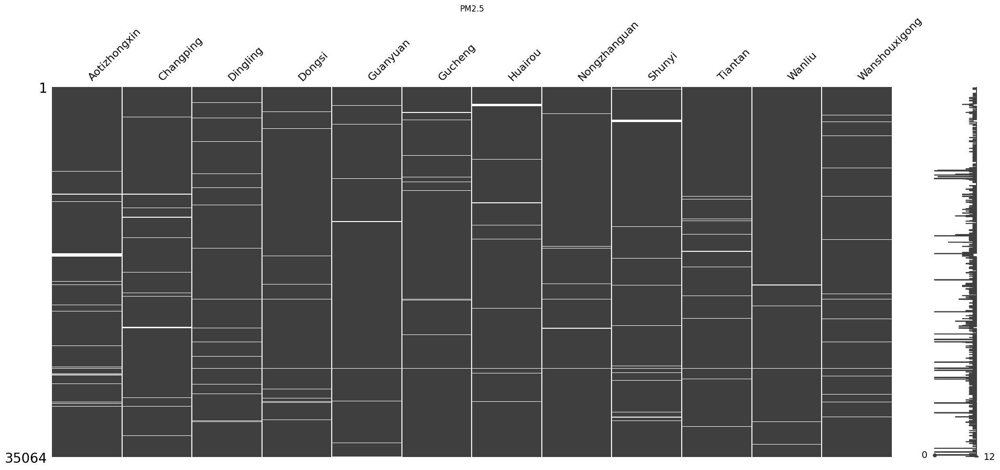

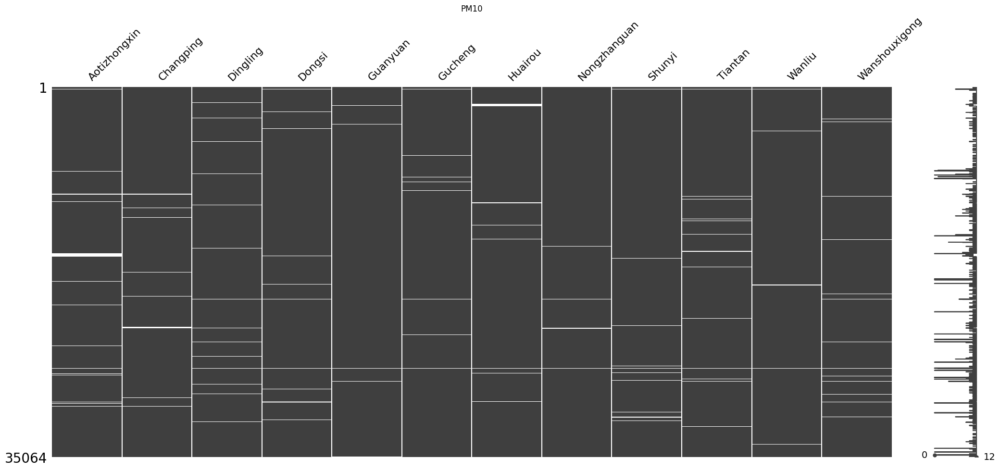

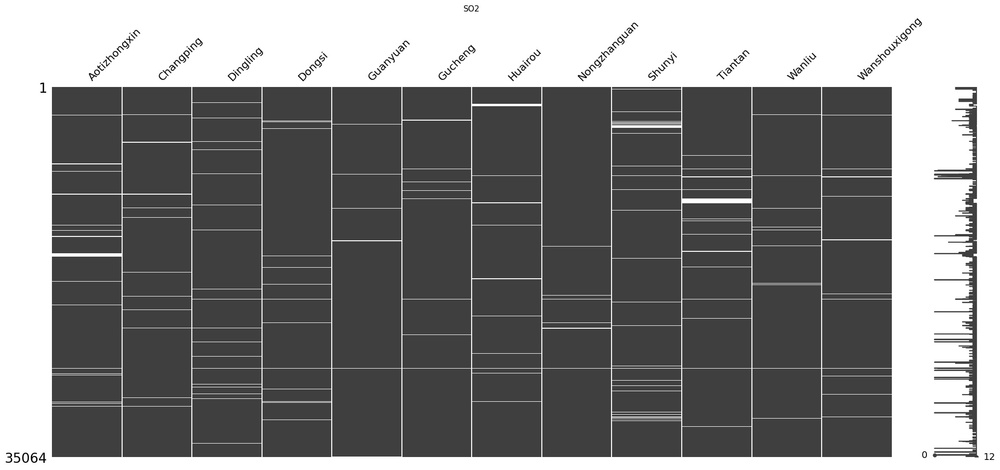

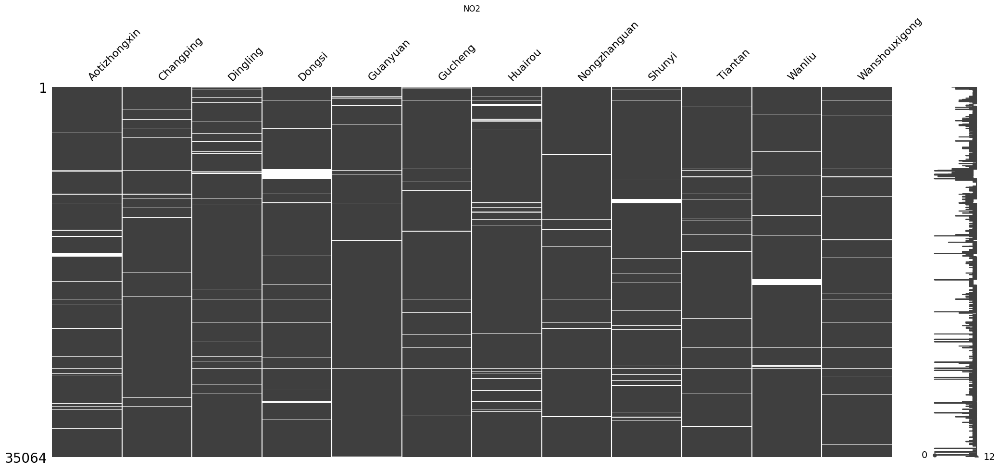

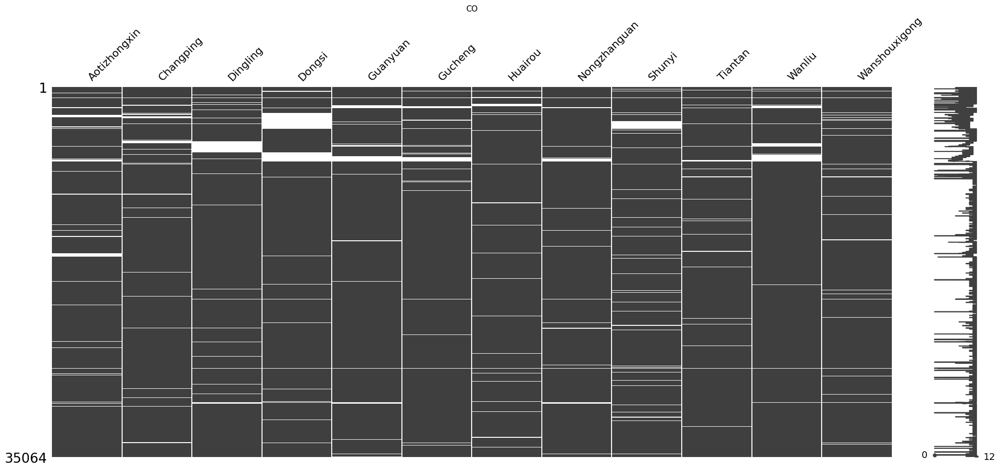

...

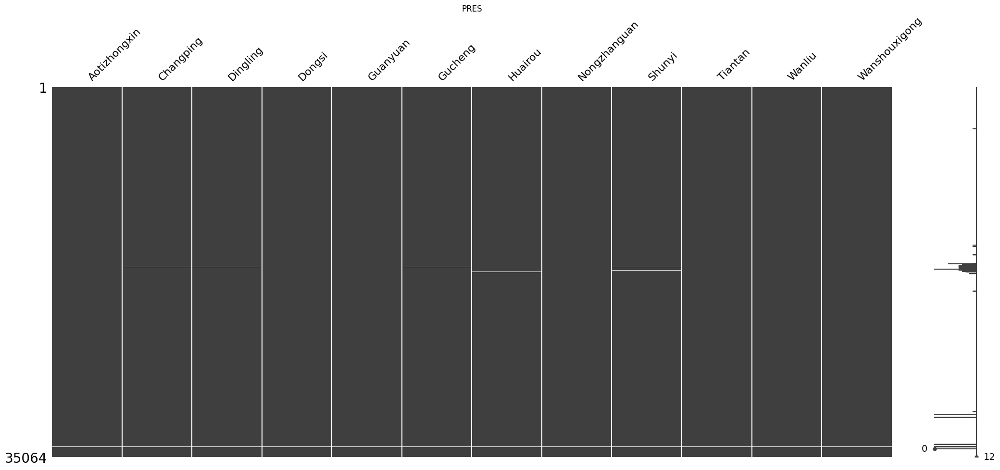

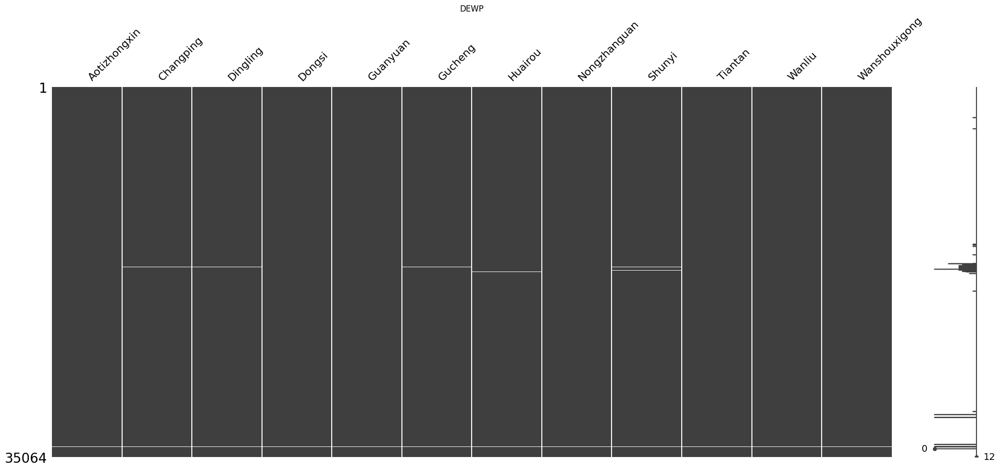

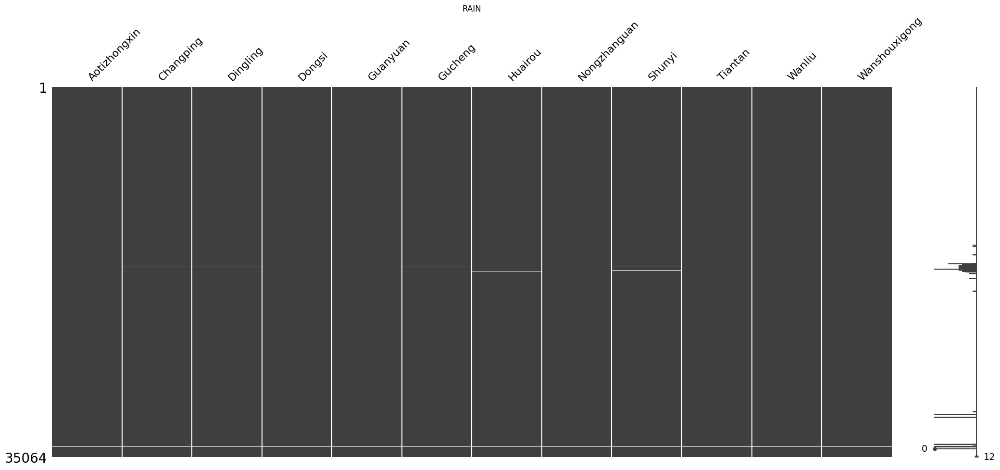

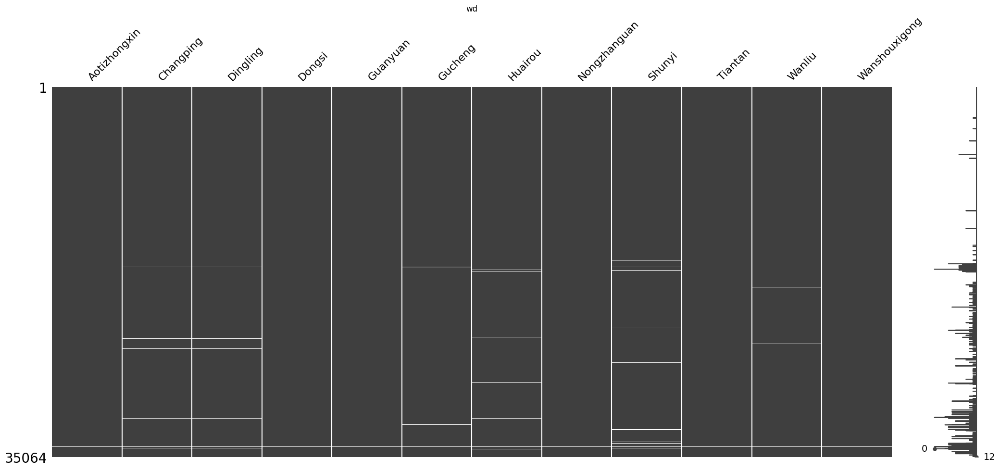

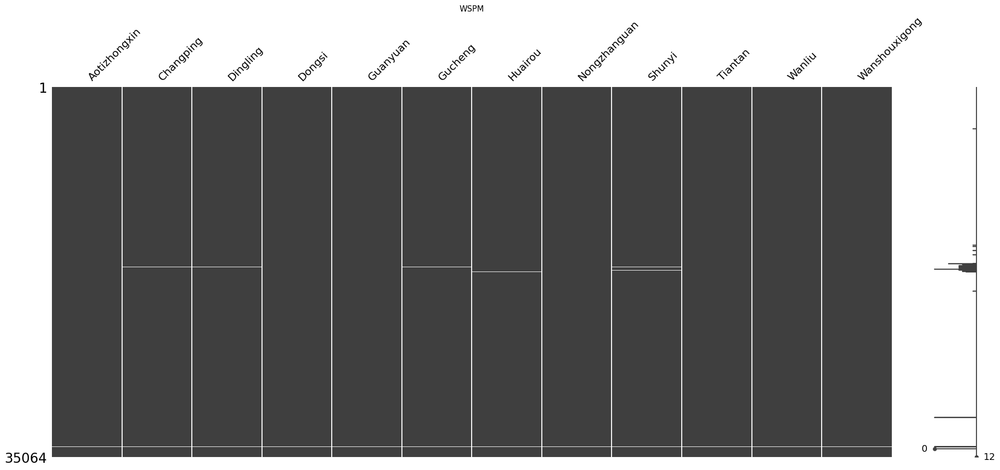

In [18]:
for i in feature:
  data = feature_data[i]
  msno.matrix(data)
  plt.title(i)
  plt.show()

When viewed from the gap's plot above, some parameters such as NO2, CO and O3 have missing values with large gaps that need to be imputed. Because some data from several stations at one time are missing, we impute them by averaging the values of all stations in a row.

In [19]:
# performed imputation by averaging all station data at the same time for each data parameter
for i in feature:
  if i in ['wd']:             # for wind direction ('wd') not imputed with this method because it is categorial data
    continue
  else:
    data = feature_data[i]
    avg_param = data.mean(axis=1)
    data = data.apply(lambda x: x.fillna(avg_param),axis=0)
  feature_data[i] = data

I imputed the missing values by entering the average value of all stations at the same time. The reason I did this was because I assumed that the station coverage was still within the same region or city.

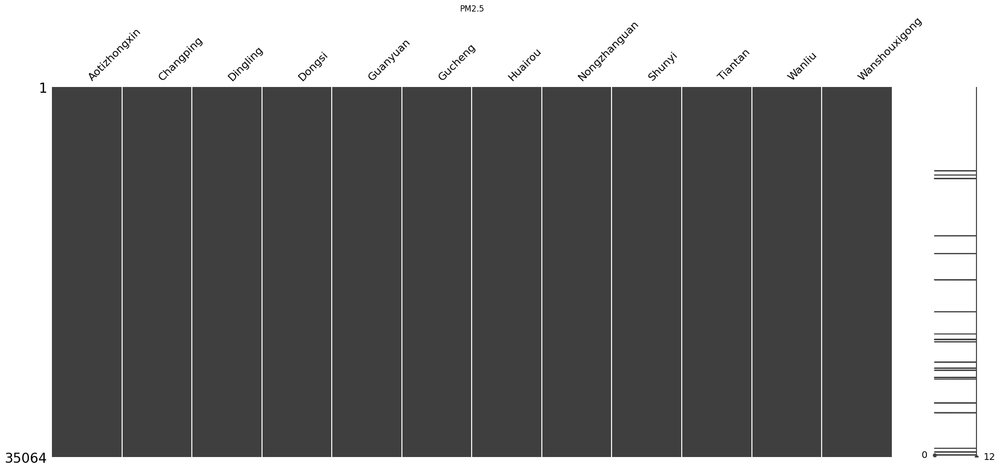

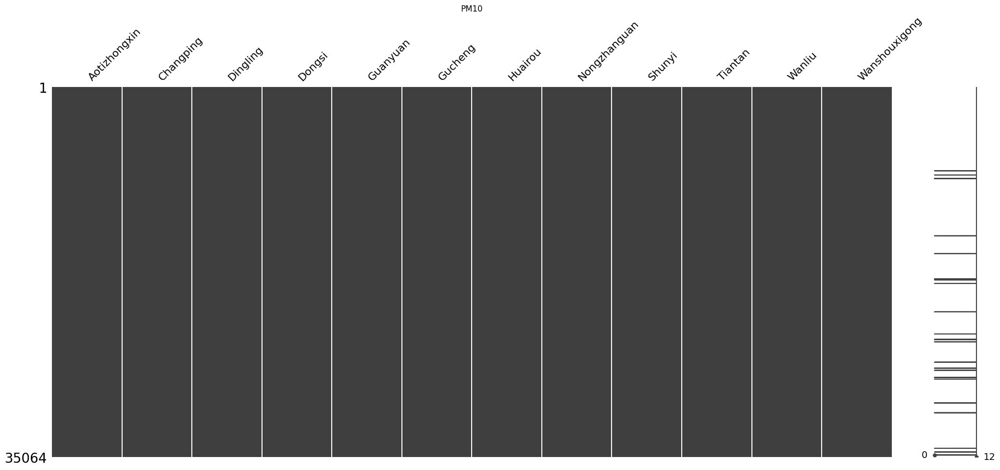

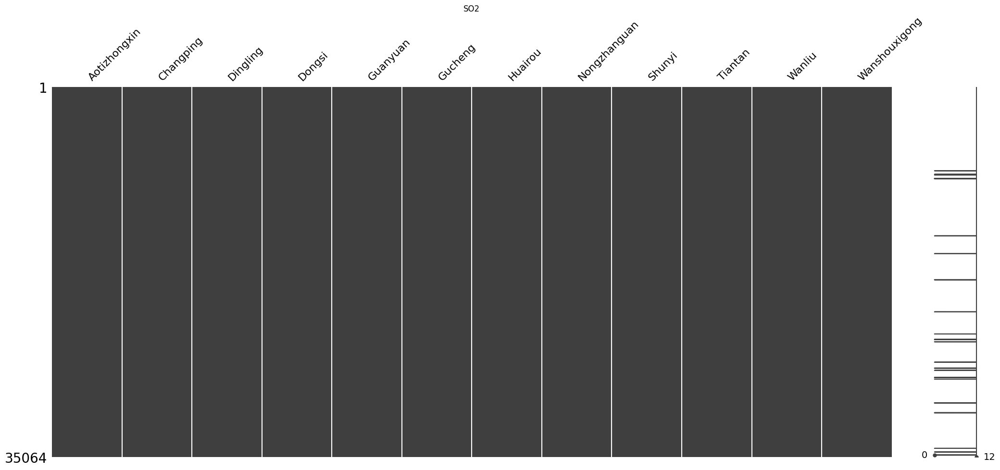

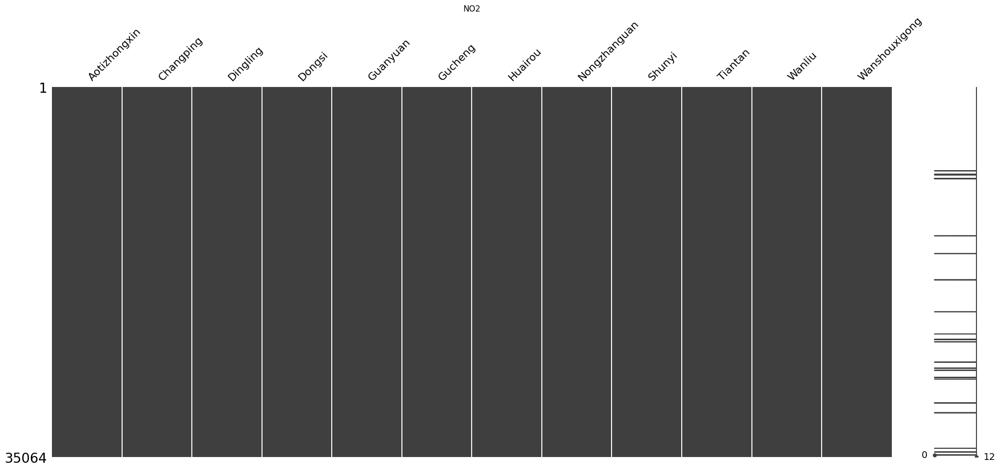

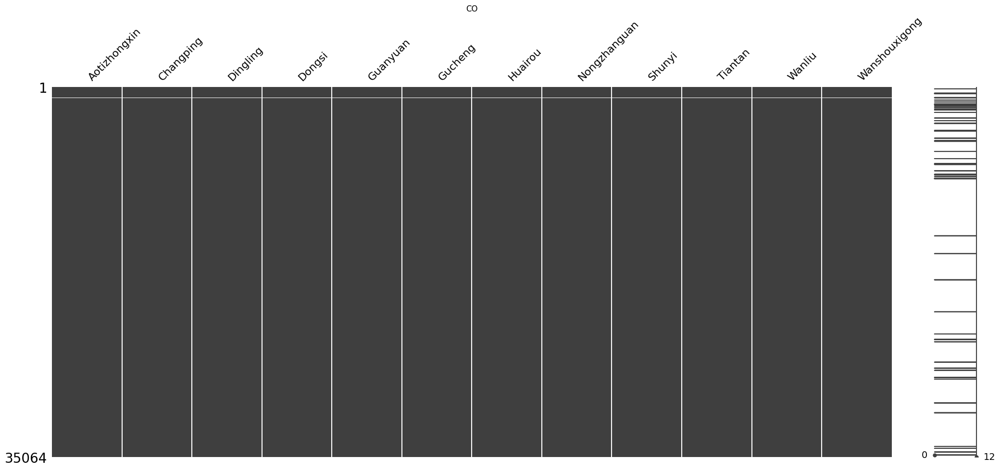

...

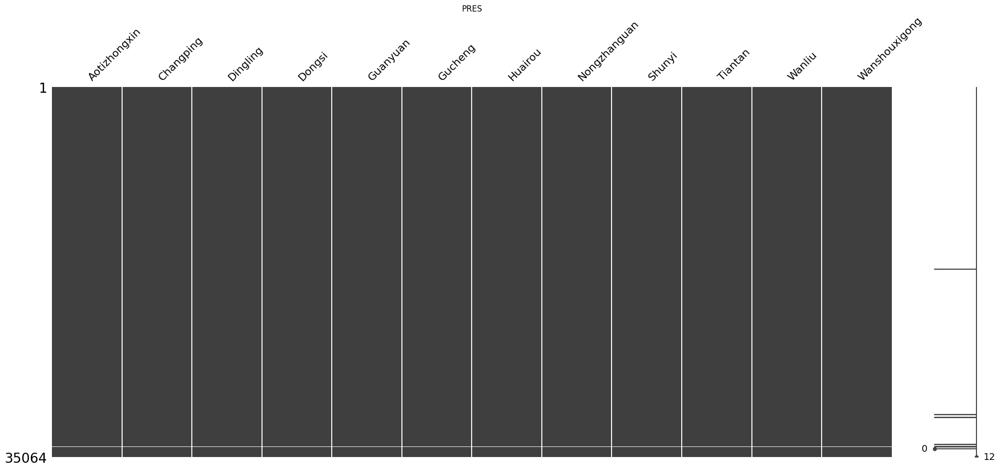

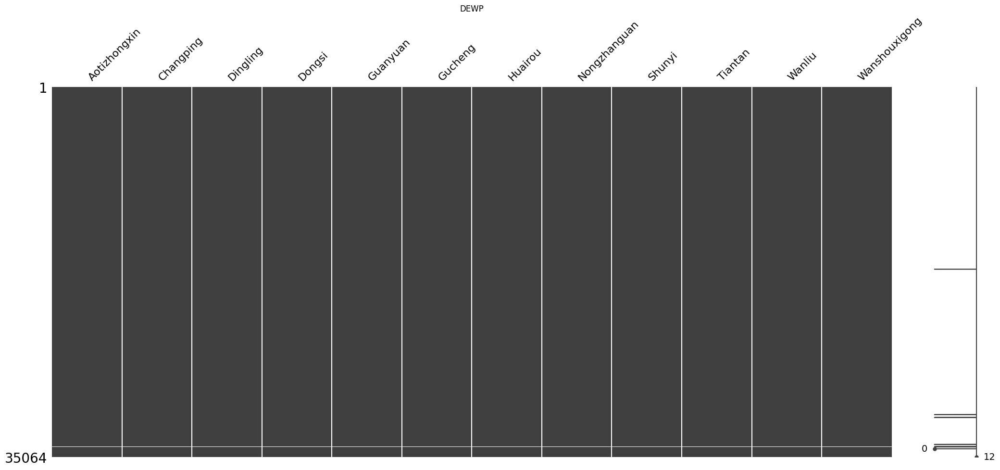

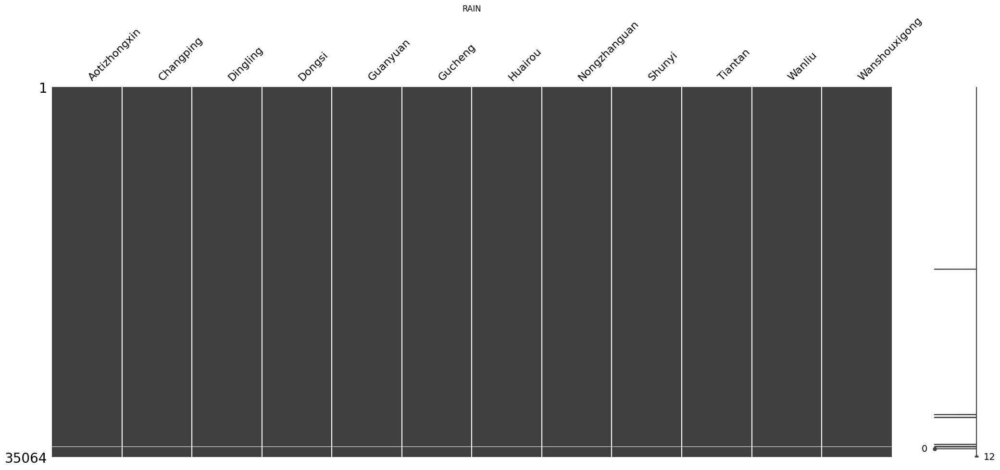

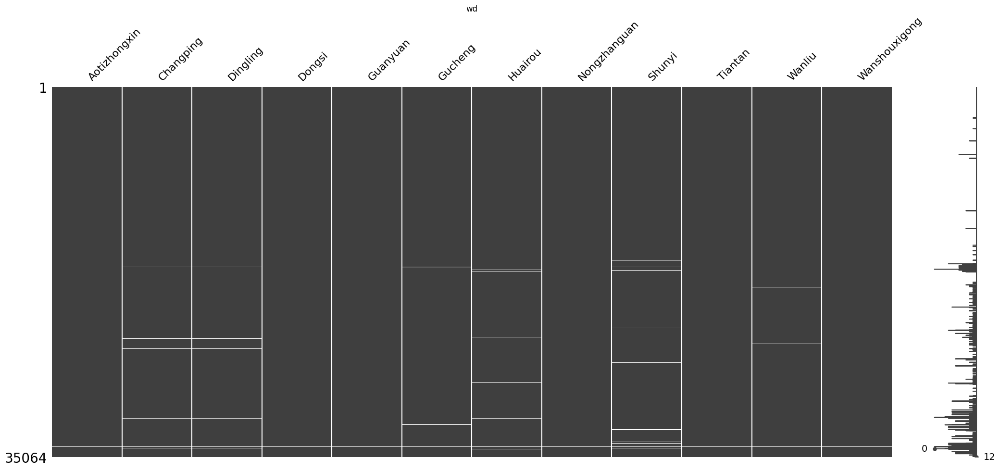

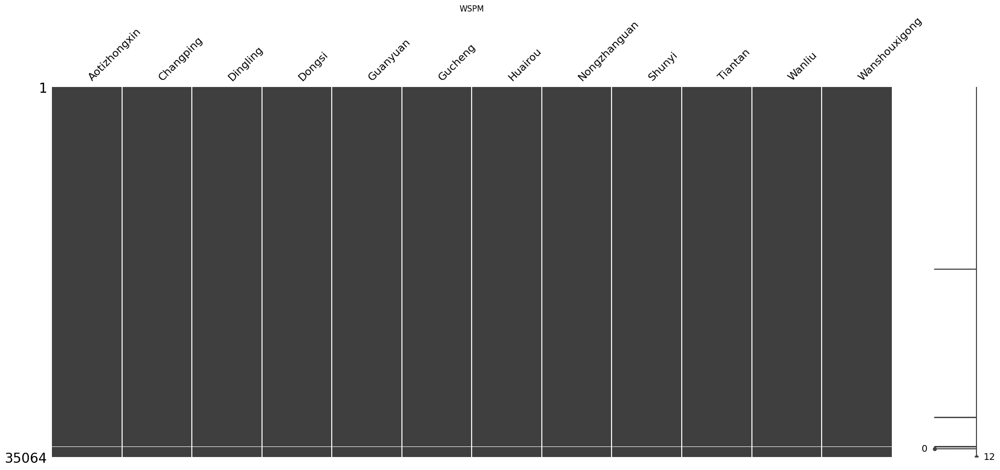

In [20]:
# viewed the remaining missing values
for i in feature:
  data = feature_data[i]
  msno.matrix(data)
  plt.title(i)
  plt.show()

In [21]:
# number of missing values remaining
na_count = pd.DataFrame()
for i in feature:
  na_count[i] = feature_data[i].isna().sum()

na_count

,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,wd,WSPM
station,,,,,,,,,,,,
Aotizhongxin,81,83,87,87,204,107,18,18,18,18,81,12
Changping,81,83,87,87,204,107,18,18,18,18,140,12
Dingling,81,83,87,87,204,107,18,18,18,18,140,12
Dongsi,81,83,87,87,204,107,18,18,18,18,78,12
Guanyuan,81,83,87,87,204,107,18,18,18,18,81,12
Gucheng,81,83,87,87,204,107,18,18,18,18,159,12
Huairou,81,83,87,87,204,107,18,18,18,18,302,12
Nongzhanguan,81,83,87,87,204,107,18,18,18,18,78,12
Shunyi,81,83,87,87,204,107,18,18,18,18,483,12


because there is still missing data because there is no value in one row of data, then further interpolation will be carried out per column. actually it can also be discarded because the data is not available at each station at one time.

In [22]:
# then we do interpolation per column
for i in feature:
  if i in ['wd']:             # for wind direction ('wd') not imputed with this method because it is categorial data
    continue
  else:
    data = feature_data[i]
    for j in data.columns:
      data_per_station = data[j]
      data_per_station = data_per_station.interpolate(method='nearest',limit_area='inside')     # interpolation method for this case using 'nearest neighborhood'
      data[j] = data_per_station
  feature_data[i] = data

In [23]:
#next for category data on the 'wd' or wind direction parameter
#below shows the number of each category at a time / per line
data = feature_data['wd']
data_cat = data.apply(pd.Series.value_counts, 1)
data_cat

,E,ENE,ESE,N,NE,NNE,NNW,NW,S,SE,SSE,SSW,SW,W,WNW,WSW
Time,,,,,,,,,,,,,,,,
2013-03-01 00:00:00,2.0,NaN,NaN,NaN,NaN,NaN,6.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN
2013-03-01 01:00:00,NaN,2.0,NaN,3.0,NaN,NaN,1.0,5.0,NaN,NaN,NaN,NaN,NaN,NaN,1.0,NaN
2013-03-01 02:00:00,NaN,2.0,NaN,NaN,NaN,NaN,6.0,2.0,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN
2013-03-01 03:00:00,NaN,NaN,NaN,3.0,NaN,2.0,1.0,5.0,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN
2013-03-01 04:00:00,NaN,NaN,NaN,5.0,NaN,NaN,4.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,2.0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-02-28 19:00:00,NaN,NaN,NaN,1.0,NaN,2.0,1.0,6.0,NaN,NaN,NaN,NaN,NaN,1.0,1.0,NaN
2017-02-28 20:00:00,NaN,NaN,NaN,2.0,NaN,NaN,NaN,2.0,NaN,NaN,NaN,1.0,NaN,NaN,6.0,1.0
2017-02-28 21:00:00,NaN,NaN,NaN,4.0,1.0,NaN,NaN,6.0,NaN,1.0,NaN,NaN,NaN,NaN,NaN,NaN


In [24]:
# Viewed the categories with the highest number at each time
data_wd = pd.DataFrame()
data_wd['Max_Cat'] = data_cat.idxmax(axis=1)
data_wd['Number'] = data_cat.max(axis=1)
data_wd

<ipython-input-24-387e8b16928e>:3: FutureWarning: The behavior of DataFrame.idxmax with all-NA values, or any-NA and skipna=False, is deprecated. In a future version this will raise ValueError
  data_wd['Max_Cat'] = data_cat.idxmax(axis=1)


,Max_Cat,Number
Time,,
2013-03-01 00:00:00,NNW,6.0
2013-03-01 01:00:00,NW,5.0
2013-03-01 02:00:00,NNW,6.0
2013-03-01 03:00:00,NW,5.0
2013-03-01 04:00:00,N,5.0
...,...,...
2017-02-28 19:00:00,NW,6.0
2017-02-28 20:00:00,WNW,6.0
2017-02-28 21:00:00,NW,6.0


In [25]:
# using the backward fill method to impute missing values
data = feature_data['wd']
filled_data_forward = data.fillna(method='ffill')
filled_data_forward.isna().sum()

feature_data['wd'] = filled_data_forward

<ipython-input-25-4ab26261a8ce>:3: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  filled_data_forward = data.fillna(method='ffill')


To fill in the missing data, I used the 'forward propagate' method because this method fills in the missing data by looking at the data after the observation time and connecting it to the data before the observation.

In [26]:
# viewed missing value remaining
na_count = pd.DataFrame()
for i in feature:
  na_count[i] = feature_data[i].isna().sum()

na_count

,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,wd,WSPM
station,,,,,,,,,,,,
Aotizhongxin,0,0,0,0,0,0,0,0,0,0,0,0
Changping,0,0,0,0,0,0,0,0,0,0,0,0
Dingling,0,0,0,0,0,0,0,0,0,0,0,0
Dongsi,0,0,0,0,0,0,0,0,0,0,0,0
Guanyuan,0,0,0,0,0,0,0,0,0,0,0,0
Gucheng,0,0,0,0,0,0,0,0,0,0,0,0
Huairou,0,0,0,0,0,0,0,0,0,0,0,0
Nongzhanguan,0,0,0,0,0,0,0,0,0,0,0,0
Shunyi,0,0,0,0,0,0,0,0,0,0,0,0


In [27]:
# Descriptive statistical information after interpolation
for i in feature:
  print('Feature',i)
  display(feature_data[i].describe().T)
  print('\n')

Feature PM2.5


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,82.541145,82.061349,3.0,22.000000,58.0,114.0,898.0
Changping,35064.0,71.642743,72.986962,2.0,18.000000,47.0,100.0,882.0
Dingling,35064.0,66.385327,72.808991,3.0,14.000000,41.0,94.0,881.0
Dongsi,35064.0,86.125565,86.349455,3.0,23.000000,61.0,119.0,737.0
Guanyuan,35064.0,82.882953,81.325575,2.0,23.000000,59.0,114.0,680.0
Gucheng,35064.0,84.082999,82.869402,2.0,24.000000,60.0,116.0,770.0
Huairou,35064.0,69.708566,71.347278,2.0,17.000000,47.0,98.0,762.0
Nongzhanguan,35064.0,84.799251,86.388010,2.0,22.000000,59.0,116.0,844.0
Shunyi,35064.0,79.340986,81.206508,2.0,19.829545,55.0,111.0,941.0




Feature PM10


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,110.072420,95.503148,2.0,38.0,86.00,155.0,984.0
Changping,35064.0,95.181981,84.338068,2.0,34.0,73.00,131.0,999.0
Dingling,35064.0,84.298837,80.619487,2.0,26.0,60.95,118.0,941.0
Dongsi,35064.0,110.323420,98.525177,2.0,38.0,86.00,151.0,955.0
Guanyuan,35064.0,109.074250,92.137645,2.0,40.0,89.00,149.0,999.0
Gucheng,35064.0,119.079557,97.240149,2.0,45.0,100.00,167.0,994.0
Huairou,35064.0,92.066254,84.245563,2.0,29.0,69.00,131.0,993.0
Nongzhanguan,35064.0,109.187930,95.865895,2.0,38.0,85.00,149.0,995.0
Shunyi,35064.0,99.052631,90.026405,2.0,31.0,77.00,139.0,999.0




Feature SO2


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,17.533542,22.899662,0.2856,3.000,9.0,22.0,341.0
Changping,35064.0,14.939980,21.009191,0.2856,2.000,6.7,18.0,310.0
Dingling,35064.0,11.890969,15.828529,0.2856,2.000,5.0,15.0,156.0
Dongsi,35064.0,18.471867,22.950772,0.2856,3.775,10.0,24.0,300.0
Guanyuan,35064.0,17.604162,23.625682,1.0000,3.000,8.0,22.0,293.0
Gucheng,35064.0,15.425249,21.304703,0.2856,2.000,7.0,20.0,500.0
Huairou,35064.0,12.288561,19.088468,0.2856,2.000,4.0,14.0,315.0
Nongzhanguan,35064.0,18.713073,24.325818,0.5712,3.000,9.0,23.0,257.0
Shunyi,35064.0,13.507776,19.489691,0.2856,2.000,5.0,16.0,239.0




Feature NO2


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,59.209466,37.028679,2.0000,30.000000,53.655286,82.000000,290.0
Changping,35064.0,44.242449,29.490949,1.8477,22.000000,36.000000,61.000000,226.0
Dingling,35064.0,28.020645,26.607509,1.0265,9.000000,19.000000,38.391100,205.0
Dongsi,35064.0,53.829524,33.962424,2.0000,27.454545,47.000000,73.804545,258.0
Guanyuan,35064.0,57.856571,35.118923,2.0000,30.763636,51.000000,78.000000,270.0
Gucheng,35064.0,55.846198,36.469742,2.0000,26.000000,50.000000,79.000000,276.0
Huairou,35064.0,33.001926,26.497520,1.0265,13.000000,26.000000,47.000000,231.0
Nongzhanguan,35064.0,57.996356,36.287424,2.0000,29.000000,51.000000,80.000000,273.0
Shunyi,35064.0,44.142198,30.879117,2.0000,20.000000,37.000000,62.000000,258.0




Feature CO


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,1270.745636,1232.929125,100.0,500.0,900.0,1600.0,10000.0
Changping,35064.0,1160.848480,1110.269492,100.0,500.0,800.0,1400.0,10000.0
Dingling,35064.0,924.832607,910.370904,100.0,300.0,600.0,1200.0,10000.0
Dongsi,35064.0,1321.133677,1177.716453,100.0,600.0,1000.0,1625.0,10000.0
Guanyuan,35064.0,1268.745869,1158.858183,100.0,500.0,900.0,1600.0,10000.0
Gucheng,35064.0,1324.416906,1209.371562,100.0,600.0,900.0,1600.0,10000.0
Huairou,35064.0,1024.948210,899.736992,100.0,400.0,800.0,1300.0,10000.0
Nongzhanguan,35064.0,1325.218644,1248.793912,100.0,500.0,900.0,1600.0,10000.0
Shunyi,35064.0,1182.459758,1150.068265,100.0,400.0,800.0,1500.0,10000.0




Feature O3


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,55.285986,57.291298,0.2142,8.00000,41.0000,81.00000,423.0000
Changping,35064.0,57.929483,54.331623,0.2142,15.79725,46.0000,80.00000,429.0000
Dingling,35064.0,68.543733,54.134950,0.2142,30.00000,61.0000,90.00000,500.0000
Dongsi,35064.0,57.530881,58.238896,0.6426,12.20940,45.0000,82.00000,1071.0000
Guanyuan,35064.0,54.917218,57.139188,0.2142,7.00000,40.0000,80.00000,415.0000
Gucheng,35064.0,57.504131,56.874472,0.2142,10.00000,44.0000,83.00000,450.0000
Huairou,35064.0,59.961296,54.754408,0.2142,18.00000,49.0000,83.00000,444.0000
Nongzhanguan,35064.0,58.437158,58.383783,0.2142,10.00000,44.1252,83.00000,390.0000
Shunyi,35064.0,55.101635,54.807388,0.2142,10.00000,43.0000,77.00000,351.7164




Feature TEMP


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,13.581533,11.400336,-16.8,3.100,14.5,23.3,40.5
Changping,35064.0,13.671285,11.367833,-16.6,3.400,14.6,23.3,41.4
Dingling,35064.0,13.671285,11.367833,-16.6,3.400,14.6,23.3,41.4
Dongsi,35064.0,13.668394,11.459607,-16.8,3.100,14.6,23.5,41.1
Guanyuan,35064.0,13.581533,11.400336,-16.8,3.100,14.5,23.3,40.5
Gucheng,35064.0,13.855240,11.295162,-15.6,3.600,14.8,23.5,41.6
Huairou,35064.0,12.432030,11.752666,-19.9,2.100,13.5,22.3,40.3
Nongzhanguan,35064.0,13.668394,11.459607,-16.8,3.100,14.6,23.5,41.1
Shunyi,35064.0,13.375816,11.484675,-16.8,3.000,14.4,23.2,40.6




Feature PRES


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,1011.851167,10.403989,985.9,1003.3,1011.4,1020.1,1042.0
Changping,35064.0,1007.775309,10.230366,982.4,999.3,1007.4,1016.0,1036.5
Dingling,35064.0,1007.775309,10.230366,982.4,999.3,1007.4,1016.0,1036.5
Dongsi,35064.0,1012.551352,10.265895,987.1,1004.0,1012.2,1020.9,1042.0
Guanyuan,35064.0,1011.851167,10.403989,985.9,1003.3,1011.4,1020.1,1042.0
Gucheng,35064.0,1008.838340,10.105866,984.0,1000.5,1008.6,1017.0,1038.1
Huairou,35064.0,1007.615818,10.029138,982.8,999.4,1007.3,1015.5,1036.5
Nongzhanguan,35064.0,1012.551352,10.265895,987.1,1004.0,1012.2,1020.9,1042.0
Shunyi,35064.0,1013.070349,10.176595,988.0,1004.7,1012.8,1021.0,1042.8




Feature DEWP


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,3.120300,13.690279,-35.3,-8.100,3.8,15.6,28.5
Changping,35064.0,1.488283,13.827338,-35.1,-10.300,1.7,14.2,27.2
Dingling,35064.0,1.488283,13.827338,-35.1,-10.300,1.7,14.2,27.2
Dongsi,35064.0,2.445155,13.811875,-35.3,-8.800,3.0,15.0,28.8
Guanyuan,35064.0,3.120300,13.690279,-35.3,-8.100,3.8,15.6,28.5
Gucheng,35064.0,2.599998,13.790639,-34.6,-9.000,3.0,15.3,27.4
Huairou,35064.0,2.219511,14.058933,-43.4,-9.700,2.7,15.3,29.1
Nongzhanguan,35064.0,2.445155,13.811875,-35.3,-8.800,3.0,15.0,28.8
Shunyi,35064.0,2.451195,13.731833,-36.0,-8.825,3.1,15.1,27.5




Feature RAIN


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,0.067383,0.909798,0.0,0.0,0.0,0.0,72.5
Changping,35064.0,0.060291,0.752358,0.0,0.0,0.0,0.0,52.1
Dingling,35064.0,0.060291,0.752358,0.0,0.0,0.0,0.0,52.1
Dongsi,35064.0,0.063983,0.786059,0.0,0.0,0.0,0.0,46.4
Guanyuan,35064.0,0.067383,0.909798,0.0,0.0,0.0,0.0,72.5
Gucheng,35064.0,0.064374,0.838142,0.0,0.0,0.0,0.0,41.9
Huairou,35064.0,0.067833,0.848384,0.0,0.0,0.0,0.0,45.9
Nongzhanguan,35064.0,0.063983,0.786059,0.0,0.0,0.0,0.0,46.4
Shunyi,35064.0,0.061006,0.761118,0.0,0.0,0.0,0.0,37.3




Feature wd


,count,unique,top,freq
station,,,,
Aotizhongxin,35064,16,NE,5161
Changping,35064,16,NNW,4790
Dingling,35064,16,NNW,4790
Dongsi,35064,16,ENE,3867
Guanyuan,35064,16,NE,5161
Gucheng,35064,16,N,3957
Huairou,35064,16,NW,5049
Nongzhanguan,35064,16,ENE,3867
Shunyi,35064,16,NNE,4600




Feature WSPM


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,1.708519,1.204098,0.0,0.9,1.4,2.2,11.2
Changping,35064.0,1.854516,1.310867,0.0,1.0,1.5,2.3,10.0
Dingling,35064.0,1.854516,1.310867,0.0,1.0,1.5,2.3,10.0
Dongsi,35064.0,1.860757,1.280358,0.0,1.0,1.5,2.4,10.5
Guanyuan,35064.0,1.708519,1.204098,0.0,0.9,1.4,2.2,11.2
Gucheng,35064.0,1.344541,1.152033,0.0,0.6,1.0,1.8,12.0
Huairou,35064.0,1.652789,1.199684,0.0,0.9,1.3,2.0,12.9
Nongzhanguan,35064.0,1.860757,1.280358,0.0,1.0,1.5,2.4,10.5
Shunyi,35064.0,1.808145,1.288006,0.0,1.0,1.5,2.3,12.8


**Insight:**
- We choose to interpolate rather than delete missing values because later in the EDA section we will perform Pearson correlation to see if the data pattern each year has the same pattern or not. and also cross-correlation to see the time lag relationship of each station with other stations.
- Another reason is to simplify the prediction analysis, because the data is time-dependent so each timeline should not have missing data.
- Especially for the wind direction change analysis, some stations have the same trend, indicating that the two stations are close together or in the same area.

### Cleaning Data

In [28]:
# @title Hampel Filter
# this code i get from Eryk Lewinson in github
# https://github.com/erykml/medium_articles/blob/2e0d2ac7511f345852d4a713e166db36477aac8c/Machine%20Learning/outlier_detection_hampel_filter.ipynb
def hampel_filter_pandas(input_series, window_size, n_sigmas=3):
    '''
    Function for outlier detection using the Hampel filter.

    Parameters
    ------------
    input_series : pd.Series
        The series on which outlier detection will be performed
    window_size : int
        The size of the window (one-side). Total window size is 2*window_size
    n_sigmas : int
        The number of standard deviations used for identifying outliers

    Returns
    -----------
    new_series : pd.Series
        The array in which outliers were replaced with respective window medians
    indices : np.ndarray
        The array containing the indices of detected outliers
    '''

    k = 1.4826 # scale factor for Gaussian distribution
    new_series = input_series.copy()

    # helper lambda function
    MAD = lambda x: np.median(np.abs(x - np.median(x)))

    rolling_median = input_series.rolling(window=2*window_size, center=True).median()
    rolling_mad = k * input_series.rolling(window=2*window_size, center=True).apply(MAD)
    diff = np.abs(input_series - rolling_median)

    indices = list(np.argwhere(diff > (n_sigmas * rolling_mad)).flatten())
    new_series[indices] = rolling_median[indices]

    return new_series, indices

In [29]:
# @title IQR Filter
def iqr_outlier_mask(dataframe,resample='D',methods='mean'):
    """
    Apply Hampel Filter to detect and replace outliers.

    Parameters:
        dataframe (pd.DataFrame): Time series dataframe.
        resample ('h','D','W','M','Y'): Convenience method for frequency conversion and resampling of time series.
        methods ('mean','mediaan','sum'): Agrerat method when data is resampled.

    Returns:
        pd.DataFrame: Data after outliers are replaced.
    """

    # Create a copy of the original data
    data = dataframe.copy()

    # Select the method used
    if methods == 'mean':
      data = data.resample(resample).mean()
    elif methods == 'median':
      data = data.resample(resample).median()
    elif methods == 'sum':
      data = data.resample(resample).sum()
    else:
      raise ValueError("Invalid method. Choose 'mean', 'median', or 'sum'.")

    # IQR Calculate
    q1 = data.quantile(0.25)
    q3 = data.quantile(0.75)
    iqr = q3-q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    cond_lower = data < lower_bound
    cond_upper = data > upper_bound

    # masking data
    data.mask(cond_lower,lower_bound,inplace=True)  # Apply the mask
    data.mask(cond_upper,upper_bound,inplace=True)  # Apply the mask

    return data

<ipython-input-28-4041ddcd9d4b>:36: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  new_series[indices] = rolling_median[indices]
<ipython-input-28-4041ddcd9d4b>:36: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  new_series[indices] = rolling_median[indices]
<ipython-input-28-4041ddcd9d4b>:36: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  new_series[indices] = rolling_median[indices]
<ipython-input-28-4041ddcd9d4b>:36: FutureWarni

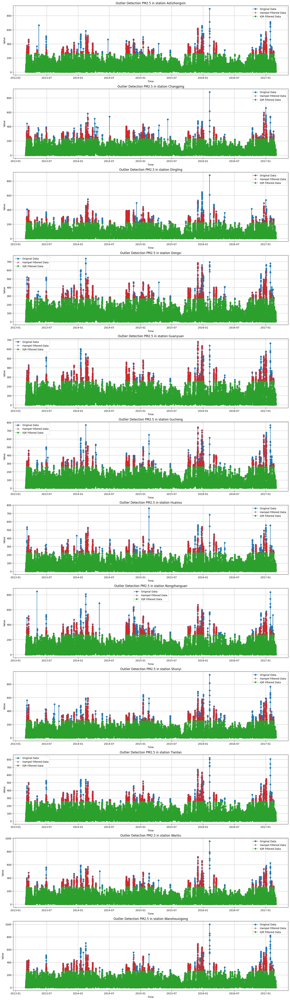

In [30]:
# The differences between Hampel Filter and IQR filter result
fig, ax = plt.subplots(len(station),1,figsize=(20, 6*len(station)))

for i, station_name in enumerate(station):
  v = 'PM2.5'
  if v == 'wd':
    pass
  else:
    # Example of data with outliers using Aotizhongxin station dataset
    time_series = feature_data[v][station_name]

    # Apply Hampel Filter
    filtered_series, indices = hampel_filter_pandas(time_series, window_size=48, n_sigmas=2)

    # Apply IQR Filter
    iqr_series = iqr_outlier_mask(time_series,resample='h')


  # Plot of original data and data after filter
  ax[i].plot(time_series, label="Original Data", marker="o", linestyle="-", color='tab:blue')
  ax[i].plot(filtered_series, label="Hampel Filtered Data", marker="o", linestyle="--", color="tab:red", alpha=0.5)
  ax[i].plot(iqr_series, label="IQR Filtered Data", marker="o", linestyle="--", color="tab:green")
  ax[i].set_title(f"Outlier Detection {v} in station {station_name}")
  ax[i].set_xlabel("Time")
  ax[i].set_ylabel("Value")
  ax[i].legend()
  ax[i].grid()

plt.show()

The above lineplot showing the line chart of all features at Aotizhongxin station shows that the filter overlay is better for removing outliers without removing the trend in the data. But not all features are good for using an overlay filter to remove outliers such as the RAIN feature because it can eliminate trends in the data. Based on the analysis of the lineplot and boxplot above, we will remove outliers with the hampel filter method for features that correspond to air quality parameters (PM2.5, PM10, SO2, NO2, CO and O3) and other features we will not remove outliers because if we look at the boxplot for the TEMP, PRES, and DEWP features there are no outliers in the data. Then for the RAIN and WSPM features, when viewed from the lineplot, the range of values in the data is still considered within reasonable limits.

In [31]:
# create dfs_filter dictionary for filtered data
feature_data_filter = {}
for v in feature:
  df_feature = feature_data[v].copy()

  if v in ['PM2.5','PM10','NO2','SO2','CO','O3']:
    for station_name in df_feature.columns:
      data = df_feature[station_name]
      filtered_data, indices = hampel_filter_pandas(data, window_size=48, n_sigmas=2)
      df_feature[station_name] = filtered_data

    feature_data_filter[v] = df_feature

  else:
    feature_data_filter[v] = df_feature

  print(f"dataframe pada feature {v} sudah selesai")

<ipython-input-28-4041ddcd9d4b>:36: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  new_series[indices] = rolling_median[indices]
<ipython-input-28-4041ddcd9d4b>:36: FutureWarning: Series.__setitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To set a value by position, use `ser.iloc[pos] = value`
  new_series[indices] = rolling_median[indices]


dataframe pada feature PM2.5 sudah selesai
dataframe pada feature PM10 sudah selesai
dataframe pada feature SO2 sudah selesai
dataframe pada feature NO2 sudah selesai
dataframe pada feature CO sudah selesai
dataframe pada feature O3 sudah selesai
dataframe pada feature TEMP sudah selesai
dataframe pada feature PRES sudah selesai
dataframe pada feature DEWP sudah selesai
dataframe pada feature RAIN sudah selesai
dataframe pada feature wd sudah selesai
dataframe pada feature WSPM sudah selesai


Now, All data has being clear from outlier

In [32]:
# view the difference in descriptive statistics of pre-filtered and post-filtered data
for i in feature_data_filter.keys():
  print('Parameter',i)
  display(feature_data_filter[i].describe().T)
  print('\n')

Parameter PM2.5


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,75.793833,75.992227,3.0,20.0,52.0,103.000000,619.0
Changping,35064.0,65.176236,67.758028,2.0,17.0,41.0,89.000000,596.0
Dingling,35064.0,59.412239,66.724419,3.0,13.0,34.5,81.000000,548.0
Dongsi,35064.0,78.857602,79.887921,3.0,21.0,55.0,107.931818,685.0
Guanyuan,35064.0,76.780407,76.700577,2.0,22.0,53.0,104.000000,680.0
Gucheng,35064.0,77.544485,76.586292,2.0,22.0,54.0,106.000000,741.0
Huairou,35064.0,63.415802,65.796530,2.0,17.0,41.0,86.000000,538.0
Nongzhanguan,35064.0,77.523469,79.364545,2.0,20.0,53.0,104.000000,667.0
Shunyi,35064.0,71.466577,73.604260,2.0,18.0,48.0,99.000000,631.0




Parameter PM10


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,102.422244,84.917464,2.0,36.0,81.0,145.0,671.0
Changping,35064.0,87.985475,73.605200,2.0,33.0,68.0,122.0,596.0
Dingling,35064.0,76.994998,70.280107,2.0,25.0,55.0,108.0,556.0
Dongsi,35064.0,102.700956,87.983940,2.0,36.0,81.0,142.0,710.0
Guanyuan,35064.0,102.554391,83.277116,2.0,38.0,84.0,141.0,680.0
Gucheng,35064.0,111.384269,86.630548,2.0,43.0,94.0,158.0,741.0
Huairou,35064.0,83.798720,73.091746,2.0,28.0,64.0,120.0,577.0
Nongzhanguan,35064.0,101.542361,86.003105,2.0,36.5,80.0,139.0,697.0
Shunyi,35064.0,91.043952,79.083200,2.0,29.0,71.0,129.0,625.0




Parameter SO2


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,15.273297,20.242686,0.2856,3.0,8.0,18.0,197.000000
Changping,35064.0,12.564373,18.768826,0.2856,2.0,5.0,14.0,186.000000
Dingling,35064.0,9.546774,13.037503,0.2856,2.0,4.0,11.5,152.545455
Dongsi,35064.0,16.037486,20.290128,0.2856,3.0,8.0,21.0,181.000000
Guanyuan,35064.0,15.101381,20.555554,1.0000,2.0,7.0,18.0,221.000000
Gucheng,35064.0,13.442943,18.302258,1.0000,2.0,5.0,17.0,165.000000
Huairou,35064.0,9.149937,14.575616,0.2856,2.0,3.0,9.0,185.000000
Nongzhanguan,35064.0,16.034573,21.479975,0.5712,3.0,8.0,20.0,187.000000
Shunyi,35064.0,10.505989,16.130126,0.2856,2.0,3.0,11.5,203.000000




Parameter NO2


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,56.803635,34.957554,2.0000,29.108333,51.000000,78.0,263.0
Changping,35064.0,41.806176,27.659126,1.8477,21.000000,34.000000,56.0,226.0
Dingling,35064.0,25.461926,24.538534,1.0265,8.000000,17.500000,34.0,205.0
Dongsi,35064.0,51.274588,31.783779,2.0000,27.000000,45.000000,69.0,258.0
Guanyuan,35064.0,55.507283,33.148187,2.0000,30.000000,49.000000,74.0,233.0
Gucheng,35064.0,53.700781,34.387049,2.0000,26.000000,48.000000,76.0,239.0
Huairou,35064.0,30.644791,24.450818,1.0265,12.000000,24.000000,43.0,174.0
Nongzhanguan,35064.0,55.287805,34.035073,2.0000,29.000000,48.000000,75.0,265.0
Shunyi,35064.0,41.733834,28.739471,2.0000,19.627273,35.000000,58.0,188.0




Parameter CO


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,1165.902415,1144.793064,100.0,500.000000,800.0,1399.0,10000.0
Changping,35064.0,1049.397448,974.117354,100.0,500.000000,700.0,1300.0,10000.0
Dingling,35064.0,840.574876,813.377704,100.0,300.000000,600.0,1100.0,9400.0
Dongsi,35064.0,1219.099883,1086.317294,100.0,524.305556,900.0,1500.0,10000.0
Guanyuan,35064.0,1170.886823,1069.698982,100.0,500.000000,900.0,1400.0,10000.0
Gucheng,35064.0,1244.407836,1129.893290,100.0,500.000000,900.0,1500.0,10000.0
Huairou,35064.0,942.536710,786.636294,100.0,400.000000,700.0,1200.0,9300.0
Nongzhanguan,35064.0,1204.543558,1131.606834,100.0,500.000000,900.0,1400.0,10000.0
Shunyi,35064.0,1053.022597,1002.062876,100.0,400.000000,800.0,1300.0,10000.0




Parameter O3


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,49.756057,53.729347,0.2142,5.0000,34.0000,77.0,423.0
Changping,35064.0,52.788085,47.759455,0.2142,12.0000,45.0000,77.0,335.0
Dingling,35064.0,63.875060,46.736273,0.2142,29.0000,60.0000,87.0,351.0
Dongsi,35064.0,52.075996,50.192946,0.6426,9.5319,40.0000,78.0,301.0
Guanyuan,35064.0,49.400377,53.030791,0.2142,5.0000,34.0000,75.0,325.0
Gucheng,35064.0,51.771052,52.324291,0.2142,8.0000,38.0000,78.5,359.0
Huairou,35064.0,54.241002,47.834179,0.2142,15.0000,46.0000,79.0,339.0
Nongzhanguan,35064.0,53.191248,54.871052,0.2142,8.0000,39.0000,79.0,334.0
Shunyi,35064.0,49.263914,49.727416,0.2142,8.0000,37.0000,73.0,333.0




Parameter TEMP


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,13.581533,11.400336,-16.8,3.100,14.5,23.3,40.5
Changping,35064.0,13.671285,11.367833,-16.6,3.400,14.6,23.3,41.4
Dingling,35064.0,13.671285,11.367833,-16.6,3.400,14.6,23.3,41.4
Dongsi,35064.0,13.668394,11.459607,-16.8,3.100,14.6,23.5,41.1
Guanyuan,35064.0,13.581533,11.400336,-16.8,3.100,14.5,23.3,40.5
Gucheng,35064.0,13.855240,11.295162,-15.6,3.600,14.8,23.5,41.6
Huairou,35064.0,12.432030,11.752666,-19.9,2.100,13.5,22.3,40.3
Nongzhanguan,35064.0,13.668394,11.459607,-16.8,3.100,14.6,23.5,41.1
Shunyi,35064.0,13.375816,11.484675,-16.8,3.000,14.4,23.2,40.6




Parameter PRES


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,1011.851167,10.403989,985.9,1003.3,1011.4,1020.1,1042.0
Changping,35064.0,1007.775309,10.230366,982.4,999.3,1007.4,1016.0,1036.5
Dingling,35064.0,1007.775309,10.230366,982.4,999.3,1007.4,1016.0,1036.5
Dongsi,35064.0,1012.551352,10.265895,987.1,1004.0,1012.2,1020.9,1042.0
Guanyuan,35064.0,1011.851167,10.403989,985.9,1003.3,1011.4,1020.1,1042.0
Gucheng,35064.0,1008.838340,10.105866,984.0,1000.5,1008.6,1017.0,1038.1
Huairou,35064.0,1007.615818,10.029138,982.8,999.4,1007.3,1015.5,1036.5
Nongzhanguan,35064.0,1012.551352,10.265895,987.1,1004.0,1012.2,1020.9,1042.0
Shunyi,35064.0,1013.070349,10.176595,988.0,1004.7,1012.8,1021.0,1042.8




Parameter DEWP


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,3.120300,13.690279,-35.3,-8.100,3.8,15.6,28.5
Changping,35064.0,1.488283,13.827338,-35.1,-10.300,1.7,14.2,27.2
Dingling,35064.0,1.488283,13.827338,-35.1,-10.300,1.7,14.2,27.2
Dongsi,35064.0,2.445155,13.811875,-35.3,-8.800,3.0,15.0,28.8
Guanyuan,35064.0,3.120300,13.690279,-35.3,-8.100,3.8,15.6,28.5
Gucheng,35064.0,2.599998,13.790639,-34.6,-9.000,3.0,15.3,27.4
Huairou,35064.0,2.219511,14.058933,-43.4,-9.700,2.7,15.3,29.1
Nongzhanguan,35064.0,2.445155,13.811875,-35.3,-8.800,3.0,15.0,28.8
Shunyi,35064.0,2.451195,13.731833,-36.0,-8.825,3.1,15.1,27.5




Parameter RAIN


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,0.067383,0.909798,0.0,0.0,0.0,0.0,72.5
Changping,35064.0,0.060291,0.752358,0.0,0.0,0.0,0.0,52.1
Dingling,35064.0,0.060291,0.752358,0.0,0.0,0.0,0.0,52.1
Dongsi,35064.0,0.063983,0.786059,0.0,0.0,0.0,0.0,46.4
Guanyuan,35064.0,0.067383,0.909798,0.0,0.0,0.0,0.0,72.5
Gucheng,35064.0,0.064374,0.838142,0.0,0.0,0.0,0.0,41.9
Huairou,35064.0,0.067833,0.848384,0.0,0.0,0.0,0.0,45.9
Nongzhanguan,35064.0,0.063983,0.786059,0.0,0.0,0.0,0.0,46.4
Shunyi,35064.0,0.061006,0.761118,0.0,0.0,0.0,0.0,37.3




Parameter wd


,count,unique,top,freq
station,,,,
Aotizhongxin,35064,16,NE,5161
Changping,35064,16,NNW,4790
Dingling,35064,16,NNW,4790
Dongsi,35064,16,ENE,3867
Guanyuan,35064,16,NE,5161
Gucheng,35064,16,N,3957
Huairou,35064,16,NW,5049
Nongzhanguan,35064,16,ENE,3867
Shunyi,35064,16,NNE,4600




Parameter WSPM


,count,mean,std,min,25%,50%,75%,max
station,,,,,,,,
Aotizhongxin,35064.0,1.708519,1.204098,0.0,0.9,1.4,2.2,11.2
Changping,35064.0,1.854516,1.310867,0.0,1.0,1.5,2.3,10.0
Dingling,35064.0,1.854516,1.310867,0.0,1.0,1.5,2.3,10.0
Dongsi,35064.0,1.860757,1.280358,0.0,1.0,1.5,2.4,10.5
Guanyuan,35064.0,1.708519,1.204098,0.0,0.9,1.4,2.2,11.2
Gucheng,35064.0,1.344541,1.152033,0.0,0.6,1.0,1.8,12.0
Huairou,35064.0,1.652789,1.199684,0.0,0.9,1.3,2.0,12.9
Nongzhanguan,35064.0,1.860757,1.280358,0.0,1.0,1.5,2.4,10.5
Shunyi,35064.0,1.808145,1.288006,0.0,1.0,1.5,2.3,12.8


selanjutnya mengekspor data yang sudah di filter ini ke bentuk excel yang nanti akan digunakan untuk pembuatan Dashboard menggunakan streamlit

In [33]:
# fungsi mengkonversi dataframe per feature menjadi dataframe per station
def create_station_dataframes(feature_data):
  """
  Transforms the feature data into a dictionary of dataframes, where each key represents a station
  and each dataframe contains all features with 'Time' as the index.

  Args:
    feature_data: A dictionary where keys are features (e.g., 'PM2.5', 'PM10')
                  and values are pandas DataFrames with stations as columns.

  Returns:
    A dictionary where keys are station names and values are pandas DataFrames.
  """

  station_data = {}
  # Get station names from any feature DataFrame (assuming all have the same stations).
  if feature_data:
    stations = feature_data[list(feature_data.keys())[0]].columns
    for station in stations:
      station_df = pd.DataFrame(index=feature_data['PM2.5'].index) # use PM2.5 index as the time index
      for feature, df in feature_data.items():
          station_df[feature] = df[station]
      station_data[station] = station_df

  return station_data

In [34]:
# Example usage (assuming feature_data is defined as in your original code):
station_data = create_station_dataframes(feature_data_filter)

# Access data for a specific station:
aotizhongxin_data = station_data['Aotizhongxin']
aotizhongxin_data.head(5)

,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,wd,WSPM
Time,,,,,,,,,,,,
2013-03-01 00:00:00,4.0,4.0,4.0,7.0,300.0,77.0,-0.7,1023.0,-18.8,0.0,NNW,4.4
2013-03-01 01:00:00,8.0,8.0,4.0,7.0,300.0,77.0,-1.1,1023.2,-18.2,0.0,N,4.7
2013-03-01 02:00:00,7.0,7.0,5.0,10.0,300.0,73.0,-1.1,1023.5,-18.2,0.0,NNW,5.6
2013-03-01 03:00:00,6.0,6.0,11.0,11.0,300.0,72.0,-1.4,1024.5,-19.4,0.0,NW,3.1
2013-03-01 04:00:00,3.0,3.0,12.0,12.0,300.0,72.0,-2.0,1025.2,-19.5,0.0,N,2.0


In [35]:
# Export station_data to Excel or CSV

def export_station_data(station_data, export_format='excel'):
    """Exports the station_data dictionary to an Excel file or CSV files.

    Args:
        station_data (dict): A dictionary where keys are station names and values
                             are pandas DataFrames.
        export_format (str, optional): The export format ('excel' or 'csv').
                                       Defaults to 'excel'.
    """

    if export_format == 'excel':
        # Create an Excel writer object
        with pd.ExcelWriter('station_data.xlsx') as writer:
            for station, df in station_data.items():
                df.to_excel(writer, sheet_name=station)  # Each station is a sheet
    elif export_format == 'csv':
        # Create CSV file for each station
        for station, df in station_data.items():
            df.to_csv(f'{station}.csv', index=True)
    else:
        print("Invalid export format. Choose 'excel' or 'csv'.")


In [36]:
# Example usage
#export_station_data(station_data, export_format='excel')  # Export to Excel
#export_station_data(station_data, export_format='csv') # Export to CSV files

## Exploratory Data Analysis (EDA)

### Explore ...

Sebelum mengexplore data, kita menambahkan satu dataset lagi yaitu perhitungan Air Quality Index, dimana index ini mengukur tingkat polusi udara di suatu daerah

In [37]:
# fungsi Perhitungan Air Quality Index (AQI)
aqi_breakpoints = pd.DataFrame({'IAQI':[0,50,100,150,200,300,400,500],
                                'PM2.5':[0,35,75,115,150,250,350,500],
                                'PM10':[0,50,150,250,350,420,500,600],
                                'SO2':[0,50,150,475,800,1600,2100,2620],
                                'NO2':[0,40,80,180,280,565,750,940],
                                'CO':[0,2000,4000,14000,2400,36000,48000,60000],
                                'O3':[0,100,160,215,265,800,np.nan,np.nan]})

def AQI_calculation(x,pollutant=None):
  aqi = aqi_breakpoints[['IAQI',pollutant]]
  indeks = 0
  for i in range(len(aqi)):
    if x <= aqi[pollutant][i]:
      indeks_1 = (aqi['IAQI'][i] - aqi['IAQI'][i-1])/(aqi[pollutant][i] - aqi[pollutant][i-1])
      indeks = indeks_1*(x - aqi[pollutant][i-1]) + aqi['IAQI'][i-1]
      break
    else:
      continue

  aqi_return = round(indeks,2)

  return aqi_return

In [38]:
# tabel AQI Breakpoints
aqi_breakpoints

,IAQI,PM2.5,PM10,SO2,NO2,CO,O3
0,0,0,0,0,0,0,0.0
1,50,35,50,50,40,2000,100.0
2,100,75,150,150,80,4000,160.0
3,150,115,250,475,180,14000,215.0
4,200,150,350,800,280,2400,265.0
5,300,250,420,1600,565,36000,800.0
6,400,350,500,2100,750,48000,NaN
7,500,500,600,2620,940,60000,NaN


In [39]:
# @title AQI Calculation

df_aqi = {}

# menghitung AQI berdasarkan 6 parameter kualitas udara (PM2.5, PM10, SO2, NO2, CO, O3) harian
for i,v in enumerate(feature):
  df = feature_data_filter[v].copy()
  df_iaqi = pd.DataFrame()
  if v in ['TEMP','PRES','DEWP','RAIN','wd','WSPM']:
    continue

  # Khusus feature O3 awalnya akan dirata-ratakan per 8 jam (1 hari = 3 nilai AQI)
  # lalu tiga nilai aqi dalam satu hari tersebut dirata-ratakan untuk mendapatkan nilai AQI harian
  elif v == 'O3':
    df_8h = df.resample('8h').mean()
    for station_name in df_8h.columns:
      data = df_8h[station_name]
      iaqi = data.apply(lambda x: AQI_calculation(x,v))
      iaqi_max_daily = iaqi.resample('D').max()
      df_iaqi[station_name] = iaqi_max_daily
    df_aqi[v] = df_iaqi

  else :
    df_daily = df.resample('D').mean()
    for station_name in df_daily.columns:
      data = df_daily[station_name]
      iaqi = data.apply(lambda x: AQI_calculation(x,v))
      df_iaqi[station_name] = iaqi
    df_aqi[v] = df_iaqi

In [40]:
# konversi dataframe
df_aqi_1 = create_station_dataframes(df_aqi)

df_aqi_max = pd.DataFrame()
df_aqi_category = pd.DataFrame()

for station_name in station :
  data = df_aqi_1[station_name]
  indeks_max = data.max(axis=1)
  category_max = data.idxmax(axis=1)
  df_aqi_category[station_name] = category_max
  df_aqi_max[station_name] = indeks_max

display(df_aqi_max)
display(df_aqi_category)

,Aotizhongxin,Changping,Dingling,Dongsi,Guanyuan,Gucheng,Huairou,Nongzhanguan,Shunyi,Tiantan,Wanliu,Wanshouxigong
Time,,,,,,,,,,,,
2013-03-01,34.38,40.62,42.00,40.56,35.62,42.50,42.08,38.75,37.00,36.81,39.58,31.94
2013-03-02,83.33,74.67,70.47,73.12,78.06,52.40,62.32,79.41,59.48,62.33,92.14,62.92
2013-03-03,100.50,73.49,59.73,106.73,108.23,75.36,61.78,112.83,81.61,104.35,102.44,104.21
2013-03-04,77.10,49.56,41.38,59.59,64.17,50.65,45.88,61.93,70.89,55.57,83.54,54.58
2013-03-05,198.39,139.95,137.97,204.25,187.38,181.01,141.16,174.05,149.95,188.10,177.20,198.10
...,...,...,...,...,...,...,...,...,...,...,...,...
2017-02-24,66.28,35.49,42.44,47.11,62.03,70.10,48.75,54.22,42.84,60.52,69.84,45.10
2017-02-25,54.22,36.85,49.69,37.97,41.61,30.44,45.00,41.18,52.29,44.74,46.15,35.48
2017-02-26,81.72,60.52,34.21,62.71,78.85,60.36,41.25,61.20,58.39,65.26,87.40,70.34


,Aotizhongxin,Changping,Dingling,Dongsi,Guanyuan,Gucheng,Huairou,Nongzhanguan,Shunyi,Tiantan,Wanliu,Wanshouxigong
Time,,,,,,,,,,,,
2013-03-01,O3,O3,O3,O3,NO2,O3,O3,O3,O3,O3,NO2,O3
2013-03-02,NO2,NO2,NO2,NO2,NO2,PM2.5,NO2,NO2,NO2,NO2,NO2,NO2
2013-03-03,NO2,NO2,NO2,NO2,NO2,PM2.5,NO2,NO2,NO2,PM2.5,NO2,NO2
2013-03-04,NO2,NO2,O3,NO2,NO2,PM10,PM10,NO2,NO2,NO2,NO2,NO2
2013-03-05,PM2.5,PM2.5,PM2.5,PM2.5,PM2.5,PM2.5,PM2.5,PM2.5,PM2.5,PM2.5,PM2.5,PM2.5
...,...,...,...,...,...,...,...,...,...,...,...,...
2017-02-24,NO2,NO2,O3,NO2,NO2,NO2,O3,NO2,NO2,NO2,NO2,NO2
2017-02-25,NO2,NO2,O3,NO2,NO2,O3,O3,NO2,NO2,NO2,NO2,NO2
2017-02-26,NO2,NO2,PM10,NO2,NO2,NO2,O3,NO2,NO2,NO2,NO2,NO2


In [41]:
# statistik deskriptif AQI
df_aqi_max.describe().T

,count,mean,std,min,25%,50%,75%,max
Aotizhongxin,1461.0,112.811848,71.991274,23.25,62.67,92.50,140.57,476.06
Changping,1461.0,97.547912,66.805344,21.80,50.78,75.16,123.12,442.83
Dingling,1461.0,91.771800,66.464091,20.44,45.56,67.57,116.77,433.58
Dongsi,1461.0,113.499350,75.917111,20.36,60.23,89.69,142.71,491.44
Guanyuan,1461.0,112.388036,72.216856,18.94,63.17,90.62,138.54,480.39
Gucheng,1461.0,113.152437,72.212514,19.88,63.09,92.58,139.09,499.06
Huairou,1461.0,93.640999,65.757774,14.33,47.02,72.02,120.96,461.11
Nongzhanguan,1461.0,114.661595,74.915014,23.44,62.31,93.12,141.91,465.08
Shunyi,1461.0,103.006263,71.377117,20.16,51.13,82.71,130.36,472.06
Tiantan,1461.0,111.176270,72.417161,24.74,61.75,87.92,137.19,499.56


In [42]:
# menggabungkan data aqi ke dictionary featuree

feature_data_filter['AQI'] = df_aqi_max
feature_data_filter['AQI_category_max'] = df_aqi_category

In [43]:
# melihat kedua dataframe sudah ditambahkan ke dictionary
feature_data_filter.keys()

dict_keys(['PM2.5', 'PM10', 'SO2', 'NO2', 'CO', 'O3', 'TEMP', 'PRES', 'DEWP', 'RAIN', 'wd', 'WSPM', 'AQI', 'AQI_category_max'])

In [44]:
# Subplots for histograms of each feature and station
def plot_histograms(data_dict,resample='D',transform=None):       # the resample can contain with hour('h'), day('D'), month('M') or year('Y')

  fig, axes = plt.subplots(nrows=len(data_dict.keys()), ncols=len(station), figsize=(40, 4*len(data_dict.keys())))

  for i, v in enumerate(data_dict.keys()):
    if v in ['wd','AQI_category_max']:                               # Exclude 'wd' as it's categorical
      continue
    elif v == 'RAIN':                           # we accumulate or sum the data in a certain time span
      data = data_dict[v]
      data = data.resample(resample).sum()
    else:                                       # for other features, we will average the data in a certain time span
      data = data_dict[v]
      data = data.resample(resample).mean()

    # transforms existing data with negative values into data with a range of 0 onwards
    # this is done to facilitate transformation with the method 'log','cubic','sqrt' and reciprocal
    if data.min().min() < 0 and transform != None:
      data = data.apply(lambda x: x + abs(data.min().min()))

    if transform == 'log':
      data = data.map(lambda x: np.log10(x+1))
    elif transform == 'cubic':
      data = data.apply(lambda x: (x+1)**(1/3))
    elif transform == 'sqrt':
      data = data.apply(lambda x: np.sqrt(x+1))
    elif transform == 'reciprocal':
      data = data.apply(lambda x: 1/(x+1))
    else :
      data = data

    # plotting a histogram where each row is a feature and each column is a station
    for j, station_name in enumerate(data.columns):
      data_station = data[station_name]
      sns.histplot(data_station, bins=50, kde=True, ax=axes[i][j])  # Adjust bins as needed
      axes[i][j].set_title(f'{v} at {station_name}')
      axes[i][j].set_xlabel(v)
      axes[i][j].set_ylabel('Frequency')

  plt.tight_layout()
  plt.show()

In [45]:
# Create subplots for boxplot of each feature and station with daily average data
def plot_boxplots(data_dict,resample='D',transform=None):

  fig, axes = plt.subplots(nrows=len(data_dict.keys()), ncols=1, figsize=(10, 6 * len(data_dict.keys())))

  for i, v in enumerate(data_dict.keys()):
    if v in ['wd','AQI_category_max']:  # Exclude 'wd' as it's categorical
      continue
    elif v == 'RAIN':
      data = data_dict[v]
      data = data.resample(resample).sum()
    else :
      data = data_dict[v]
      data = data.resample(resample).mean()

    if data.min().min() < 0 and transform != None:
      data = data.apply(lambda x: x + abs(data.min().min()))

    if transform == 'log':
      data = data.map(lambda x: np.log10(x+1))
    elif transform == 'cubic':
      data = data.apply(lambda x: (x+1)**(1/3))
    elif transform == 'sqrt':
      data = data.apply(lambda x: np.sqrt(x+1))
    elif transform == 'reciprocal':
      data = data.apply(lambda x: 1/(x+1))
    else :
      data = data

    sns.boxplot(data=data, ax=axes[i], whis=1.5)
    axes[i].set_title(f'Boxplot of {v} for each district')
    axes[i].set_ylabel(v)
    axes[i].set_xlabel('District')
    axes[i].tick_params(axis='x', rotation=45)  # Rotate x-axis labels for readability

  plt.tight_layout()
  plt.show()

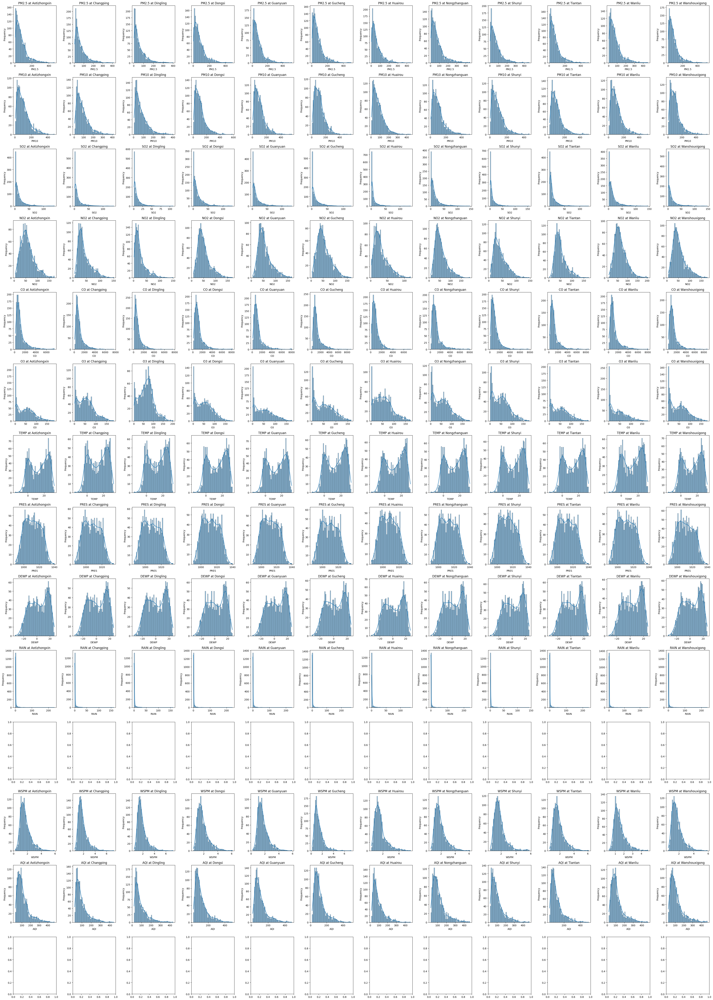

In [46]:
# histogram plot for all feature and station
plot_histograms(feature_data_filter,resample='D')

When viewed from the histogram above, the air pollution parameters are mostly distributed on the left side of the curve so they may need to be transformed into logarithmic, square root, cubic root OR reciprocal. This is done so that the data is normally distributed and can be used for forecasting. But this is done with a note after removing outliers to simplify the analysis.

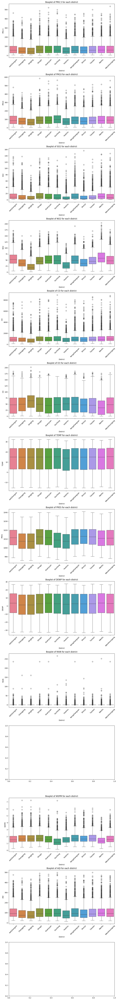

In [47]:
# boxplot for each feature
plot_boxplots(feature_data_filter,resample='D')

if you look at the boxplot above, many features and stations have extreme values in their respective data, so it is necessary to remove these extreme value outliers so that they do not interfere with model predictions. Next, we try to remove the extreme values in the data using several methods, including hampel filter and IQR. We will try all of them to see which one is better for removing filters.

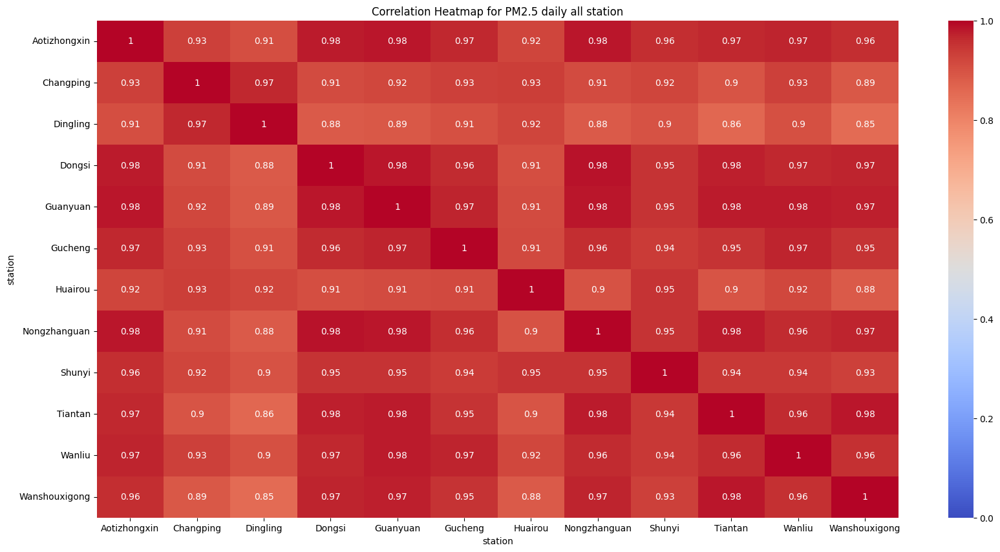

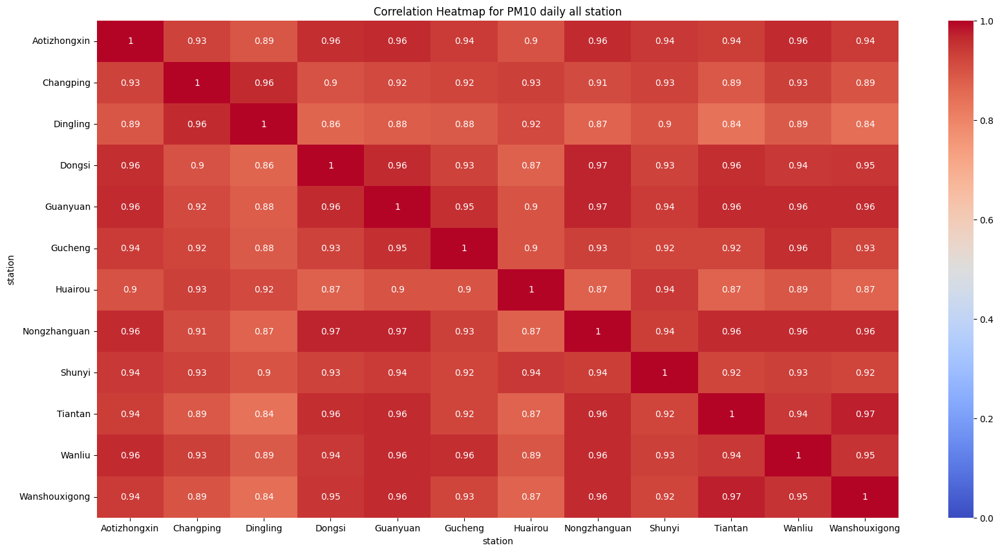

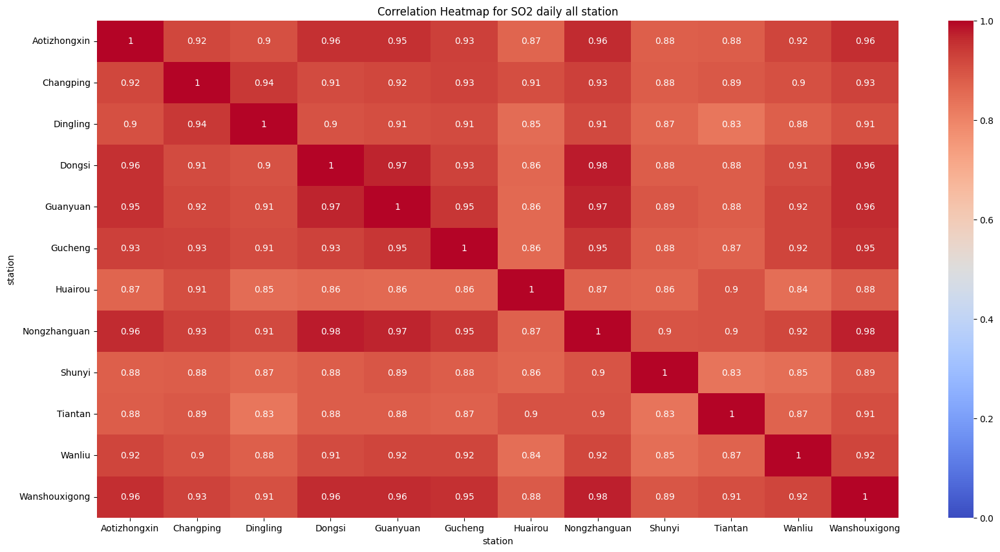

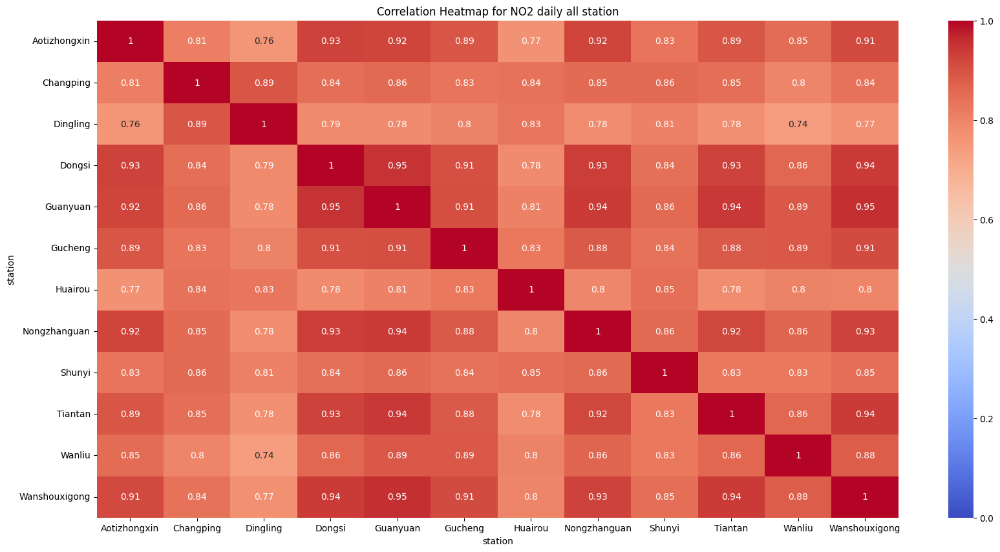

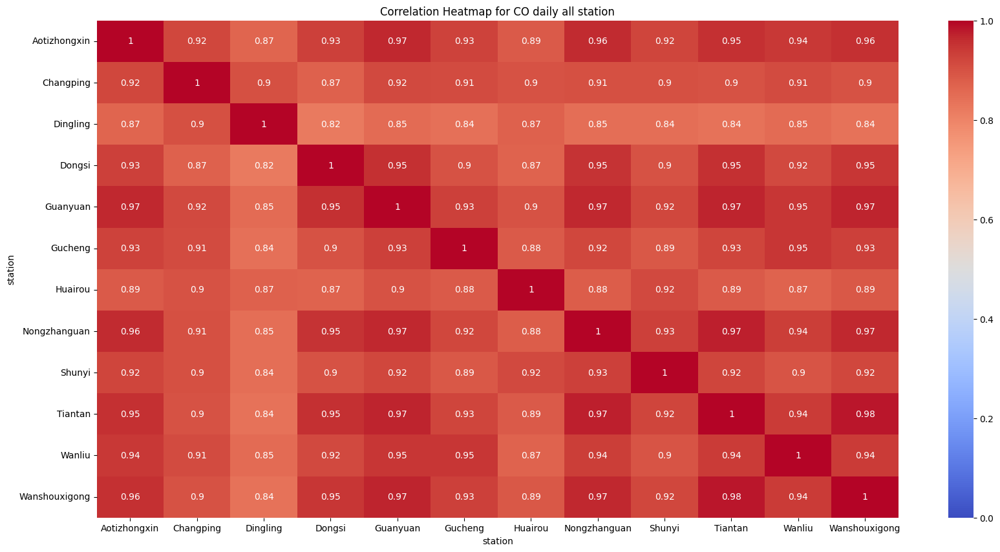

...

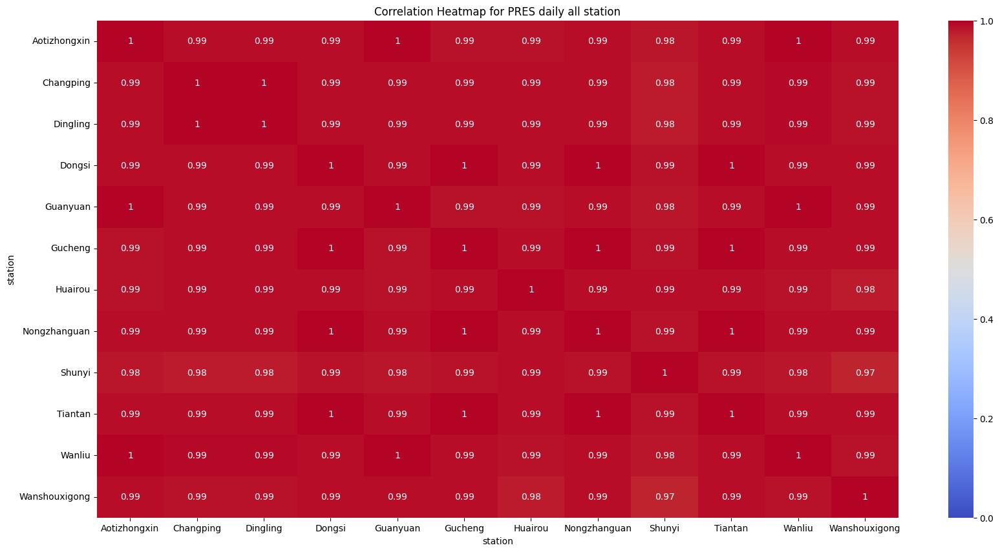

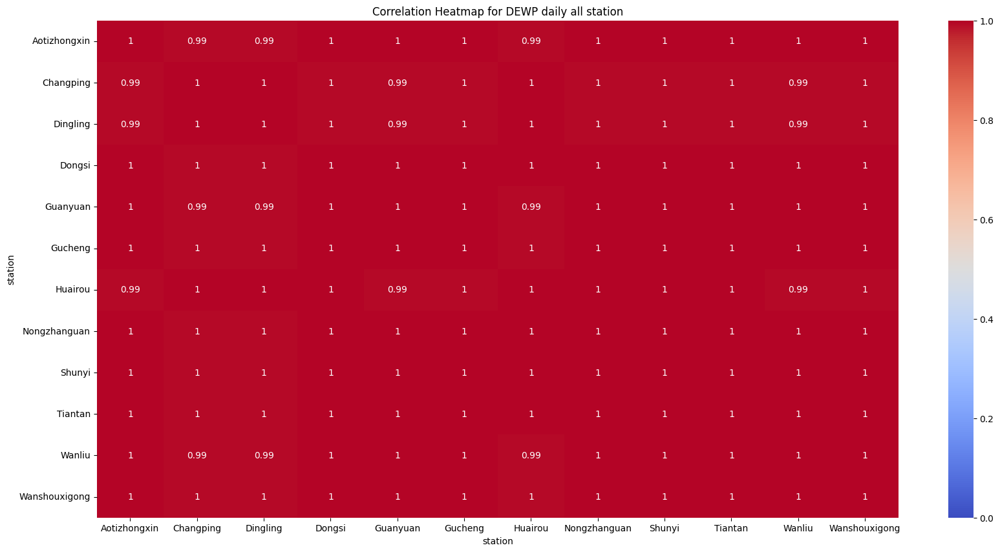

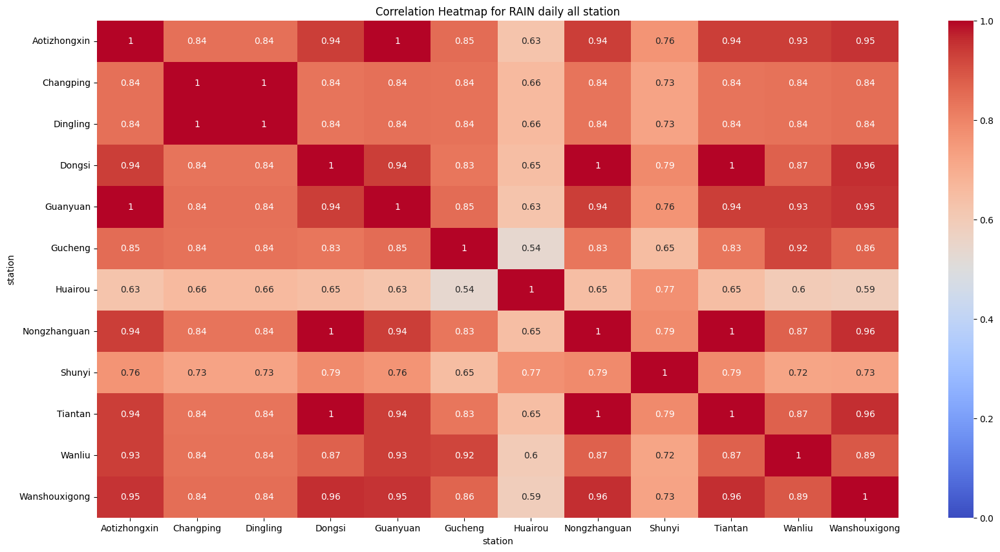

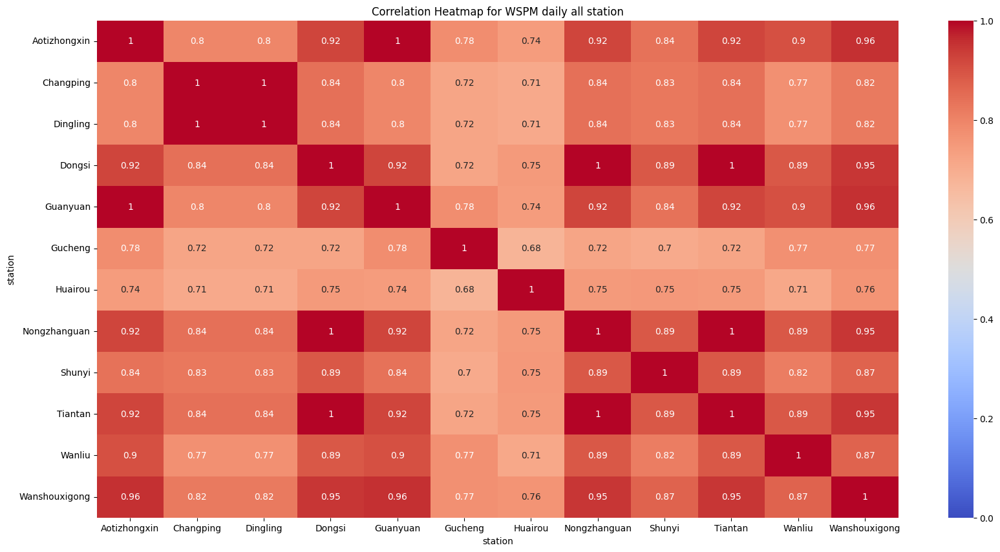

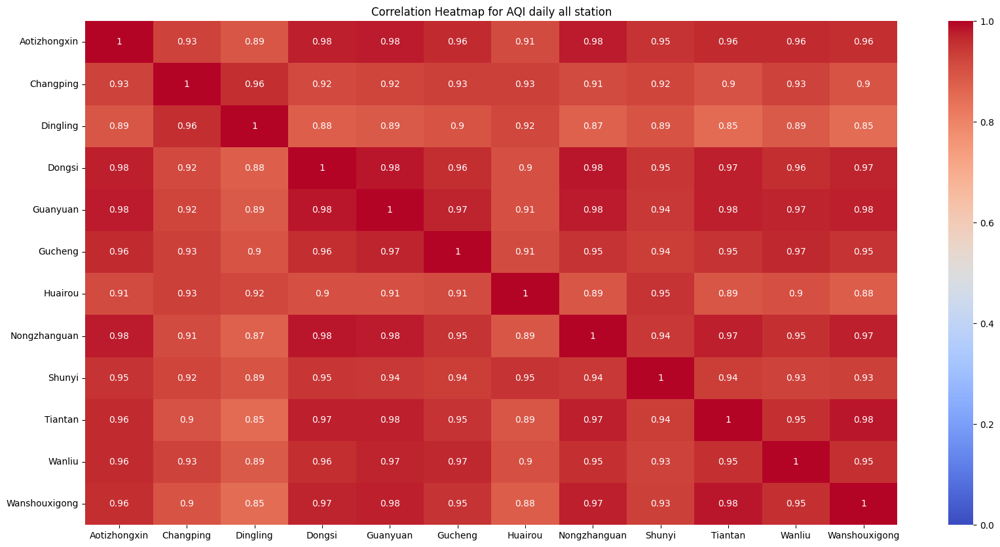

In [48]:
# daily resolution data
for i,v in enumerate(feature_data_filter.keys()):
  if v in ['wd','AQI_category_max']:
    continue
  else :
    df_corr = feature_data_filter[v].resample('D').mean().corr(method='pearson')

    plt.figure(figsize=(20,10))
    sns.heatmap(df_corr, annot=True, cmap='coolwarm', vmin=0, vmax=1)
    plt.title(f'Correlation Heatmap for {v} daily all station')

plt.show()

For features other than RAIN and WSPM, each station has an average correlation of moderately strong to very strong (correlation > 0.6), meaning that each station has a relationship with other stations for that feature. But if we look at the RAIN and WSPM features, there are some stations that correlate quite strongly with other stations and some that do not. According to my analysis, the possibility of stations that are strongly correlated with other stations could be that the two stations are close to each other or in the same area. If based on this analysis, it means that the stations that are close to each other include:
1.   Aotizhongxin and Guanyuan
2.   Changping and Dingling
3.   Dongsi, Nongzhanguan and Tiantan




If we compare with the hourly correlation heatmap, the correlation results between stations whose data is averaged daily actually increase in each feature. This also indicates that all stations are in the same region, because changes in air quality and daily weather in the same region will not be much different even though the measurement points are different.

In [49]:
# Assuming station_data is already created as in the provided code.

for station_name in station_data:
    station_data[station_name]['AQI'] = df_aqi_max[station_name]
    station_data[station_name]['AQI_category_max'] = df_aqi_category[station_name]


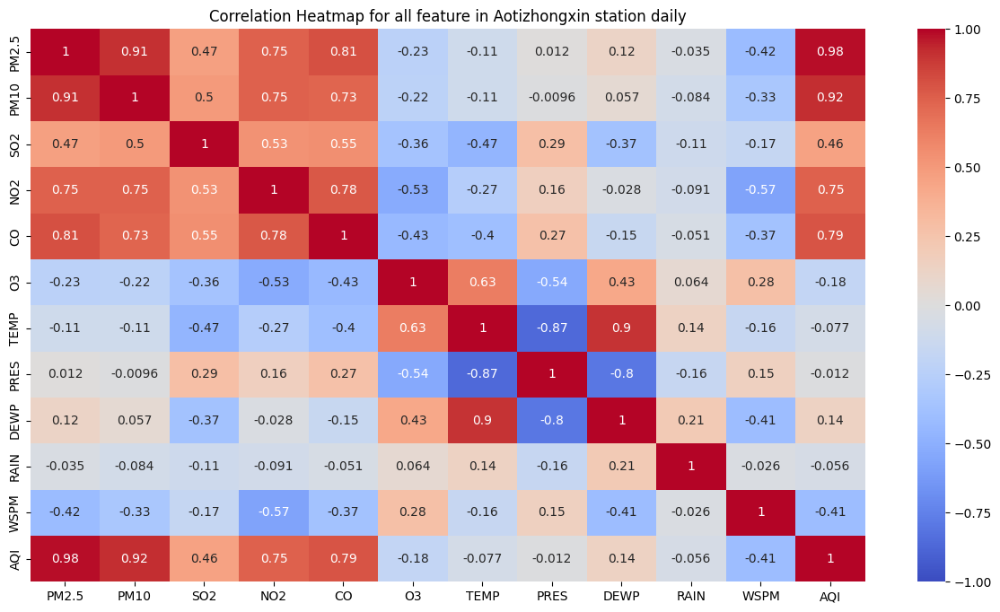

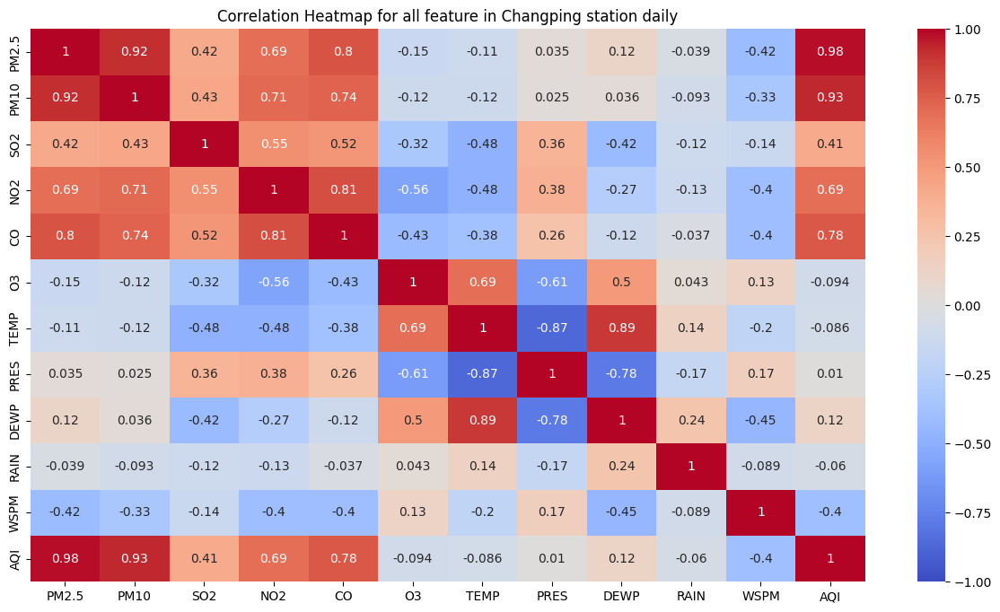

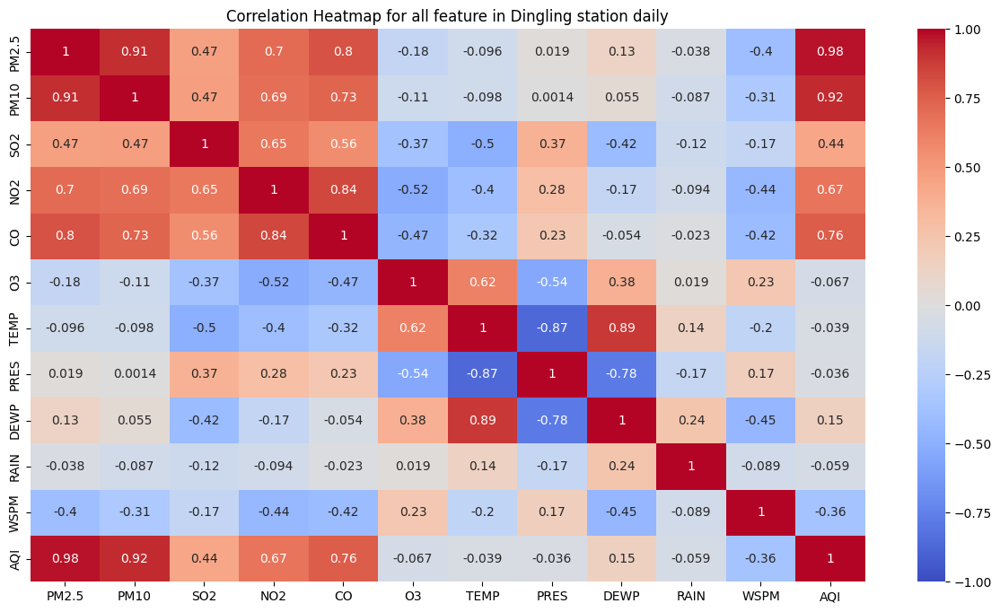

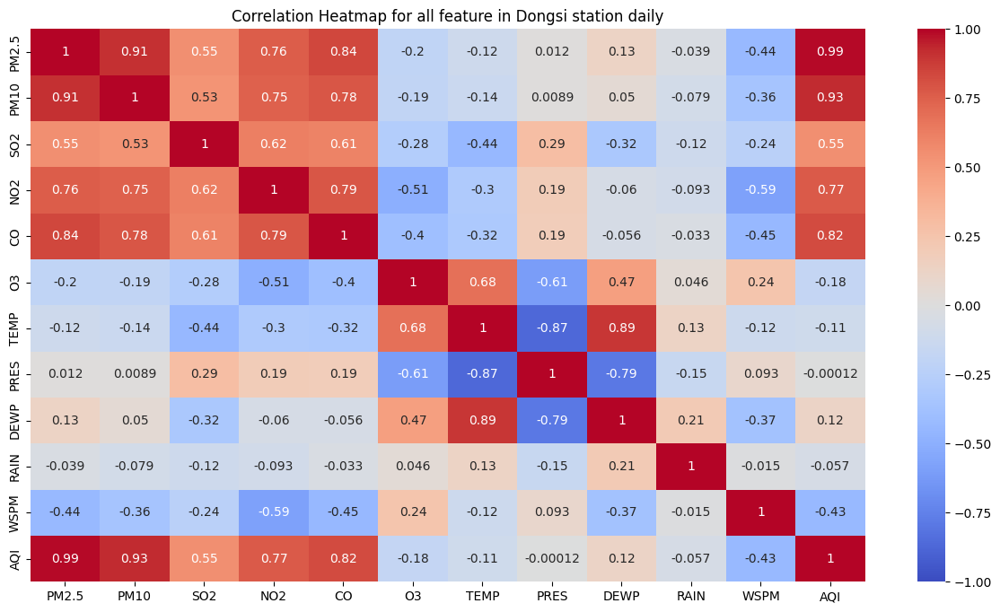

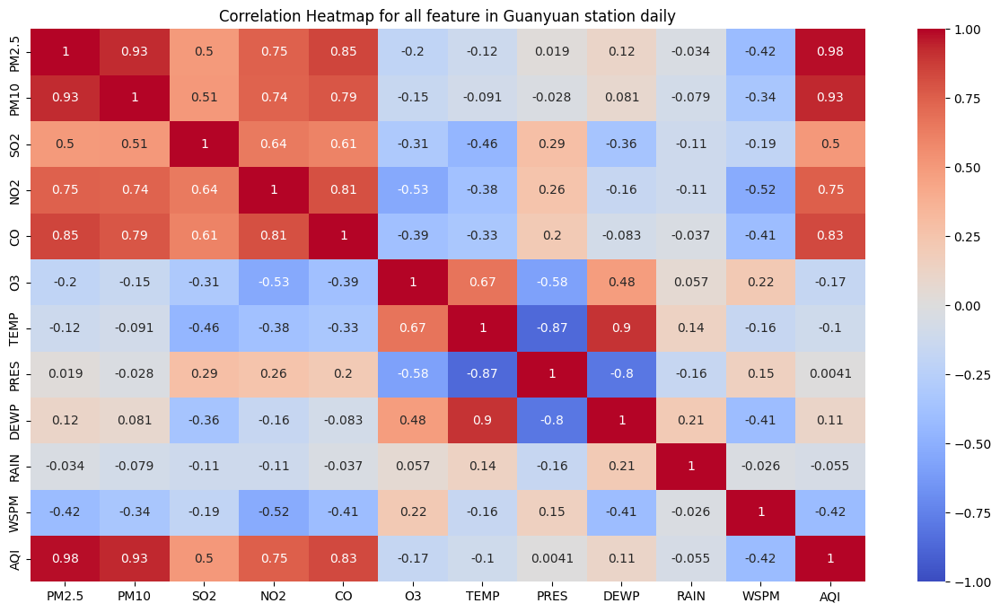

...

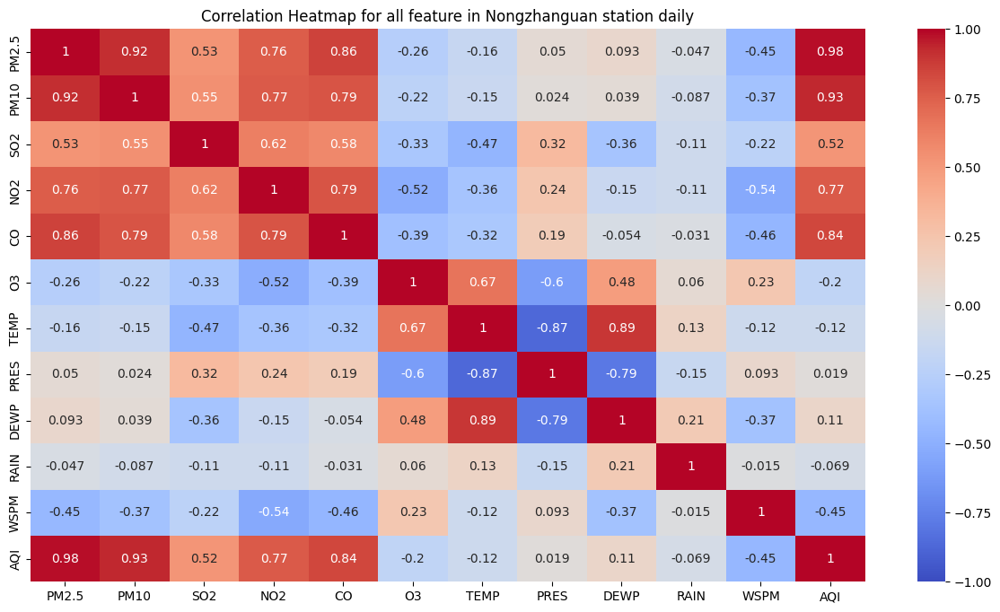

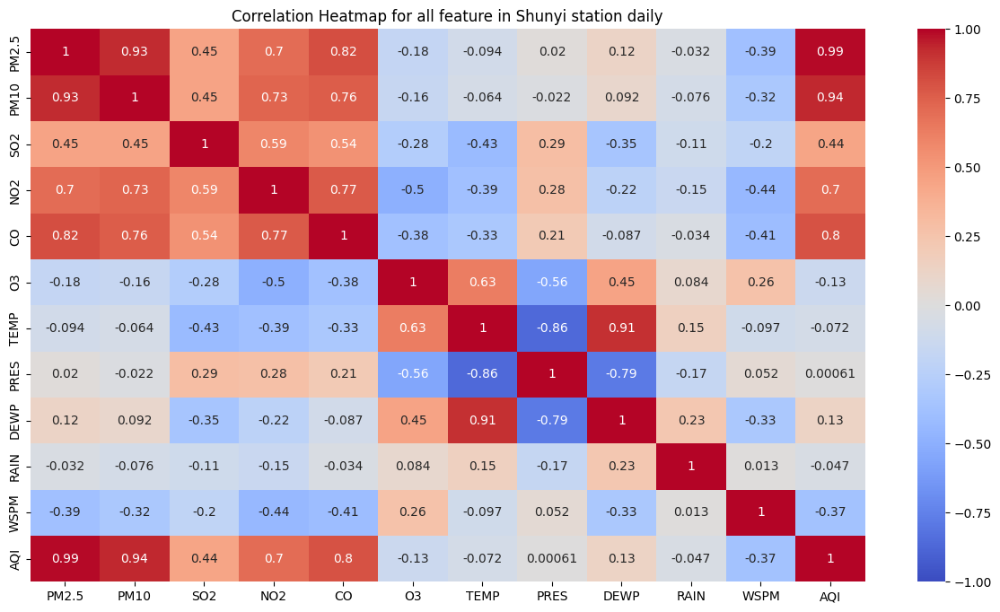

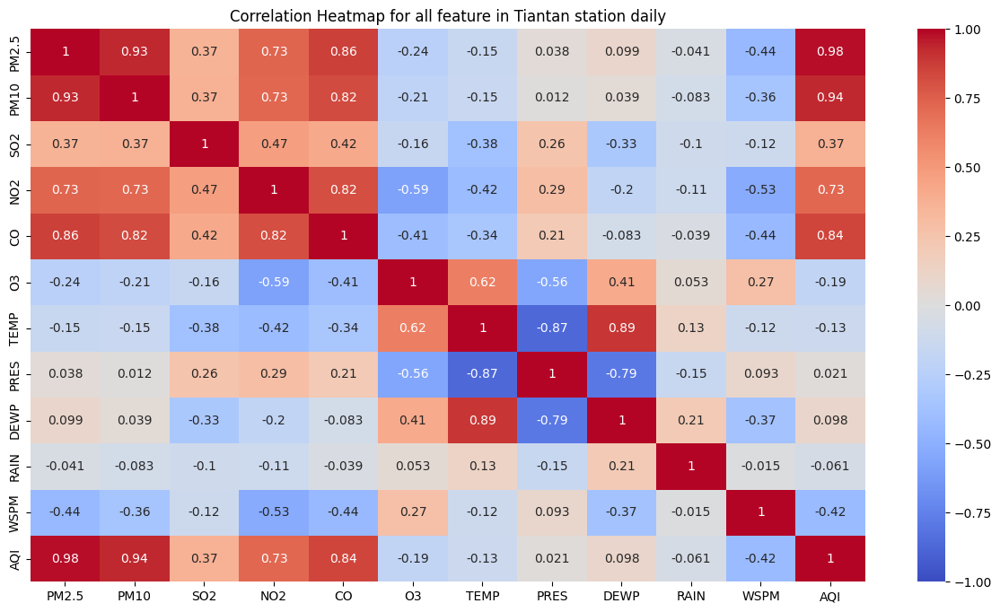

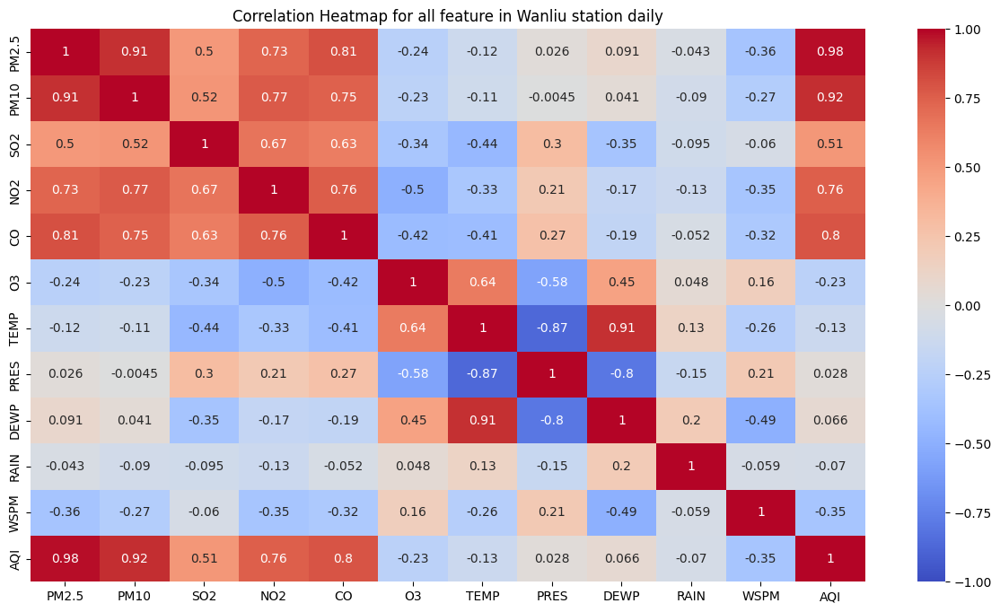

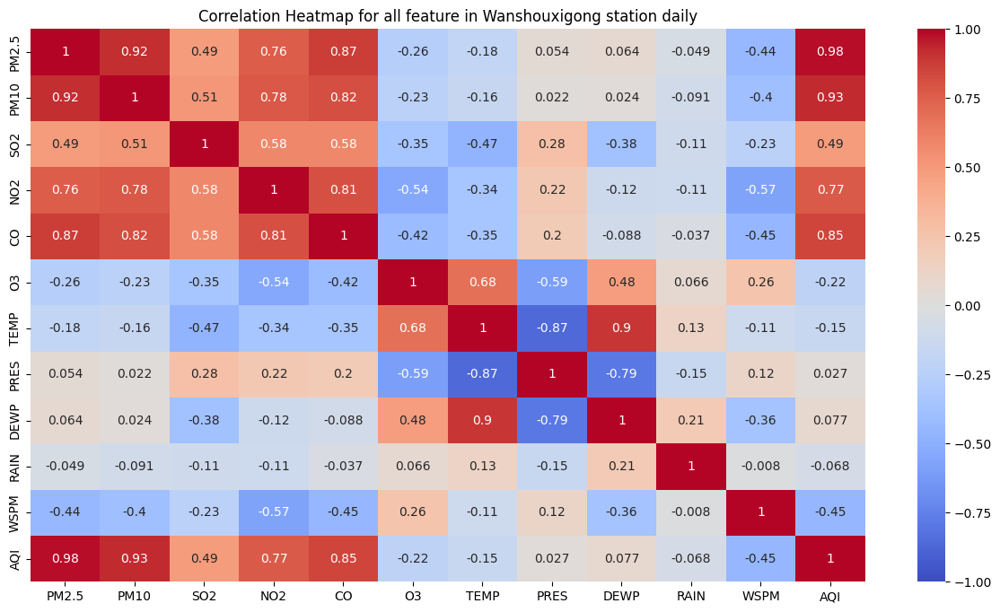

In [50]:
# This correlation describe relationship between feature each station daily

for i, station_name in enumerate(station):
  data = station_data[station_name].drop(['wd','AQI_category_max'],axis=1)
  df_corr = data.resample('D').mean().corr(method='pearson')

  plt.figure(figsize=(15,8))
  sns.heatmap(df_corr, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
  plt.title(f'Correlation Heatmap for all feature in {station_name} station daily')

plt.show()

As a result, the correlation value increases and the same phenomenon occurs if we correlate the data between stations for each feature.

For the next analysis, due to the large number of stations to be analyzed, I will sample only a few stations. Based on the correlation results between stations with the previous hourly data resolution, I took Dongsi station because this station has a very strong correlation in the weather correlated features (TEMP, PRES, DEWP, RAIN and WSPM) and then strong correlation with Nongzhanguan	and Tiantan station. Another reason is that because the correlation between stations for all features is high, we take one sample station for feature analysis.

array([[<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>]], dtype=object)

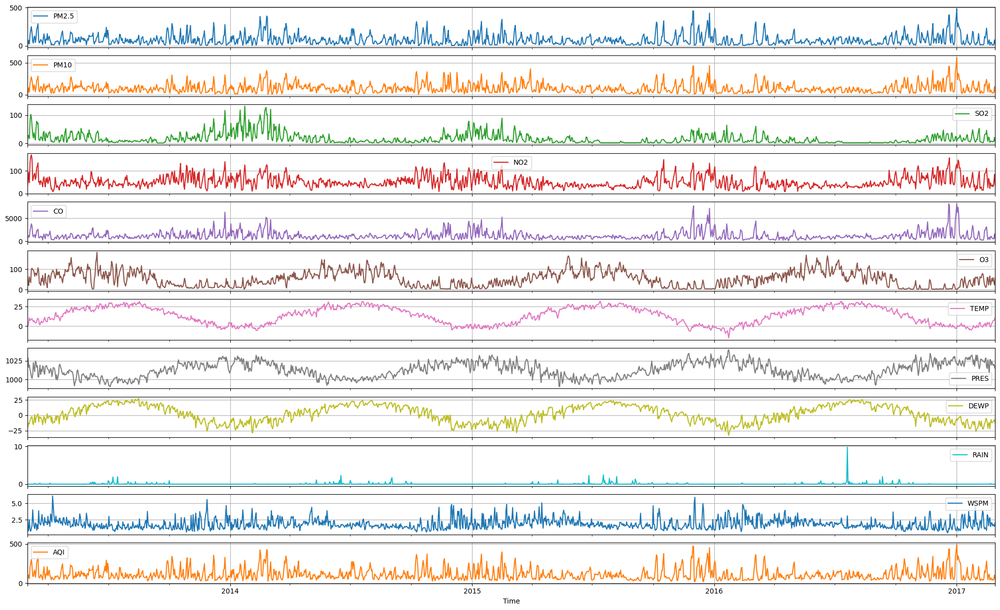

In [51]:
# line plot daily
dongsi_data = station_data['Dongsi'].copy()     #digunakan untuk analisis selanjutnya
dongsi_station = dongsi_data.copy()
dongsi_station.drop(['wd','AQI_category_max'],axis=1,inplace=True)
dongsi_station = dongsi_station.resample('D').mean()
dongsi_station.plot(kind='line',subplots=True,layout=(12,1),figsize=(25,15),grid=True)

hasil analisis :
1. untuk feature SO2, NO2, dan CO memiliki trend yang mirip yang mana setiap bulan Januari konsentrasinya sangat berfluktuasi, ini menandakan di saat bulan-bulan tidak hujan, konsentrasi ketiga senyawa meningkat dibulan-bulan ini juga. Ini ditandai dengan kecilnya nilai curah hujan pada feature RAIN. Ketiga senyawa juga memiliki periode yang sama
2. ketiga senyawa juga berfluktuasi dengan mengikuti periode yang sama dengan feature TEMP, PRES dan DEWP. Kemungkinan ketiga senyawa memiliki hubungan dengan ketiga feature tadi. Kemungkinan ini berhubungan dengan konsep gas ideal yang berlaku di atmosfer

In [52]:
# rolling least square function

def rolling_least_squares(series, window=10):
  """
  Calculates the rolling least squares regression for a time series.

  Args:
    series: A pandas Series with a DateTimeIndex.

  Returns:
    A pandas DataFrame with 'slope' and 'intercept' columns,
    indexed by the same DateTimeIndex as the input series.
  """

  # Calculate timedelta from the first index
  x = (series.index - series.index[0]).total_seconds() / (24 * 60 * 60)

  # Initialize results DataFrame
  results = pd.DataFrame(index=series.index)
  results['ori'] = series
  results['pred'] = np.nan
  results['slope'] = np.nan
  results['intercept'] = np.nan

  # Rolling window calculation (adjust window size as needed)
  window_size = window  # Example window size
  for i in range(window_size, len(series)):
    y = series[i - window_size:i + 1]
    x_window = x[i - window_size:i + 1]

    # Calculate least squares
    slope, intercept = np.polyfit(x_window, y, 1)
    series_new = x[i] * slope + intercept

    results.loc[series.index[i], 'pred'] = series_new
    results.loc[series.index[i], 'slope'] = slope
    results.loc[series.index[i], 'intercept'] = intercept


  return results

In [53]:
# Analisis Trend per tahun

def trend_analysis(station=None,feature=None,window=7):
  v = feature
  stations = station
  data = station_data[stations].copy()
  init_series = data[v].resample('D').mean().to_frame() #data di rata-ratakan menjadi perhari

  delta_time = init_series.index[:] - init_series.index[0]
  init_series['dt'] = delta_time.days

  window = window
  # metode analisis yang akan dibandingkan
  rolling_mean = init_series[v].rolling(window=window).mean()
  rolling_median = init_series[v].rolling(window=window).median()
  rolling_ols = rolling_least_squares(init_series[v],window=window)

  # muat semuanya dalam satu dataframe agar memudahkan visualisasi
  data_sample = pd.DataFrame()
  data_sample['Original'] = init_series[v]
  data_sample['Rolling_mean'] = rolling_mean
  data_sample['Rolling_median'] = rolling_median
  data_sample['Rolling_ols'] = rolling_ols['pred']

  display(data_sample.describe().T)

  fig,ax = plt.subplots(4,1,figsize=(20,15))
  plt.suptitle(f'Trend of {v} in {stations} with window {window} days')

  # visualisasi line graph, dimana setiap grafik menapilkan data per tahun
  for i, years in enumerate([2013,2014,2015,2016,2017]):
    if years in [2013,2014,2016]:
      bottom_range_time = dt.datetime(years,3,1)
      top_range_time = dt.datetime(years+1,2,28)
      data_sample[bottom_range_time:top_range_time].plot(kind='line',grid=True,ax=ax[i],ylim=(data_sample.describe().T.min()['min'],data_sample.describe().T.max()['max']))
    elif years == 2015:
      # khusus tahun 2015-2016 agak istimewa karena tahun 2016 merupakan tahun kabisat (bulan februari sampai tanggal 29)
      bottom_range_time = dt.datetime(years,3,1)
      top_range_time = dt.datetime(years+1,2,29)
      data_sample[bottom_range_time:top_range_time].plot(kind='line',grid=True,ax=ax[i],ylim=(data_sample.describe().T.min()['min'],data_sample.describe().T.max()['max']))
    else:
      break


  plt.tight_layout()
  plt.show()

Analisa Trend untuk PM2.5


,count,mean,std,min,25%,50%,75%,max
Original,1461.0,78.857602,70.067712,3.000000,27.416667,58.583333,106.125000,487.166667
Rolling_mean,1432.0,78.845748,25.639262,24.524107,61.614388,74.346681,90.219623,180.430114
Rolling_median,1432.0,62.268727,23.285479,15.979167,48.239583,60.786458,74.335938,188.958333
Rolling_ols,1431.0,78.320157,40.534427,-10.392179,52.515701,72.876364,98.088470,272.280812


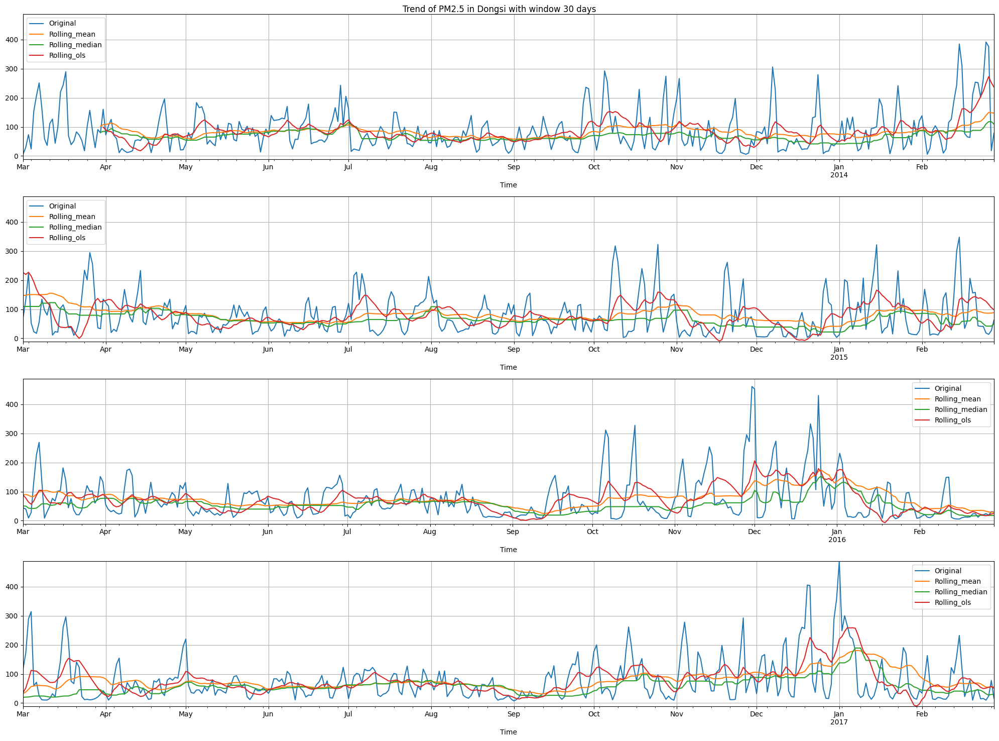



Analisa Trend untuk PM10


,count,mean,std,min,25%,50%,75%,max
Original,1461.0,102.700956,74.769385,4.833333,47.600000,85.791667,133.416667,584.666667
Rolling_mean,1432.0,102.632269,28.728853,37.770139,82.582055,98.741477,120.702761,213.320076
Rolling_median,1432.0,88.627346,27.863817,27.687500,72.520833,82.838542,105.083333,207.166667
Rolling_ols,1431.0,102.212505,43.777297,1.515667,72.499557,95.534920,126.507006,300.232195


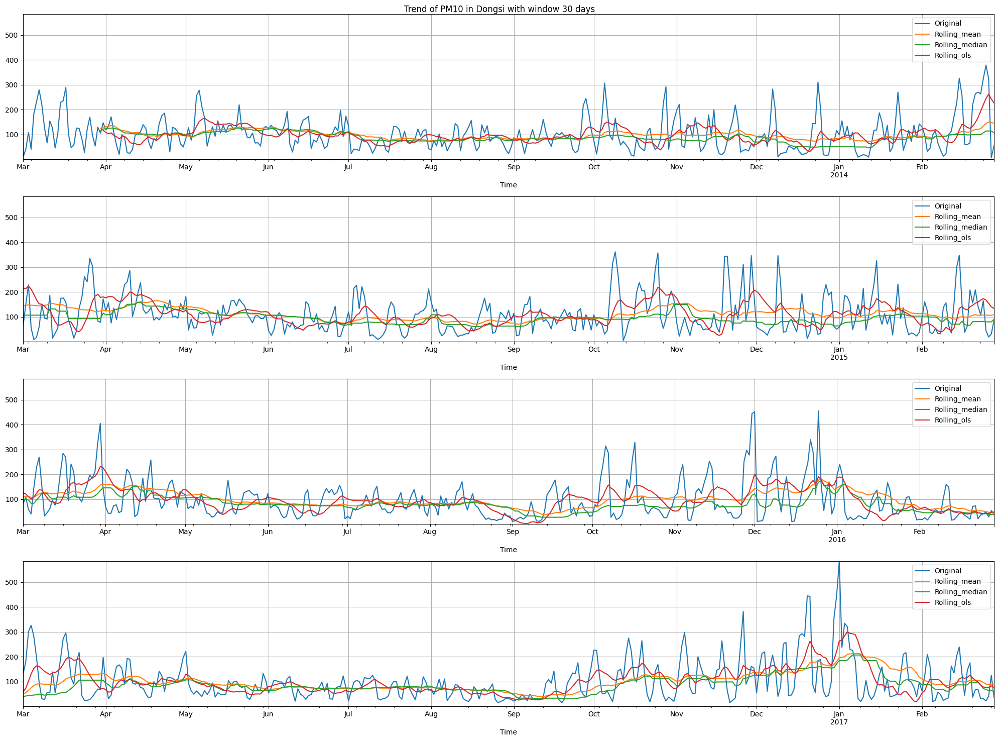



Analisa Trend untuk SO2


,count,mean,std,min,25%,50%,75%,max
Original,1461.0,16.037486,18.265619,1.000000,3.875000,9.395833,21.125000,131.916667
Rolling_mean,1432.0,15.800179,12.517255,2.020833,6.821051,11.872243,20.735804,64.133591
Rolling_median,1432.0,13.220838,12.071316,2.000000,5.104167,9.020833,17.851017,67.911458
Rolling_ols,1431.0,15.569585,14.105159,-1.300234,6.022969,11.481743,21.068933,95.381415


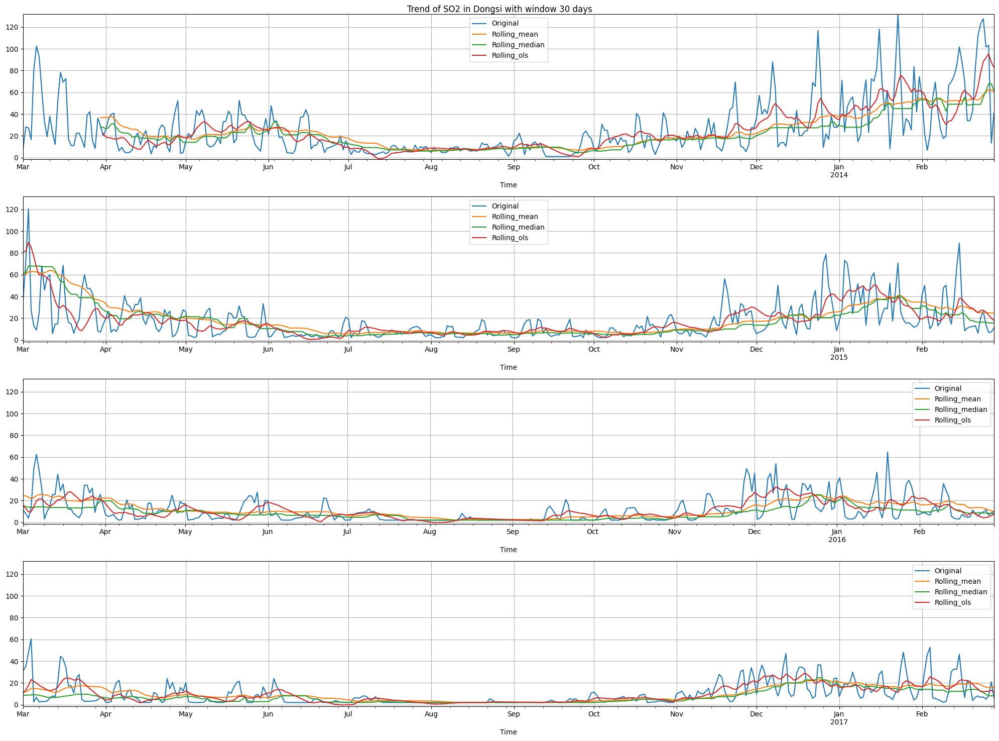



Analisa Trend untuk NO2


,count,mean,std,min,25%,50%,75%,max
Original,1461.0,51.274588,25.663564,7.750000,33.541667,45.250000,62.625000,170.208333
Rolling_mean,1432.0,50.926426,13.104819,28.962996,40.425671,48.417258,61.668423,89.276919
Rolling_median,1432.0,48.840052,13.257864,26.833333,38.333333,46.947917,57.358948,97.814583
Rolling_ols,1431.0,50.610115,16.847763,17.914883,37.323885,47.946691,61.705807,111.273318


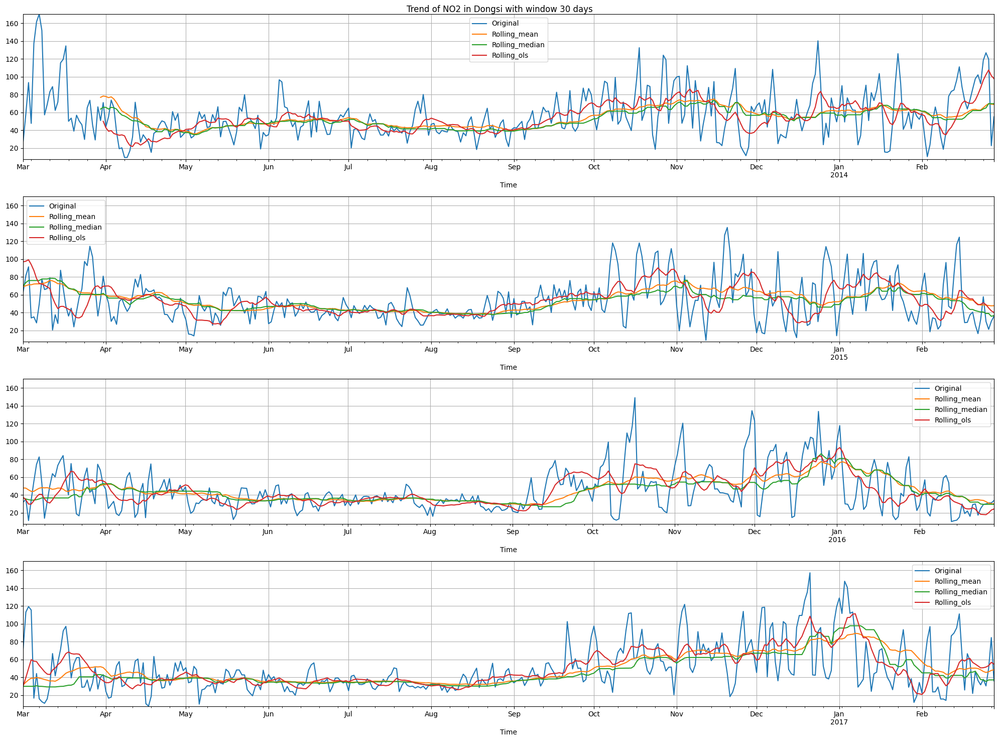



Analisa Trend untuk CO


,count,mean,std,min,25%,50%,75%,max
Original,1461.0,1219.099883,955.992683,137.500000,645.833333,956.250000,1408.333333,8166.666667
Rolling_mean,1432.0,1217.799319,469.441703,572.885101,894.036007,1084.340278,1386.204640,3212.198618
Rolling_median,1432.0,1072.177403,393.337297,441.666667,825.000000,958.541667,1228.906250,3056.250000
Rolling_ols,1431.0,1213.717932,643.686058,-141.393076,837.538184,1037.088374,1386.545339,5150.443884


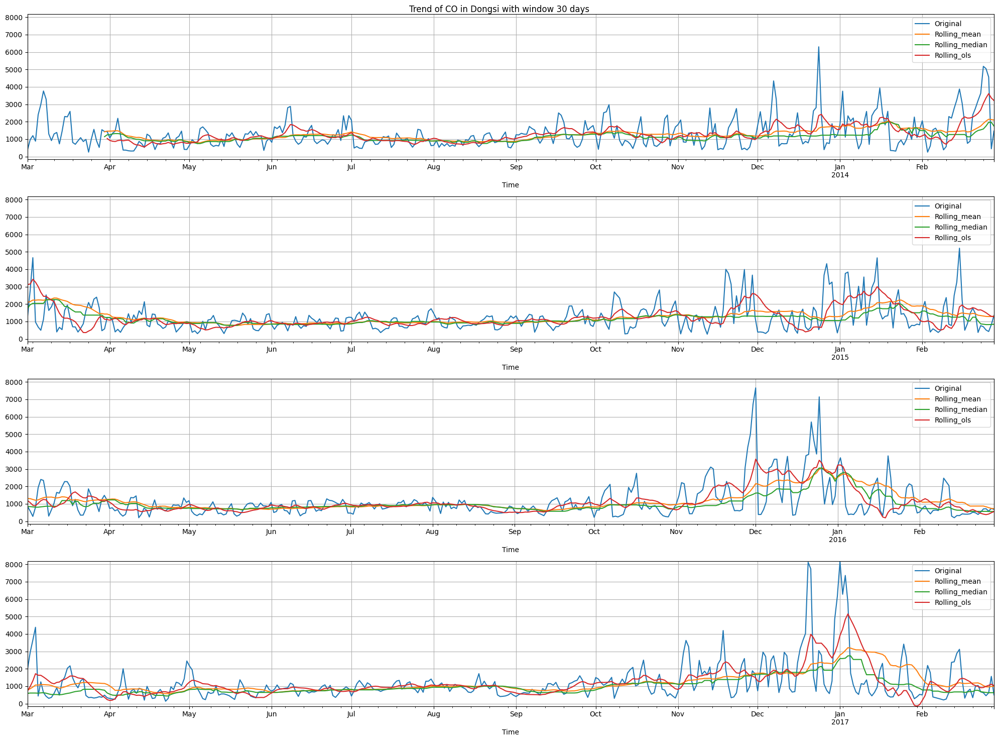



Analisa Trend untuk O3


,count,mean,std,min,25%,50%,75%,max
Original,1461.0,52.075996,36.602584,1.541667,18.906879,50.129167,77.291667,182.676850
Rolling_mean,1432.0,52.031150,30.022019,4.491667,21.525451,50.660877,79.536780,109.735172
Rolling_median,1432.0,49.774750,31.605524,2.000000,16.385417,52.375000,78.026042,110.479167
Rolling_ols,1431.0,51.808624,32.777917,-11.534258,19.874369,49.511020,80.061840,131.310564


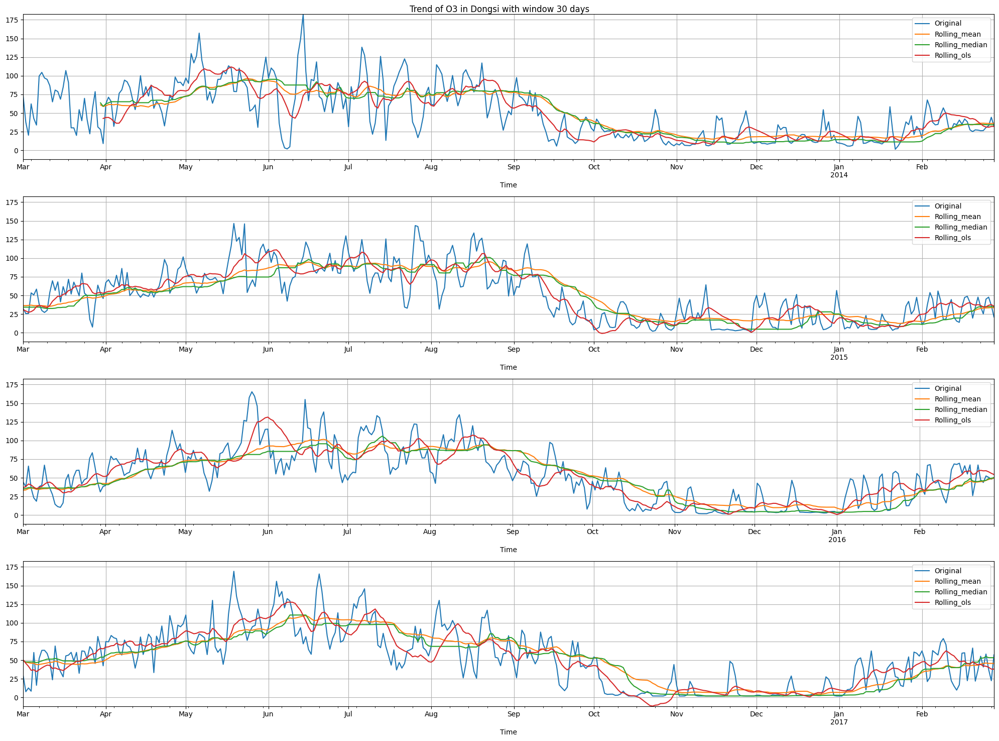



Analisa Trend untuk TEMP


,count,mean,std,min,25%,50%,75%,max
Original,1461.0,13.668394,10.906393,-15.233333,2.995833,15.104167,23.600000,32.350000
Rolling_mean,1432.0,13.845959,10.539269,-4.655278,2.716944,15.505157,24.218194,28.539028
Rolling_median,1432.0,13.928120,10.627684,-3.214583,2.696875,15.764583,24.618359,28.652083
Rolling_ols,1431.0,13.807853,11.052132,-8.242061,2.705646,15.842910,24.459371,30.716549


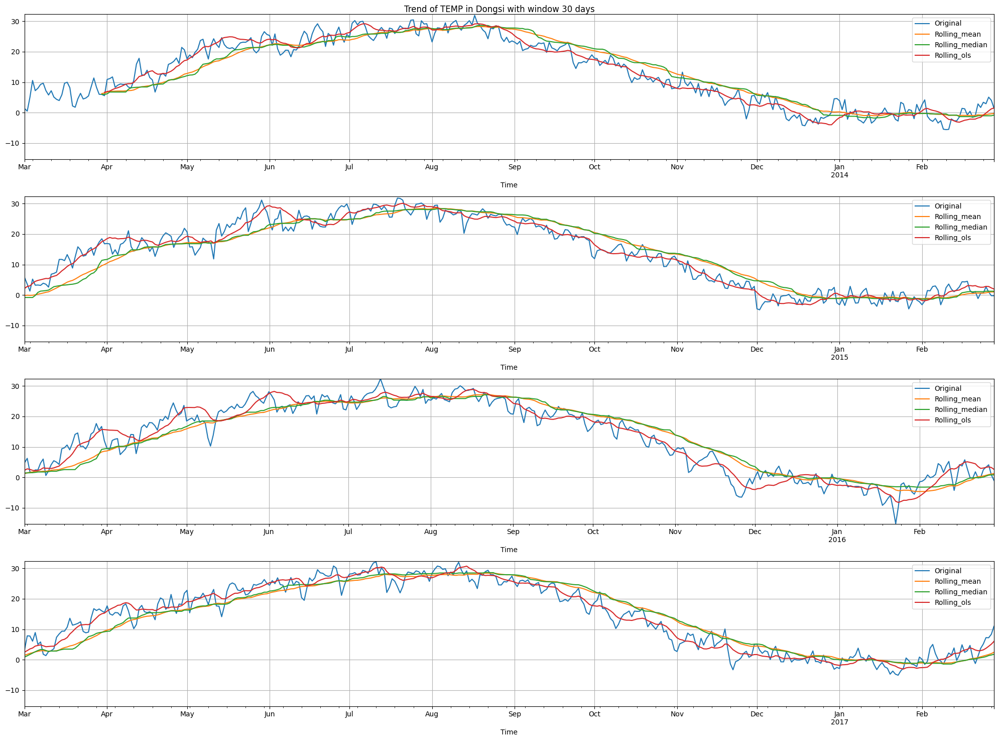



Analisa Trend untuk PRES


,count,mean,std,min,25%,50%,75%,max
Original,1461.0,1012.551352,10.062930,990.345833,1004.016667,1012.470833,1020.958333,1039.945833
Rolling_mean,1432.0,1012.440217,8.792678,997.514722,1003.628785,1012.359722,1020.946806,1026.939167
Rolling_median,1432.0,1012.591383,8.947101,997.120833,1003.856771,1012.677083,1021.489583,1026.829167
Rolling_ols,1431.0,1012.529832,9.435065,992.726999,1003.487555,1013.233249,1020.956015,1031.367524


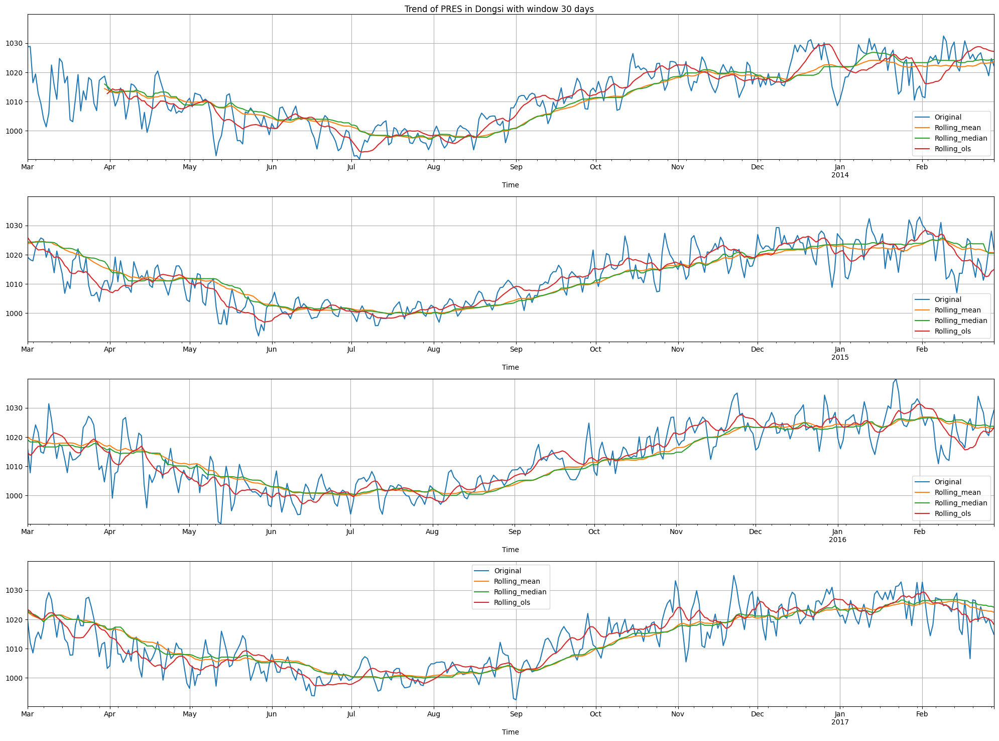



Analisa Trend untuk DEWP


,count,mean,std,min,25%,50%,75%,max
Original,1461.0,2.445155,13.548736,-32.566667,-9.166667,2.812500,14.900000,27.258333
Rolling_mean,1432.0,2.707444,12.470386,-19.570833,-8.945035,3.169236,14.567187,22.574028
Rolling_median,1432.0,3.122228,12.602698,-18.704167,-8.573958,3.825000,15.239583,22.775000
Rolling_ols,1431.0,2.635858,13.195147,-25.099496,-9.889441,3.353553,14.900256,24.820514


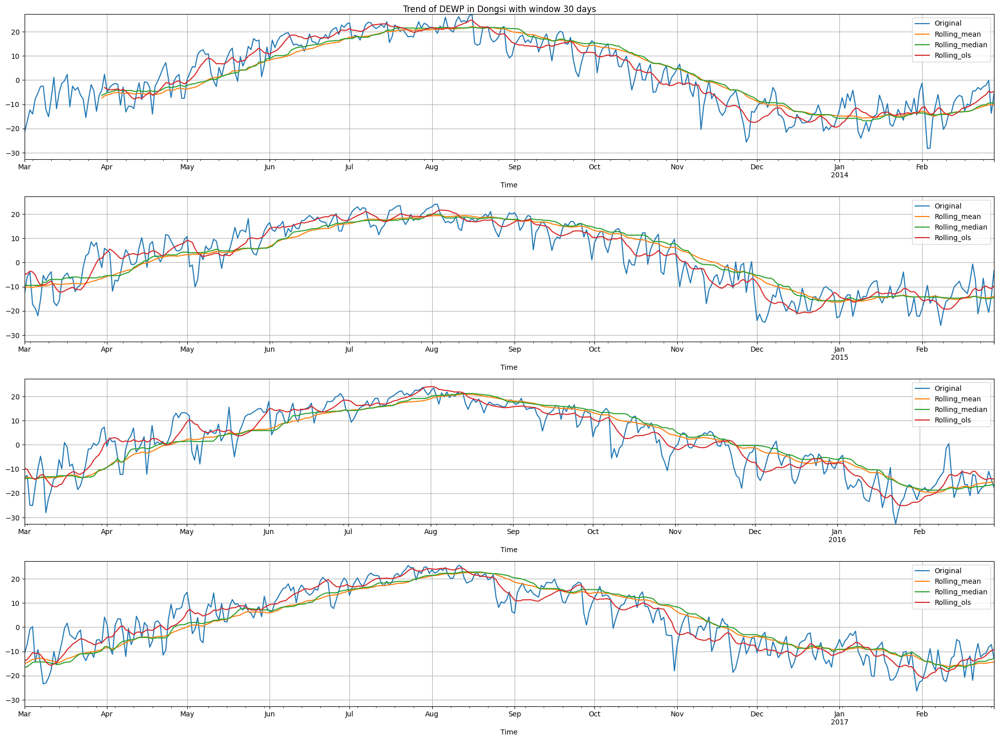



Analisa Trend untuk RAIN


,count,mean,std,min,25%,50%,75%,max
Original,1461.0,0.063983,0.337528,0.000000,0.000000,0.000000,0.000000,9.816667
Rolling_mean,1432.0,0.064995,0.088480,0.000000,0.001111,0.035139,0.086007,0.463056
Rolling_median,1432.0,0.000265,0.001790,0.000000,0.000000,0.000000,0.000000,0.020833
Rolling_ols,1431.0,0.064788,0.145320,-0.435257,0.000000,0.013105,0.084497,1.359677


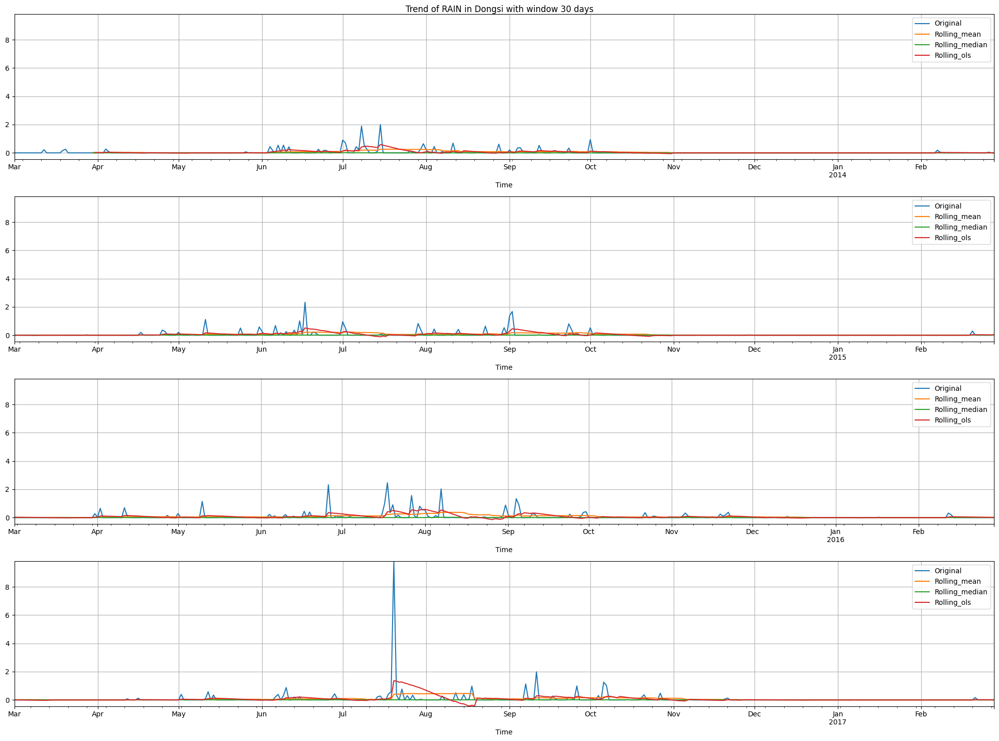



Analisa Trend untuk WSPM


,count,mean,std,min,25%,50%,75%,max
Original,1461.0,1.860757,0.786092,0.520833,1.312500,1.666667,2.208333,6.095833
Rolling_mean,1432.0,1.859688,0.326729,1.279167,1.582674,1.816319,2.101181,2.634722
Rolling_median,1432.0,1.686375,0.333801,1.097917,1.431250,1.618750,1.922917,2.679167
Rolling_ols,1431.0,1.860123,0.436119,0.922463,1.511828,1.777873,2.133795,3.335811


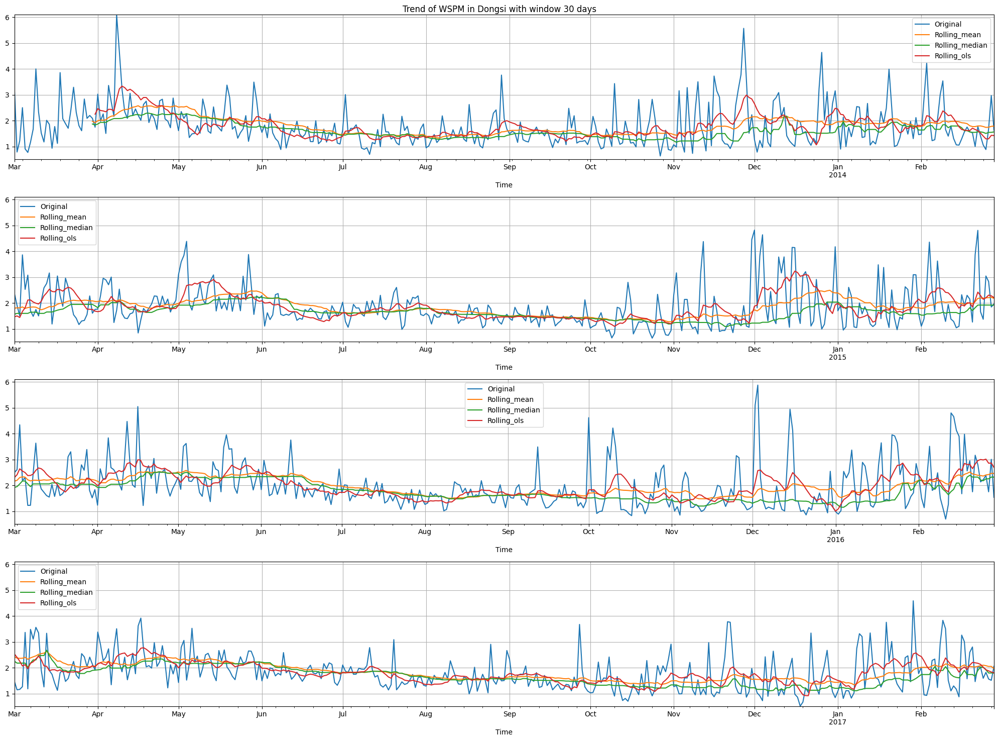



Analisa Trend untuk AQI


,count,mean,std,min,25%,50%,75%,max
Original,1461.0,113.499350,75.917111,20.360000,60.230000,89.690000,142.710000,491.440000
Rolling_mean,1432.0,113.478826,26.547027,53.300000,95.384917,110.208000,126.397833,218.138333
Rolling_median,1432.0,93.856547,24.930067,42.890000,79.847500,91.355000,104.123750,238.955000
Rolling_ols,1431.0,112.918081,43.045328,18.956714,84.964718,106.102137,135.284476,317.284093


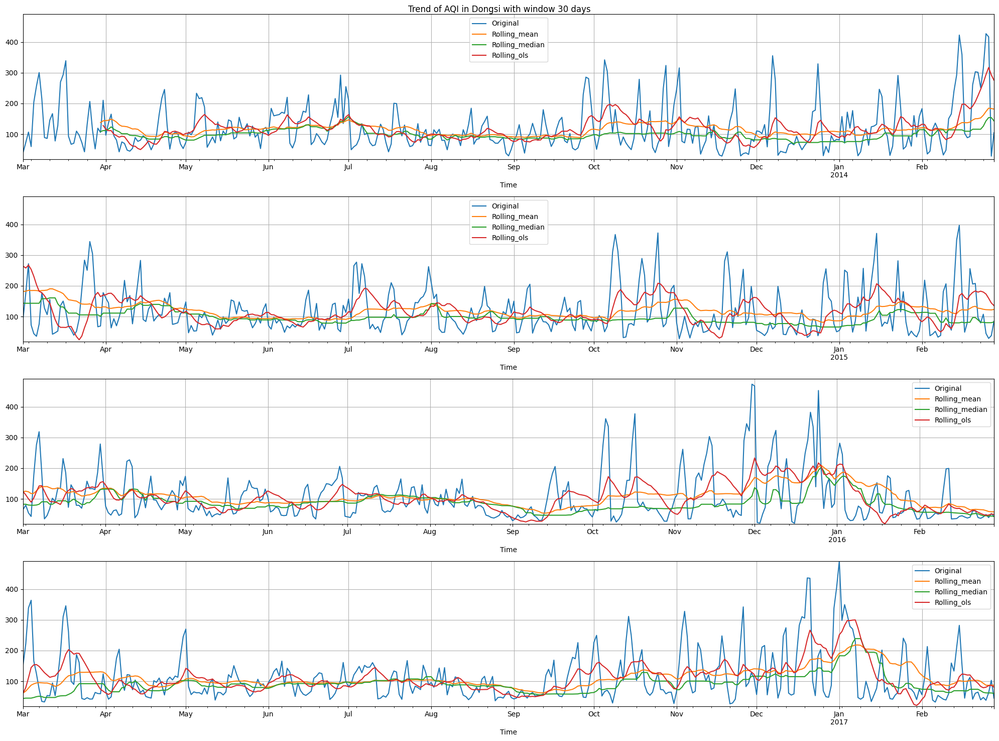

In [54]:
# visualisasi line graph untuk setiap feature numerik
for i,v in enumerate(dongsi_data.columns):
  if v in ['wd','AQI_category_max']:
    continue
  else :
    print(f'Analisa Trend untuk {v}')
    trend_analysis(station='Dongsi',feature=v,window=30)
  print("\n")

hasil analisi trend :
1. konsentrasi PM2.5 dan PM10 meningkat sangat besar di bulan Desember dan Januari pada tahun 2016 dan 2017, jika dibandingkan dari 2 tahun sebelumnya
2. konsentrasi SO2 menurun tiap tahunnya di sepanjang bulan Desember sampai Maret
3. Adanya lonjakan konsentrasi CO di beberapa hari pada bulan Desember dan Jauari tahun 2016 da 2017
4. Adanya anomali temperatur dan temperatur dew point di bulan januari pada tahun 2016 dari tahun lain, karena biasanya pada bulan ini nilai temperatur berkisar di 0 derajat celcius, tetapi pada tahun 2016 cukup berbeda dimana nilainya berkisar di bawah 0 derajat celcius
5. Adanya nilai ekstrim pada data hujan di bulan juli pada tahun 2016
6. Untuk metode trend, lebih bagus menggunakan rolling mean untuk representasi trend jangka panjang, kalau rolling ols sangat cukup merepresetasikan data karena fluktuasi jangka pendeknya juga kehitung

In [55]:
# trend analysis 2
def trend_analysis_2(station=None,feature=None,window=7):
  v = feature
  stations = station
  window = window

  # open data
  data = station_data[stations]
  a = data[v].resample('D').mean().rolling(window=window).mean()

  # format pembacaan kolom 'Time'
  format = '%m-%d %H:%M'

  # pengelompokan berdasarkan tahun
  a_2013 = a['2013-03-01':'2014-02-28'].reset_index().sort_values(by='Time',ascending=True)
  a_2013['month_day_hour'] = a_2013['Time'].dt.strftime(format)

  a_2014 = a['2014-03-01':'2015-02-28'].reset_index().sort_values(by='Time',ascending=True)
  a_2014['month_day_hour'] = a_2014['Time'].dt.strftime(format)

  a_2015 = a['2015-03-01':'2016-02-29'].reset_index().sort_values(by='Time',ascending=True)
  a_2015['month_day_hour'] = a_2015['Time'].dt.strftime(format)

  a_2016 = a['2016-03-01':'2017-02-28'].reset_index().sort_values(by='Time',ascending=True)
  a_2016['month_day_hour'] = a_2016['Time'].dt.strftime(format)

  # list tahun
  year = [2013,2014,2015,2016]
  # list data yang sudah dikelompokan per tahun
  data_year = [a_2013,a_2014,a_2015,a_2016]

  for i in range(4):
    if i == 0:
      a_new = data_year[i].merge(data_year[i+1], how='outer', on='month_day_hour', suffixes=(f'_{year[i]}', f'_{year[i+1]}'))
    elif i == 3:
      break
    else:
      a_new = a_new.merge(data_year[i+1], how='outer', on='month_day_hour', suffixes=(f'_{year[i]}', f'_{year[i+1]}'))

  a_new = a_new.set_index('Time_2015').sort_values(by='Time_2015',ascending=True)

  fig, ax = plt.subplots(figsize=(20,6))
  title = f'Trend {v} in {stations} with with window = {window} days'
  a_new.plot(kind='line',ax=ax,grid=True,y=[f'{v}_2013',f'{v}_2014',f'{v}_2015',f'{v}_2016'],
            label=['2013-2014','2014-2015','2015-2016','2016-2017'],legend=True,xlabel='Time',title=title)

  #set ticks every week
  #ax.xaxis.set_major_locator(mdates.MonthLocator())
  #ax.xaxis.set_minor_locator(mdates.WeekdayLocator())
  #set major ticks format
  #ax.xaxis.set_major_formatter(mdates.DateFormatter('%b'))

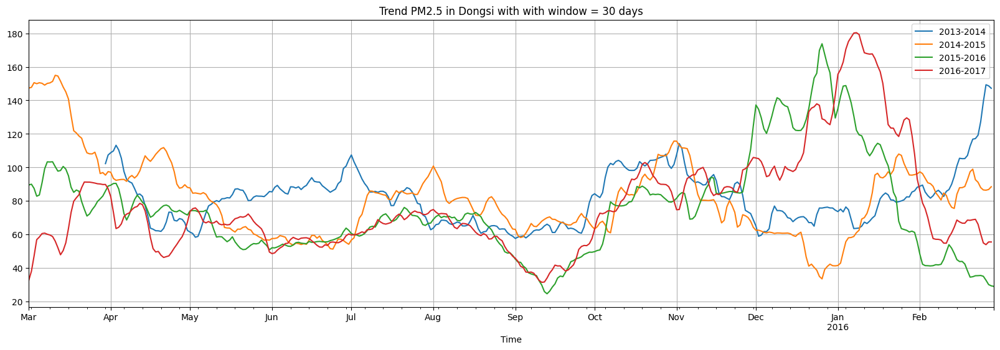

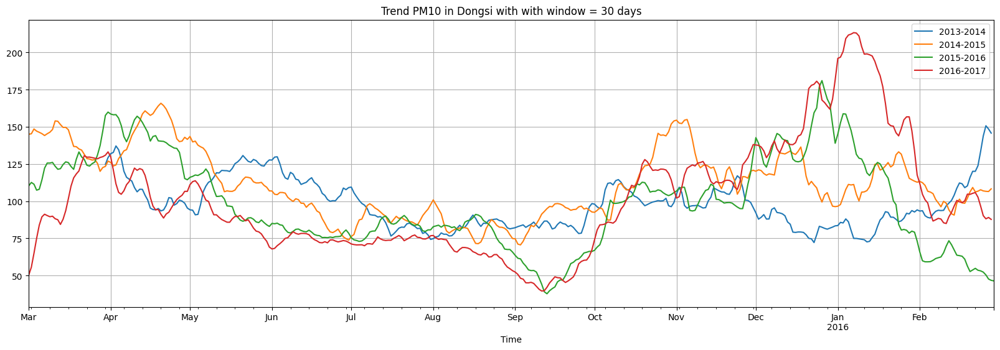

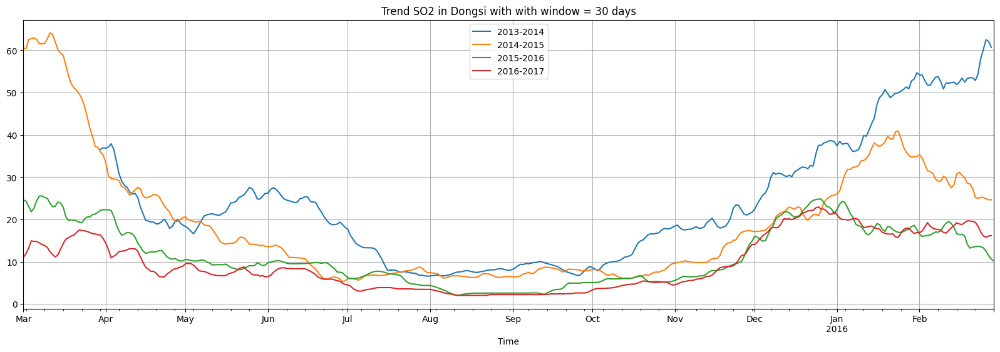

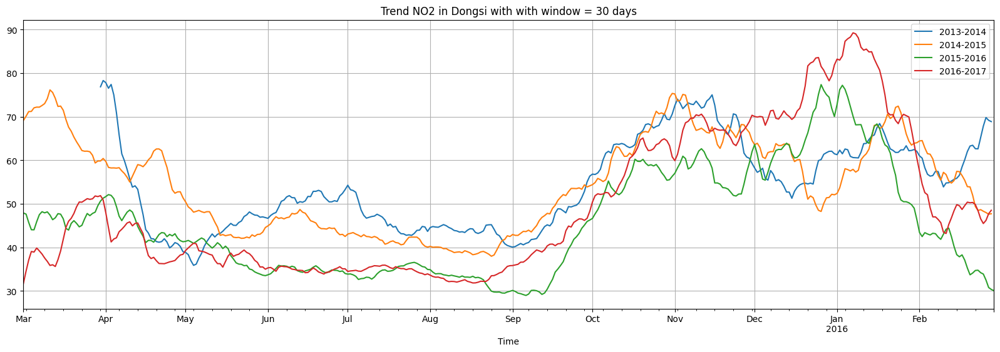

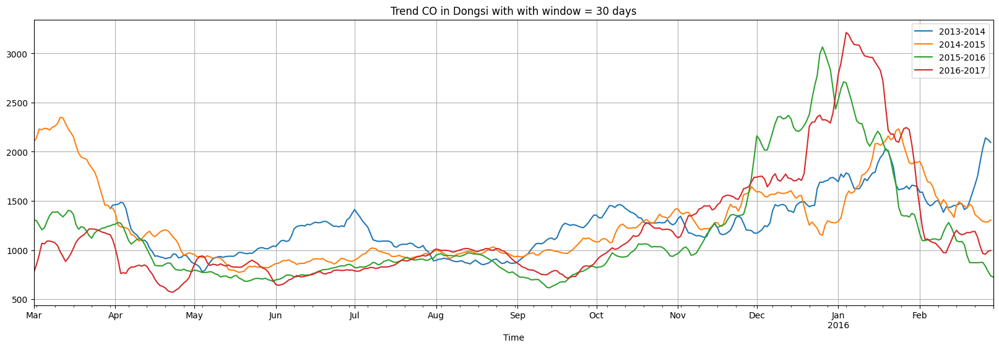

...

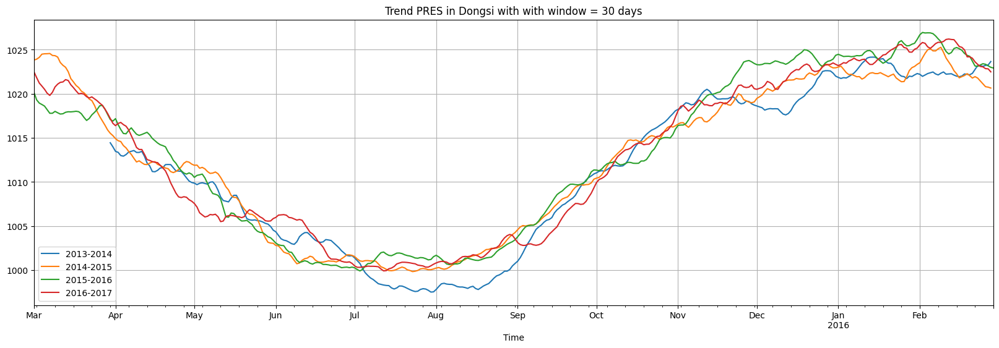

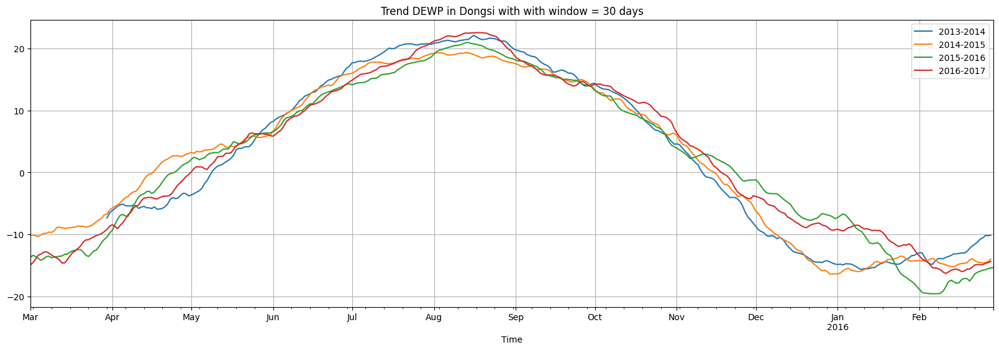

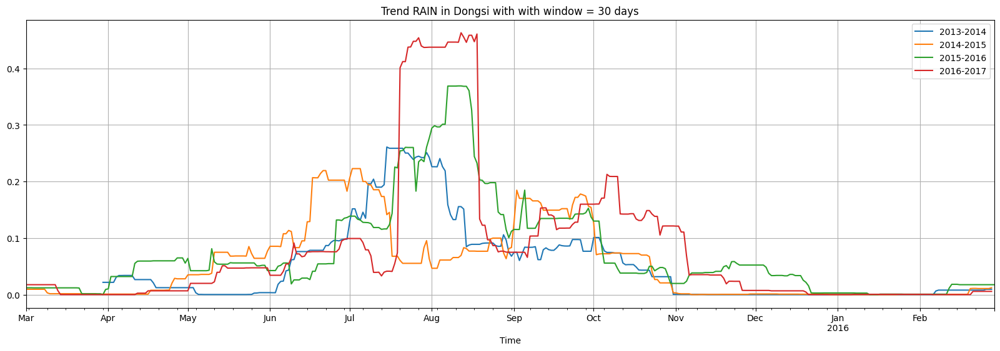

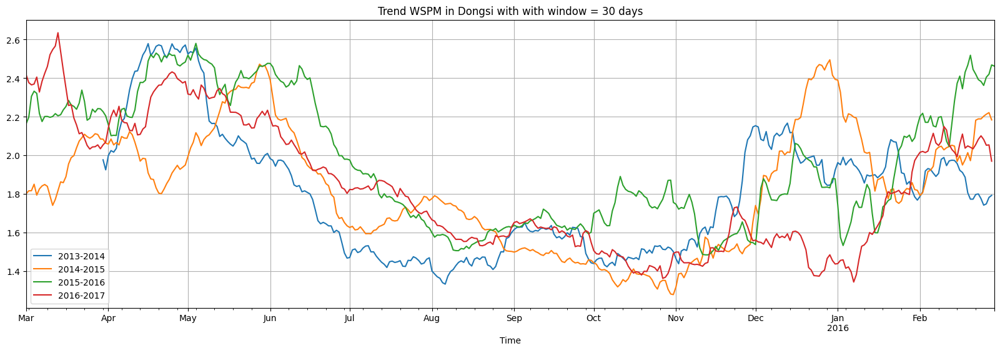

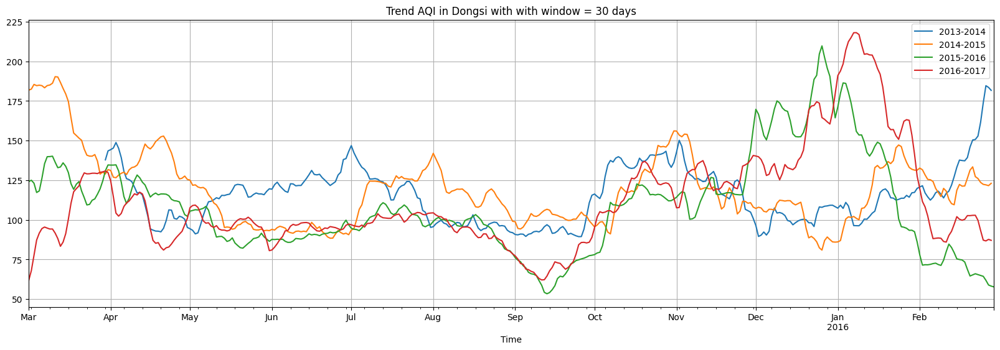

In [56]:
for i,v in enumerate(station_data['Dongsi'].columns):
  if v in ['wd','AQI_category_max']:
    continue
  else :
    trend_analysis_2(station='Dongsi',feature=v,window=30)

*   untuk feature O3, TEMP, PRES dan DEWP menunjukan indikasi trend musiman yang kuat,sementara SO2, NO2, CO dan WSPM menunjukan adanya indikasi trend musiman
*   untuk keempat feature yang terindikasi memiliki trend musiman, jika dilhat dari visualisasi diatas, periode musiman yang ada data terjadi setahun sekali



### Stationary Test

Stationary test is used to see whether the data has a seasonal pattern or not. The stationary test method used is the ADF test.

In [57]:
# fungsi uji stationeritas data
def adf_stationarity_test(data):
    """
    Performs the Augmented Dickey-Fuller (ADF) test for stationarity on a time series.

    Args:
        data: A pandas Series representing the time series data.

    Returns:
        A pandas DataFrame with the test results, indexed by the feature name.
    """

    result = adfuller(data)
    adf_result = pd.DataFrame({
        'statistic': [result[0]],
        'p_value': [result[1]],
        'critical_5%': [result[4]['5%']],
        'Stationer': ['Stationary' if result[1] < 0.05 else 'Non-Stationary']
    }, index=[data.name])
    return adf_result

def display_stationarity_results(station_data):
    """
    Displays stationarity test results for each feature in a station's data.

    Args:
        station_data: A pandas DataFrame containing time series data for a single station.
    """
    results = []
    for feature in station_data.columns:
      if feature not in ['wd', 'AQI_category_max']:
          results.append(adf_stationarity_test(station_data[feature]))
    if results:
      adf_results_df = pd.concat(results)
      display(adf_results_df)
    else:
      print("No valid features found for stationarity test.")


In [58]:
# Replace 'Dongsi' with the desired station name if needed.
data = dongsi_station
data = data.resample('D').mean()
display_stationarity_results(data)

,statistic,p_value,critical_5%,Stationer
PM2.5,-20.607104,0.000000e+00,-2.863523,Stationary
PM10,-7.906946,4.042852e-12,-2.863538,Stationary
SO2,-3.957873,1.647894e-03,-2.863544,Stationary
NO2,-4.686936,8.903900e-05,-2.863551,Stationary
CO,-6.099206,9.929266e-08,-2.863538,Stationary
O3,-2.686195,7.645784e-02,-2.863545,Non-Stationary
TEMP,-2.026560,2.750503e-01,-2.863528,Non-Stationary
PRES,-2.354806,1.549002e-01,-2.863539,Non-Stationary
DEWP,-1.773429,3.937311e-01,-2.863539,Non-Stationary
RAIN,-19.435293,0.000000e+00,-2.863524,Stationary


dari hasil tes menunjukan bahwa O3, TEMP, PRES dan DEWP memiliki trend musiman di dalamnya

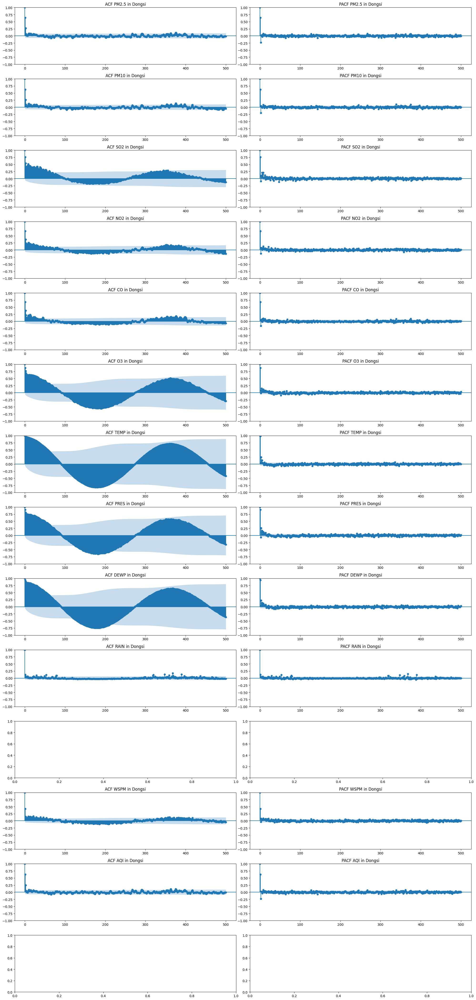

In [59]:
# Autokorelasi
fig1, axes1 = plt.subplots(len(dongsi_data.columns), 2, figsize=(20, 3*len(dongsi_data.columns)))

for i, variabel in enumerate(dongsi_data.columns):
  if variabel in ['wd','AQI_category_max']:
    continue
  else:
    data = dongsi_data
    data_dis = data[variabel].resample('D').mean()

  # Plot ACF dan PACF
  # ACF
  plot_acf(data_dis, ax=axes1[i,0], lags=500)  # lag determines the number of lags plotted
  axes1[i,0].set_title(f"ACF {variabel} in Dongsi")

  # PACF
  plot_pacf(data_dis, ax=axes1[i,1], lags=500, method="ywm")  # “ywm” method is more stable for big data
  axes1[i,1].set_title(f"PACF {variabel} in Dongsi")

plt.tight_layout()
plt.show()

dari hasil auto korelasi juga menunjukan feature O3, TEMP, PRES, dan DEWP memiliki trend musiman yang kuat dan untuk feature SO2, NO2, CO dan WSPM sebenarnya memiliki trend musiman tapi tidak sekuat trend musiman yang ditunjukan oleh feature O3, TEMP, PRES, dan DEWP karena amplitude korelasinya yang rendah (ditunjukan pada gambar diatas)

**Insight :**
1.   PM 2.5, PM 10, dan RAIN sudah bersifat stasioner karena nilai korelasi pada ACF nilainya langsung turun drastis mendekati nol dan visualisasinya tidak menunjukan adanya pola periodik yang terbentuk. Uji stasioner ADF juga menunjukan hasil keempat feature stasioner.

2.   O3, TEMP, PRES, DEWP sudah bersifat non-stasioner karena nilai korelasi pada ACF nilainya yang turun dan naik secara perlahan dan pada visualisi juga menunjukan pola periodik sehingga perlu uji stasioner dan harus diubah jadi stasioner agar membuat model prediksi semakin bagus. Uji stasioner ADF juga menunjukan hasil keempat feature non-stasioner. Pada visualisasi garis juga memperlihatkan pola berulang secara periodik dengan jelas.

3.  SO2, NO2, CO, dan WSPM sebenarnya secara hasil ACF dan uji ADF menunjukan ketiganya tidak stasioner. Tetapi, pada visualisasi garis menunjukan adanya pola berulang yang terjadi walaupun tidak jelas diperlihatkan pola berulang ini. Kadang pola periodik yang terbentuk semakin bertambah waktu peek atau puncak gelombangnya semakin rendah yang menandakan setiap penambahan siklus konsentrasinya menurun dibandingkan siklus sebelumnya. Untuk itu, selanjutnya keempat feature ini dilakukan juga transformasi menjadi stasioner agak lebih stasioner datanya.



### Nilai Ekstrim

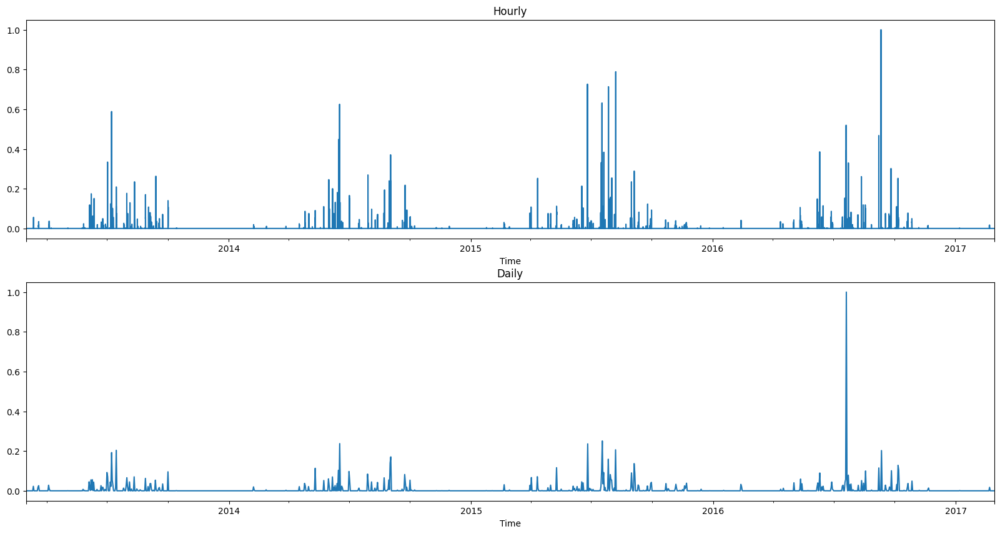

In [60]:
# Mengkoparasi data jam dengan data harian
data = dongsi_data

data1 = data['RAIN'].resample('h').mean()
norm_data1 = data1.apply(lambda x: (x-data1.min())/(data1.max()-data1.min()))

data2 = data['RAIN'].resample('D').mean()
norm_data2 = data2.apply(lambda x: (x-data2.min())/(data2.max()-data2.min()))

fig, axes = plt.subplots(2,1,figsize=(20,10))
norm_data1.plot(ax=axes[0],title='Hourly')
norm_data2.plot(ax=axes[1],title='Daily')
plt.show()

Mengapa saya lakukan normalisasi agar bisa menemukan letak waktu dari nilai yang ekstrim pada data harian dan membandingkannya dengan data jam. jika kita zoom in di tanggal yang bernilai ekstrim

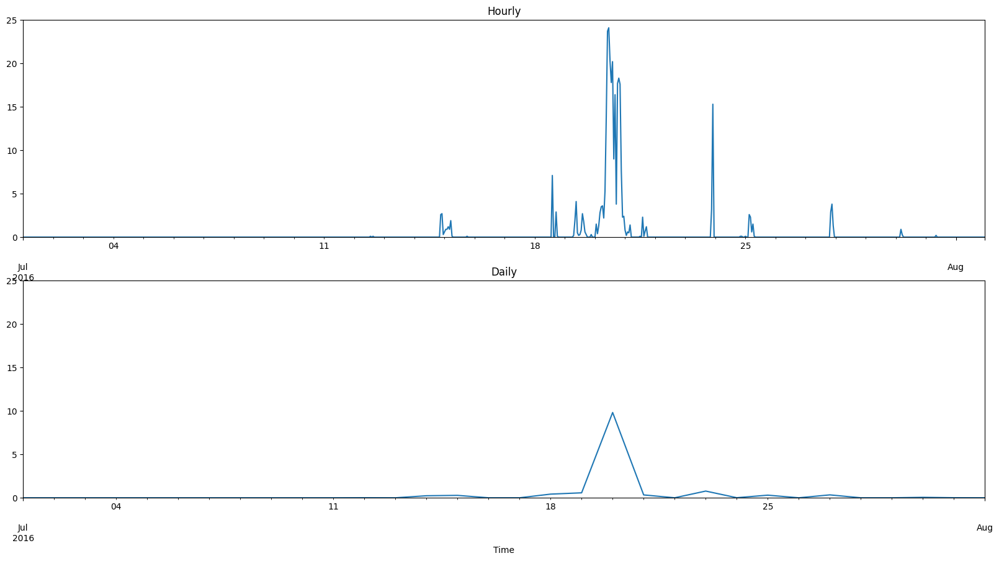

In [61]:
data = dongsi_data
data = data.loc['2016-07-01':'2016-08-01']

data1 = data['RAIN'].resample('h').mean()
#norm_data1 = data1.apply(lambda x: (x-data1.min())/(data1.max()-data1.min()))

data2 = data['RAIN'].resample('D').mean()
#norm_data2 = data2.apply(lambda x: (x-data2.min())/(data2.max()-data2.min()))

fig, axes = plt.subplots(2,1,figsize=(20,10))
data1.plot(ax=axes[0],title='Hourly',ylim=(0,25))
data2.plot(ax=axes[1],title='Daily',ylim=(0,25))
plt.show()

dari gambar diatas menunjukan bahwa nilai ekstrim pada data harian bukan outlier karena pada data jam nilai curah hujan sangat tinggi dalam satu hari

### Transformation (Stasionary)
selanjutnya kita mengubah feature yang terindikasi tida

In [62]:
# Menghilangkan efek trend
def diff_trend(dataframe,feature):
  data_diff = dataframe[feature].diff().dropna()
  return data_diff

# Menghilangkan efek musiman
def diff_seasonal(dataframe,feature):
  data_diff = dataframe[feature].diff(periods=365).dropna()
  return data_diff

# fungsi line graph setelah dilakukan differencing
def transform_vis(dataframe):
  data_station = dataframe.resample('D').mean()
  data_diff = data_station.copy()

  for i,feature in enumerate(data_diff.columns):
    if feature in ['O3', 'TEMP', 'PRES', 'DEWP']:
      data_diff[feature] = diff_trend(data_diff, feature)
      data_diff.iloc[0,i] = data_station.iloc[0,i]
      #dongsi_diff[feature] = diff_seasonal(dongsi_diff, feature)
      #dongsi_diff.loc[:365,feature] = dongsi_station.loc[:365,feature]
    elif feature in ['PM2.5','PM10','SO2', 'NO2', 'CO', 'RAIN', 'WSPM']:
      data_diff[feature] = diff_trend(data_diff, feature)
      data_diff.iloc[0,i] = data_station.iloc[0,i]
      #continue
    else:
      continue

  return data_diff

array([[<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>],
       [<Axes: xlabel='Time'>]], dtype=object)

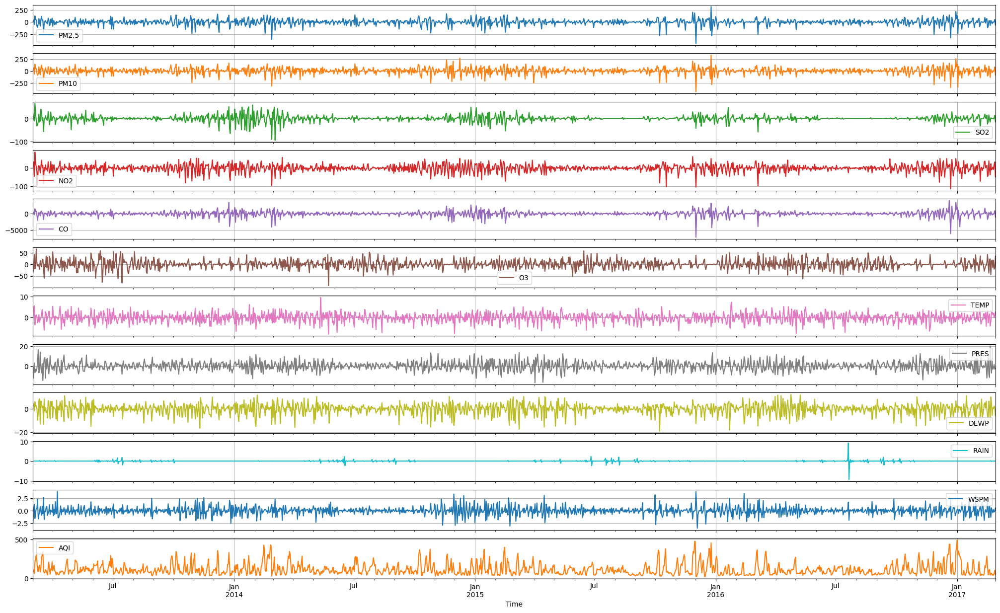

In [63]:
# visualisasi line graph setelah dilakukan transformasi
dongsi = station_data['Dongsi'].copy()
dongsi = dongsi.drop(['wd','AQI_category_max'],axis=1)
dongsi_diff = transform_vis(dongsi)

# Tanggal 1 Maret 2013 tidak diikut sertakan karena nilainya belum terdeferensiasi
dongsi_diff.loc['2013-03-02':,].plot(kind='line',subplots=True,layout=(12,1),figsize=(25,15),grid=True)

In [64]:
# hasil uji stasioner
data = dongsi_diff.loc['2013-03-02':,]
display_stationarity_results(data)

,statistic,p_value,critical_5%,Stationer
PM2.5,-13.355355,5.562784e-25,-2.863553,Stationary
PM10,-13.420092,4.206394e-25,-2.863553,Stationary
SO2,-12.574692,1.969148e-23,-2.863552,Stationary
NO2,-12.840633,5.616912e-24,-2.863552,Stationary
CO,-12.579442,1.924871e-23,-2.863553,Stationary
O3,-14.702529,2.931416e-27,-2.863545,Stationary
TEMP,-23.238386,0.000000e+00,-2.863528,Stationary
PRES,-16.972329,9.139384e-30,-2.863539,Stationary
DEWP,-16.197327,4.111435e-29,-2.863539,Stationary
RAIN,-13.438280,3.890545e-25,-2.863556,Stationary


## Visualization & Explanatory Analysis

### Pertanyaan 1: Berdasarkan kalkulasi AQI (Air Quality Index) distrik/stasiun mana yang paling terpolusi ?

In [65]:
# fungsi klasifikasi level berdasarkan nilai aqi
def level_aqi(x):
  if x >= 301.0:
    level = 'Level 6'
  elif x >= 201.0 and x < 301.0:
    level = 'Level 5'
  elif x >= 151.0 and x < 201.0:
    level = 'Level 4'
  elif x >= 101.0 and x < 151.0:
    level = 'Level 3'
  elif x >= 51.0 and x < 101.0:
    level = 'Level 2'
  else:
    level = 'Level 1'
  return level

In [66]:
# Mengklasifikasikan Kelas AQI untuk semua hari
station_data_days = {}
all_categories = ['PM2.5', 'PM10', 'SO2', 'NO2', 'CO', 'O3']

for station,df_station in station_data.items():
  df_station = df_station.copy()

  col_numeric = df_station.select_dtypes(include=[np.number]).columns.tolist()
  col_categorical = df_station.select_dtypes(exclude=[np.number]).columns.tolist()
  # merata-ratakan secara harian kolom yang bertipe data numerik
  df_station_1 = df_station.loc[:,col_numeric].resample('D').mean()
  # mencari kelas yang jumlahnya paling banyak dalam satu hari
  df_station_2 = df_station.loc[:,col_categorical].resample('D').agg(lambda x: x.value_counts().index[0] if not x.empty else None)
  # penggabungan kedua dataframe
  df_station = pd.concat([df_station_1,df_station_2],axis=1)
  df_station['AQI_category'] = df_station['AQI'].apply(level_aqi)

  # Mengubah tipe data object menjadi kategori
  df_station['AQI_category'] = df_station['AQI_category'].astype('category')
  df_station['AQI_category_max'] = df_station['AQI_category_max'].astype('category')

  # Menambahkan label baru yang tidak ada pada untuk kolom AQI_category_max
  category_null = []
  for category_aqi in all_categories:
    if category_aqi not in df_station['AQI_category_max'].unique().tolist():
      category_null.append(category_aqi)

  df_station['AQI_category_max'] = df_station['AQI_category_max'].cat.add_categories(category_null)

  # Menyetor ke dictionary baru
  station_data_days[station] = df_station

station_data_days['Dongsi']

,PM2.5,PM10,SO2,NO2,CO,O3,TEMP,PRES,DEWP,RAIN,WSPM,AQI,wd,AQI_category_max,AQI_category
Time,,,,,,,,,,,,,,,
2013-03-01,6.416667,9.875000,8.465278,27.916667,390.972222,72.888889,1.325000,1028.783333,-21.466667,0.0,3.308333,40.56,NNW,O3,Level 1
2013-03-02,30.500000,40.583333,28.291667,58.500000,966.583333,37.791667,0.491667,1028.850000,-16.962500,0.0,0.791667,73.12,N,NO2,Level 2
2013-03-03,73.291667,108.208333,27.270833,93.458333,1199.833333,20.333333,4.987500,1016.458333,-12.312500,0.0,1.225000,106.73,N,NO2,Level 3
2013-03-04,24.291667,40.875000,16.511800,47.671642,883.467487,62.291667,10.562500,1019.454167,-14.000000,0.0,2.504167,59.59,N,NO2,Level 2
2013-03-05,154.250000,183.166667,80.861111,137.263889,2399.090278,42.791667,7.212500,1012.704167,-7.783333,0.0,0.912500,204.25,E,PM2.5,Level 5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-02-24,15.750000,31.229167,7.041667,37.687500,625.000000,40.875000,5.166667,1021.012500,-11.141667,0.0,1.595833,47.11,WNW,NO2,Level 1
2017-02-25,10.083333,22.291667,5.083333,30.375000,454.166667,58.208333,7.245833,1018.812500,-10.754167,0.0,1.825000,37.97,NW,NO2,Level 1
2017-02-26,24.020833,41.208333,8.208333,50.166667,620.833333,37.541667,7.208333,1020.337500,-8.258333,0.0,1.566667,62.71,NE,NO2,Level 2


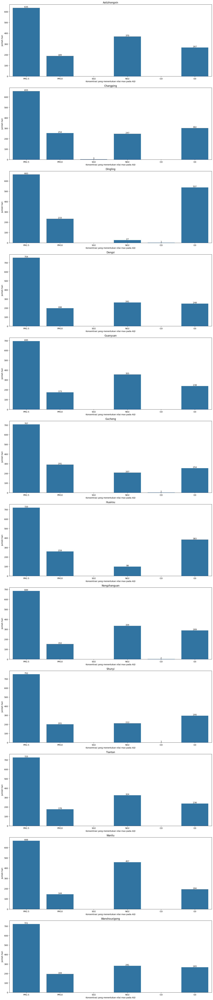

In [67]:
# Distribusi parameter konsentrasi yang mempengaruhi nilai AQI setiap hari
fig,ax = plt.subplots(len(station_data_days.keys()),1,figsize=(15,70))
order_label = ['PM2.5','PM10','SO2','NO2','CO','O3']

for i,station in enumerate(station_data_days.keys()):
  data_station = station_data_days[station]
  sns.countplot(data=data_station,x='AQI_category_max',order=order_label,ax=ax[i])
  ax[i].bar_label(ax[i].containers[0], fontsize=10)
  ax[i].set_title(f'{station}')
  ax[i].set_xlabel('Konsentrasi yang menentukan nilai max pada AQI')
  ax[i].set_ylabel('Jumlah hari')

plt.tight_layout()
plt.show()

perhitungan AQI sendiri didapat dengan mencari nilai paling besar dari IAQI setiap parameter konsentrasi. Jika dilihat dari barplot diatas PM2.5 menjadi yang paling banyak jumlah harinya yang memrepresentasikan nilai AQI di hari tersebut. Ini selaras dengan nilai korelasi yang tinggi antara AQI dan PM2.5.

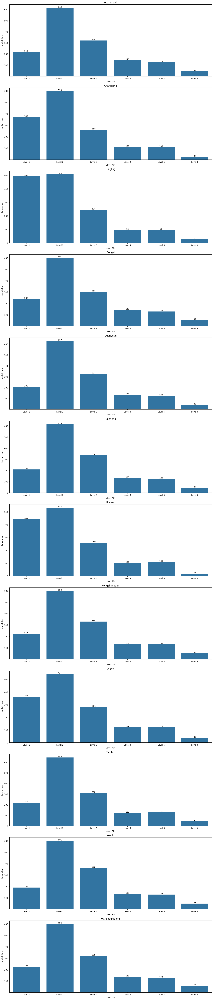

In [68]:
# Distribusi tiap level setiap harinya
fig,ax = plt.subplots(len(station_data_days.keys()),1,figsize=(15,70))
order_label = ['Level 1','Level 2','Level 3','Level 4','Level 5','Level 6']

for i,station in enumerate(station_data_days.keys()):
  sns.countplot(data=station_data_days[station],x='AQI_category',order=order_label,stat='count',ax=ax[i])
  ax[i].bar_label(ax[i].containers[0], fontsize=10)
  ax[i].set_title(f'{station}')
  ax[i].set_xlabel('Level AQI')
  ax[i].set_ylabel('Jumlah hari')

plt.tight_layout()
plt.show()

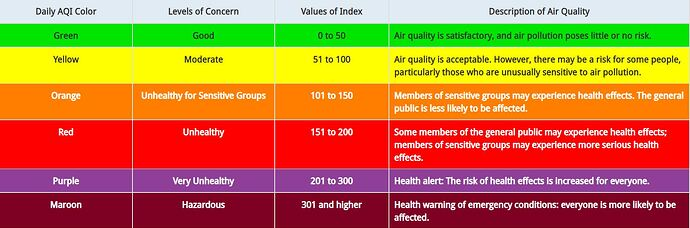

jika dilihat dari hasil barplot diatas menunjukan level AQI dengan jumlah hari terbanyak di setiap stasiun adalah Level 2. berdasarkan level konsentrasinya masuk kategori moderate dimana kualitas udara masih dapat diterima oleh tubuh untuk kebanyakan orang tapi berisiko untuk beberapa orang yang sensitive.

Nilai konsentrasi PM2.5 rata-rata pada statsiun Aotizhongxin adalah 127.43
Nilai konsentrasi PM2.5 rata-rata pada statsiun Changping adalah 108.83
Nilai konsentrasi PM2.5 rata-rata pada statsiun Dingling adalah 101.32
Nilai konsentrasi PM2.5 rata-rata pada statsiun Dongsi adalah 122.38
Nilai konsentrasi PM2.5 rata-rata pada statsiun Guanyuan adalah 122.32
Nilai konsentrasi PM2.5 rata-rata pada statsiun Gucheng adalah 121.48
Nilai konsentrasi PM2.5 rata-rata pada statsiun Huairou adalah 99.41
Nilai konsentrasi PM2.5 rata-rata pada statsiun Nongzhanguan adalah 126.21
Nilai konsentrasi PM2.5 rata-rata pada statsiun Shunyi adalah 110.54
Nilai konsentrasi PM2.5 rata-rata pada statsiun Tiantan adalah 119.42
Nilai konsentrasi PM2.5 rata-rata pada statsiun Wanliu adalah 126.98
Nilai konsentrasi PM2.5 rata-rata pada statsiun Wanshouxigong adalah 123.08


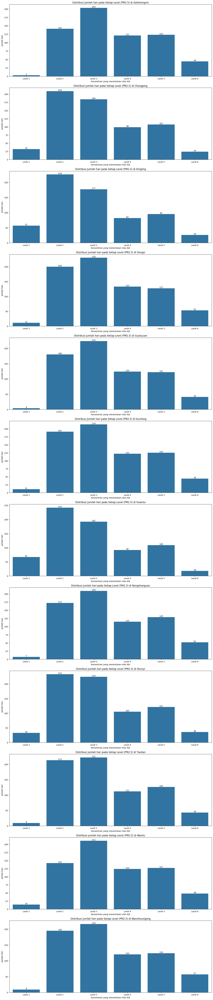

In [69]:
# Distribusi tiap level untuk max IAQI nya adalah PM2.5
fig,ax = plt.subplots(len(station_data_days.keys()),1,figsize=(15,70))
order_label = ['Level 1','Level 2','Level 3','Level 4','Level 5','Level 6']

for i,station in enumerate(station_data_days.keys()):
  data = station_data_days[station].copy()
  # data_pm25 merupakan dataframe yang hanya berisi data dari pengelompokam PM2.5 pada kolom AQI_category_max
  data_pm25 = data[data['AQI_category_max'] == 'PM2.5']
  mean_pm25 = data_pm25['PM2.5'].mean()
  print(f'Nilai konsentrasi PM2.5 rata-rata pada statsiun {station} adalah {round(mean_pm25,2)}')

  # visualisasi distribusinya
  sns.countplot(data=data_pm25,x='AQI_category',order=order_label,ax=ax[i])
  ax[i].bar_label(ax[i].containers[0], fontsize=10)
  ax[i].set_title(f'Distribusi Jumlah hari pada Setiap Level (PM2.5) di {station}')
  ax[i].set_xlabel('Konsentrasi yang menentukan nilai AQI')
  ax[i].set_ylabel('Jumlah hari')

plt.tight_layout()
plt.show()

selanjutnya kita akan membuat skoring untuk setiap stasiun dengan metode Average Category Index (ACI) dimana metode menjelaskan rata-rata level/indeks untuk parameter PM2.5. Mengapa PM2.5 karena berdasarkan hasil korelasi dan distribusi parameter konsentrasi yang mempengaruhi nilai AQI, PM2.5 merupakan parameter yang paling dominan, sehingga kita hanya perlu menentukan skor ACI dari parameter tersebut.

In [77]:
ACI_skor = []
ACI_station = []
for i,station in enumerate(station_data_days.keys()):
  pm25_skor = pd.DataFrame()
  data = station_data_days[station]
  data_pm25 = data[data['AQI_category_max'] == 'PM2.5']

  # membuat dataframe perhitungan
  pm25_skor['pm25_nDays'] = data_pm25.groupby('AQI_category')['PM2.5'].count()
  pm25_skor['all_nDays'] = data.groupby('AQI_category')['PM2.5'].count()
  pm25_skor['bobot'] = np.linspace(1,6,6)
  pm25_skor['norm_bobot'] = pm25_skor['bobot']/pm25_skor['bobot'].sum()

  # Average Category Index (ACI)
  aci = pm25_skor['bobot'] * pm25_skor['pm25_nDays']
  ACI = (aci.sum()) / pm25_skor['pm25_nDays'].sum()
  ACI_skor.append(ACI)
  ACI_station.append(station)

<ipython-input-77-1e0051d2fa28>:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  pm25_skor['pm25_nDays'] = data_pm25.groupby('AQI_category')['PM2.5'].count()
<ipython-input-77-1e0051d2fa28>:10: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  pm25_skor['all_nDays'] = data.groupby('AQI_category')['PM2.5'].count()
<ipython-input-77-1e0051d2fa28>:9: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  pm25_skor['pm25_nDays'] = data_p

In [79]:
# Skor ACI dan Rankingnya
aci_skor = pd.Series(ACI_skor,index=ACI_station,name='skor')
df_aci_skor = pd.DataFrame({'ACI':aci_skor,
                           'Rank':aci_skor.rank(ascending=False)})
display(df_aci_skor.sort_values('ACI',ascending=False))
print(f'Rata-Rata nilai ACI seluruh stasiun =',{df_aci_skor['ACI'].mean()})

,ACI,Rank
Aotizhongxin,3.554331,1.0
Wanliu,3.528529,2.0
Nongzhanguan,3.501462,3.0
Wanshouxigong,3.452150,4.0
Guanyuan,3.435971,5.0
Dongsi,3.429708,6.0
Gucheng,3.411598,7.0
Tiantan,3.361379,8.0
Shunyi,3.207447,9.0
Changping,3.170992,10.0


Rata-Rata nilai ACI seluruh stasiun = {np.float64(3.3376652950692303)}


**Insight:**
*   Hasilnya stasiun paling terpolusi adalah stasiun Aotizhongxin, sementara paling bersih adalah stasiun Huairou
*   Jika dilihat secara skor ACI, rata-rata nilai ACI semua stasiun adalah 3.37, yang menandakan level polusi untuk parameter PM2.5 setiap stasiun di kisaran level 3-4 (lebih dominan ke level 3)





### Pertanyaan 2: Bagaimana analisis hubungan antara parameter kualitas udara (dalam hal ini parameter kualitas udara itu adalah PM 2.5, PM 10, NO2, SO2, CO, dan O3) dengan semua parameter cuaca di stasiun dongsi menggunakan korelasi pearson ?

In [114]:
#fungsi decompose feature
def decompose(series,period=7):
  data = series
  df_decomp = pd.DataFrame()
  decomp = seasonal_decompose(data, model='additive', period=period)  # disarankan periode sesuai dengan yang terlihat di graph line
  df_decomp['original'] = data
  df_decomp['trend'] = decomp.trend
  df_decomp['seasonal'] = decomp.seasonal
  df_decomp['residual'] = decomp.resid

  return df_decomp

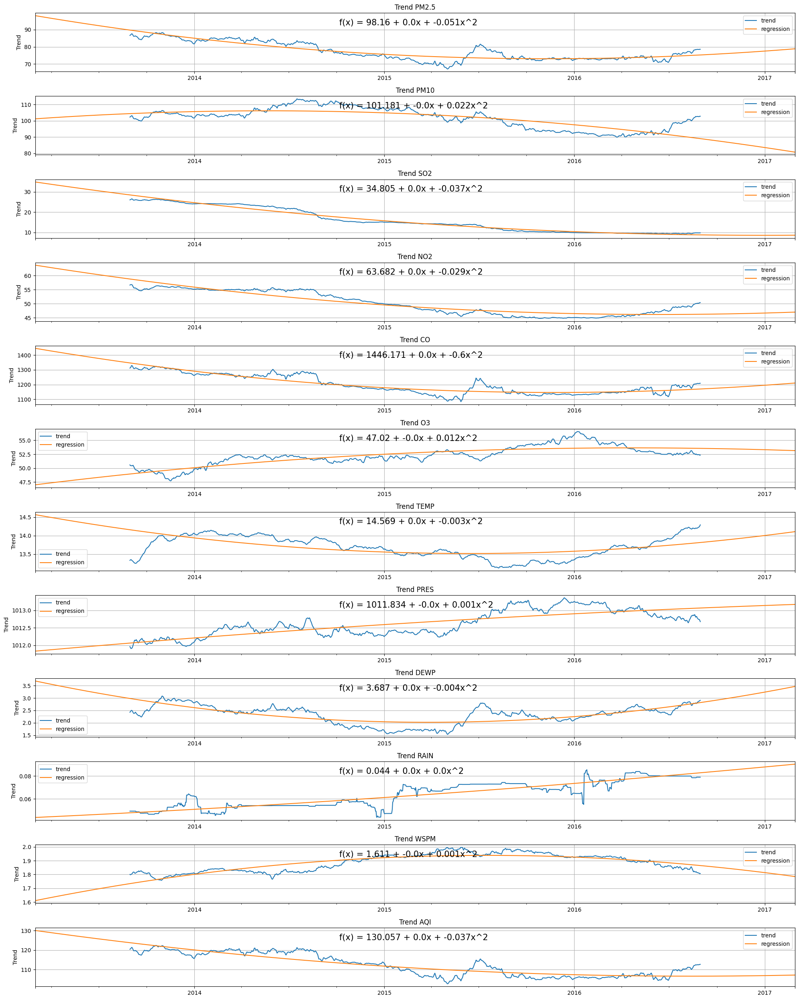

In [179]:
# memisahkan data menjadi trend, musiman dan residu
data = station_data['Dongsi'].copy()
data.drop(['wd','AQI_category_max'],axis=1,inplace=True)
df = data.resample('D').mean()

# Melihat perbandingan trend tiap feature
fig, ax = plt.subplots(len(df.columns),1,figsize=(20, 25))
for i,feature in enumerate(df.columns):
  df_decomp = decompose(df[feature],period=365)               # period=365 didapat karena periode musiman pada data adalah 365.25 hari da ini haru int
  df_decomp['index_time'] = np.arange(len(df_decomp.index))

  # membuat fitting linear
  y_nonan = df_decomp['trend'].dropna()
  y = y_nonan.values
  x = df_decomp.loc[y_nonan.index,'index_time'].values

  coefficients = np.polyfit(x, y, 2) #adjust polyfit order as needed.
  polynomial = np.poly1d(coefficients)
  df_decomp['regression'] = polynomial(df_decomp['index_time'])

  a = ['f(x) = ' + str(round(coefficients[-1],3))]
  for n in range(len(coefficients[:-1])):
    if n == 0:
      b_n = ' + ' + str(round(coefficients[n],3)) + 'x'
    else:
      b_n = ' + ' + str(round(coefficients[n],3)) + 'x^' + str(n+1)
    a.extend(b_n)

  fx = "".join(a)

  df_decomp[['trend','regression']].plot(grid=True,ax=ax[i],legend=True)   # yang di plot hanya trend saja
  #sns.regplot(x="index_time", y="trend", data=df_decomp, order=1, truncate=False, ax=ax[i])
  ax[i].text(0.4, 0.9, fx, fontsize=15, transform=ax[i].transAxes, va='top')
  ax[i].set_title(f'Trend {feature}')
  ax[i].set_ylabel('Trend')
  ax[i].set_xlabel('')
  plt.tight_layout()

In [176]:
df_decomp.describe().T

,count,mean,std,min,25%,50%,75%,max
original,1461.0,113.499350,75.917111,20.360000,60.230000,89.690000,142.710000,491.440000
trend,1097.0,112.239161,5.808149,102.678658,106.356740,111.257315,118.566575,122.349178
seasonal,1461.0,-0.028998,41.868553,-75.379930,-30.559784,-6.516313,24.588445,174.810591
residual,1097.0,-0.913239,61.906167,-244.261659,-36.383723,-7.572198,28.761738,263.747619
index_time,1461.0,730.000000,421.898685,0.000000,365.000000,730.000000,1095.000000,1460.000000
regression,1461.0,112.239161,6.614161,100.794855,106.517008,112.239161,117.961314,123.683467


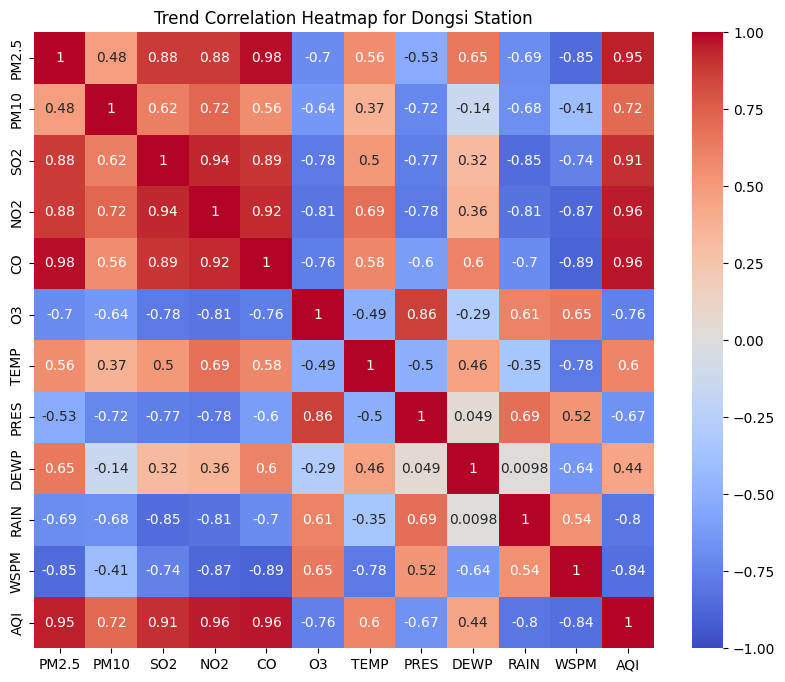

In [177]:
# Menampilkan heatmap korelasi trend antar feature
data = station_data['Dongsi'].copy()
data.drop(['wd','AQI_category_max'],axis=1,inplace=True)
DongsiStation = data.resample('D').mean()

# membuat dataframe decompisition
trend_dongsi = pd.DataFrame()
for i,feature in enumerate(DongsiStation.columns):
  df_decomp = decompose(DongsiStation[feature],period=365)
  trend_dongsi[feature] = df_decomp['trend']

# melakukan korelasi
trend_corr = trend_dongsi.corr(method='pearson')

# Heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(trend_corr, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Trend Correlation Heatmap for Dongsi Station')
plt.show()

jika kita menggunakan data yang sudah ditransformasi maka dilihat dari hasil korelasi menunjukan bahwa feature PM2.5, PM10, NO2 dan CO memiliki hubungan searah yang cukup kuat dengan feature DEWP sebaliknya feature WSPM memiliki hubungan terbalik cukup kuat dengan featureb DEWP. Tapi jika dilihat secara umum feature yang masuk kategori kualitas udara tidak memiliki hubungan dengan feature kategori cuaca. Ini menandakan parameter kualitas udara dipengaruhi oleh faktor lain selain faktor cuaca.

Selanjutnya jika kita analisis hubungan antar parameter dengan membandingkan grafik time series setiap parameter

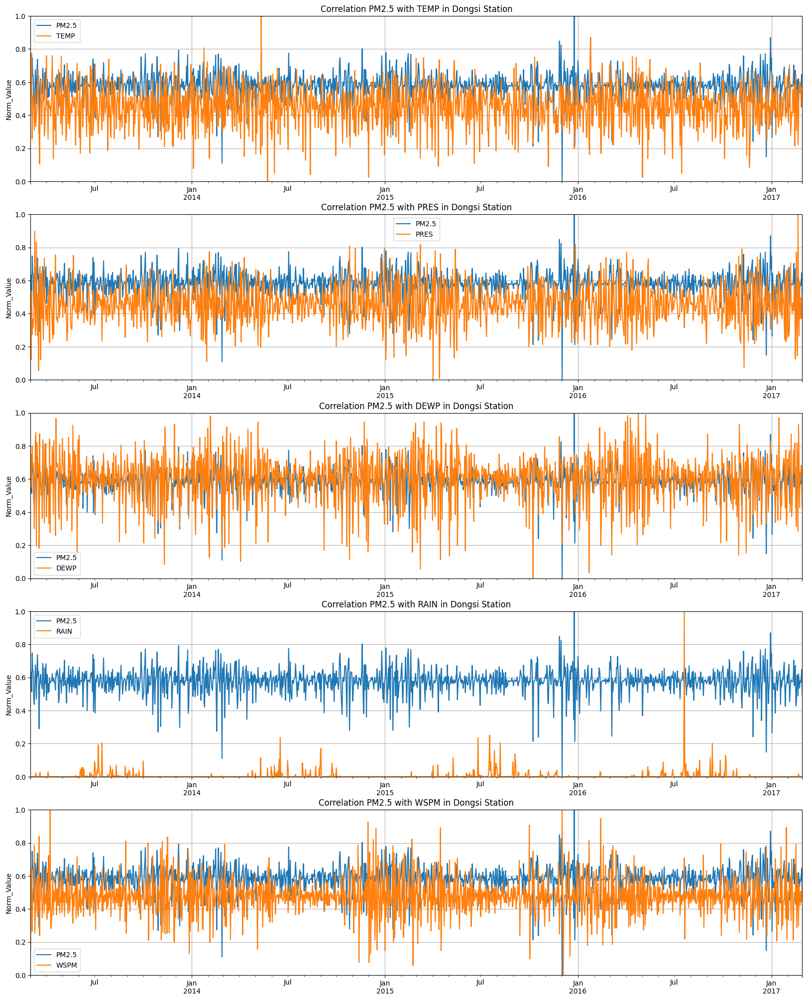

In [139]:
col_target = ['TEMP','PRES','DEWP','RAIN','WSPM']
col_subject = ['PM2.5','PM10','SO2','NO2','CO','O3']

# PM2.5
subject = col_subject[0]
col = col_target.copy()
col.append(subject)
sub = DongsiStation[col].copy()
norm_sub=(sub-sub.min())/(sub.max()-sub.min())

fig, ax = plt.subplots(len(col_target),1,figsize=(20, 25))
for j, target in enumerate(col_target):
  norm_sub[[subject,target]].plot(kind='line',grid=True,ylim=(0,1),ax=ax[j])
  ax[j].set_title(f'Correlation {subject} with {target} in Dongsi Station')
  ax[j].set_ylabel('Norm_Value')
  ax[j].set_xlabel('')


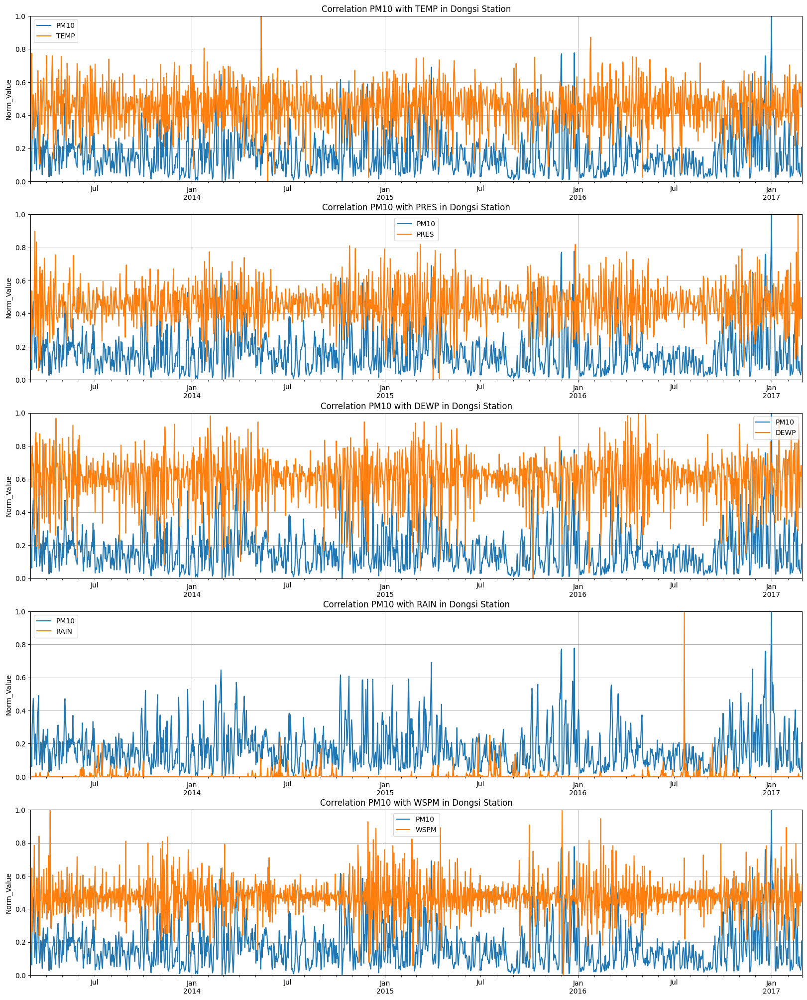

In [114]:
# PM10
subject = col_subject[1]
col = col_target.copy()
col.append(subject)
sub = DongsiStation[col].copy()
norm_sub=(sub-sub.min())/(sub.max()-sub.min())

fig, ax = plt.subplots(len(col_target),1,figsize=(20, 25))
for j, target in enumerate(col_target):
  norm_sub[[subject,target]].plot(kind='line',grid=True,ylim=(0,1),ax=ax[j])
  ax[j].set_title(f'Correlation {subject} with {target} in Dongsi Station')
  ax[j].set_ylabel('Norm_Value')
  ax[j].set_xlabel('')

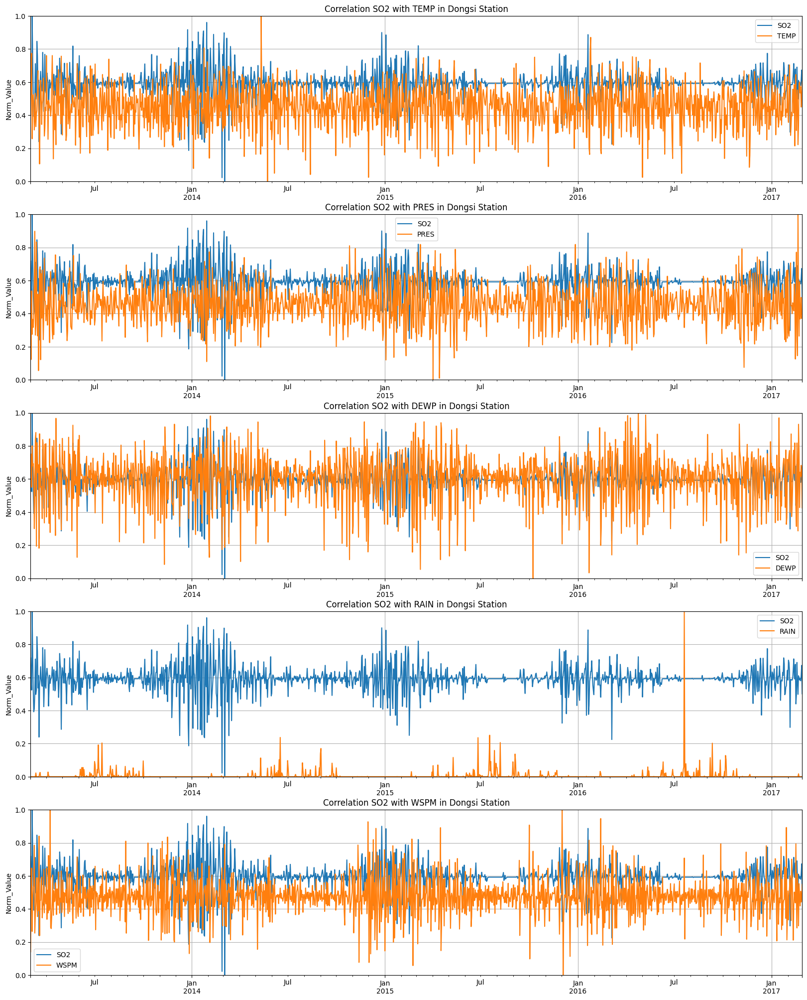

In [115]:
# SO2
subject = col_subject[2]
col = col_target.copy()
col.append(subject)
sub = DongsiStation[col].copy()
norm_sub=(sub-sub.min())/(sub.max()-sub.min())

fig, ax = plt.subplots(len(col_target),1,figsize=(20, 25))
for j, target in enumerate(col_target):
  norm_sub[[subject,target]].plot(kind='line',grid=True,ylim=(0,1),ax=ax[j])
  ax[j].set_title(f'Correlation {subject} with {target} in Dongsi Station')
  ax[j].set_ylabel('Norm_Value')
  ax[j].set_xlabel('')

## Conclusion

- Secara umum parameter cuaca tidak terlalu mempengaruhi paremeter konsentrasi kualitas udara jika dilihat dari hasil korelasi. Kemungkinan ada faktor lain yang mempengaruhi paremeter kualitas udara atau bisa jadi ada hubungannya juga dengan faktor cuaca tapi secara tidak langsung mempengaruhinya
- PM2.5 adalah parameter dominan yang paling mempengaruhi indeks kualitas udara (AQI) dibuktikan dengan hasil korelasi yang sangat kuat antar keduanya dan distribusi parameter konsentrasi yang mempengaruhi nilai AQI yang jumlah harinya paling banyak. Dengan hasil tersebut untuk perhitungan skor stasiun paling terpolusi bisa diwakilkan dari parameter PM2.5
- Stasiun Aotizhongxin menjadi stasiun yang paling polusi, sementara stasiun Huairou menjadi stasiun yang paling bersih.

In [73]:
# export data untuk kebutuhan dashboard
export_station_data(station_data_days, export_format='excel')